In [1]:
import networkx as nx
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point
import matplotlib
%matplotlib inline

# Data Processing

In [2]:
pop_econ = pd.read_csv("./Data/city_agglomerations/京津冀/pop_econ_BTJ.csv", encoding='utf-8')
pop_econ = pop_econ[["县","县代码","GDP","人口"]]
pop_econ = pop_econ.rename(columns={'县':'name','县代码':'code','人口':'pop'})
pop_econ

,name,code,GDP,pop
0,昌平区,110114,1287.000,2269487
1,朝阳区,110105,7617.800,3452460
2,大兴区,110115,1461.841,1993591
3,东城区,110101,3193.100,708829
4,房山区,110111,818.400,1312778
...,...,...,...,...
203,静海区,120118,583.380,787106
204,南开区,120104,669.440,917106
205,宁河区,120117,501.720,395333
206,武清区,120114,941.880,1153235


In [3]:
BTJ_network = pd.read_csv("./Data/city_agglomerations/京津冀/BTJ_network.csv")
BTJ_network

,Unnamed: 0,Origin,OrigCode,OrigCoords,Dest,DestCode,DestCoords,Distance
0,0,昌平区,110114,"(116.20452887099272, 40.21404655628209)",顺义区,110113,"(116.71793150801305, 40.14936758295264)",50.177
1,1,昌平区,110114,"(116.20452887099272, 40.21404655628209)",怀柔区,110116,"(116.5798424569992, 40.6281748721021)",120.788
2,2,昌平区,110114,"(116.20452887099272, 40.21404655628209)",延庆区,110119,"(116.15767194111913, 40.53836465293719)",66.278
3,3,昌平区,110114,"(116.20452887099272, 40.21404655628209)",门头沟区,110109,"(115.78536354787835, 39.992851371868994)",76.683
4,4,昌平区,110114,"(116.20452887099272, 40.21404655628209)",海淀区,110108,"(116.22700248721311, 40.025664250485896)",28.165
...,...,...,...,...,...,...,...,...
959,959,西青区,120111,"(117.11241488311009, 39.02741697686246)",静海区,120118,"(116.9603018394033, 38.85473052134871)",36.030
960,960,西青区,120111,"(117.11241488311009, 39.02741697686246)",红桥区,120106,"(117.14799567808768, 39.165369917835754)",22.273
961,961,西青区,120111,"(117.11241488311009, 39.02741697686246)",北辰区,120113,"(117.16710667870132, 39.25226327800247)",32.130
962,962,西青区,120111,"(117.11241488311009, 39.02741697686246)",武清区,120114,"(117.02205842508047, 39.44980461653322)",53.492


### Add socio-economic data

In [4]:
BTJ_network_socio1 = BTJ_network.merge(pop_econ,left_on='OrigCode',right_on='code')
BTJ_network_socio1 = BTJ_network_socio1.rename(columns = {'GDP':'OrigGDP','pop':'OrigPop'})
BTJ_network_socio1 = BTJ_network_socio1.drop(columns=['name','code'])
BTJ_network_socio1

,Unnamed: 0,Origin,OrigCode,OrigCoords,Dest,DestCode,DestCoords,Distance,OrigGDP,OrigPop
0,0,昌平区,110114,"(116.20452887099272, 40.21404655628209)",顺义区,110113,"(116.71793150801305, 40.14936758295264)",50.177,1287.00,2269487
1,1,昌平区,110114,"(116.20452887099272, 40.21404655628209)",怀柔区,110116,"(116.5798424569992, 40.6281748721021)",120.788,1287.00,2269487
2,2,昌平区,110114,"(116.20452887099272, 40.21404655628209)",延庆区,110119,"(116.15767194111913, 40.53836465293719)",66.278,1287.00,2269487
3,3,昌平区,110114,"(116.20452887099272, 40.21404655628209)",门头沟区,110109,"(115.78536354787835, 39.992851371868994)",76.683,1287.00,2269487
4,4,昌平区,110114,"(116.20452887099272, 40.21404655628209)",海淀区,110108,"(116.22700248721311, 40.025664250485896)",28.165,1287.00,2269487
...,...,...,...,...,...,...,...,...,...,...
959,959,西青区,120111,"(117.11241488311009, 39.02741697686246)",静海区,120118,"(116.9603018394033, 38.85473052134871)",36.030,932.41,1180770
960,960,西青区,120111,"(117.11241488311009, 39.02741697686246)",红桥区,120106,"(117.14799567808768, 39.165369917835754)",22.273,932.41,1180770
961,961,西青区,120111,"(117.11241488311009, 39.02741697686246)",北辰区,120113,"(117.16710667870132, 39.25226327800247)",32.130,932.41,1180770
962,962,西青区,120111,"(117.11241488311009, 39.02741697686246)",武清区,120114,"(117.02205842508047, 39.44980461653322)",53.492,932.41,1180770


In [5]:
BTJ = BTJ_network_socio1.merge(pop_econ,left_on='DestCode',right_on='code')
BTJ = BTJ.rename(columns = {'GDP':'DestGDP','pop':'DestPop'})
BTJ = BTJ.drop(columns=['name','code'])
BTJ

,Unnamed: 0,Origin,OrigCode,OrigCoords,Dest,DestCode,DestCoords,Distance,OrigGDP,OrigPop,DestGDP,DestPop
0,0,昌平区,110114,"(116.20452887099272, 40.21404655628209)",顺义区,110113,"(116.71793150801305, 40.14936758295264)",50.177,1287.000,2269487,2076.80,1324044
1,10,朝阳区,110105,"(116.50935364028471, 39.95234024823175)",顺义区,110113,"(116.71793150801305, 40.14936758295264)",46.060,7617.800,3452460,2076.80,1324044
2,43,怀柔区,110116,"(116.5798424569992, 40.6281748721021)",顺义区,110113,"(116.71793150801305, 40.14936758295264)",90.867,432.613,441040,2076.80,1324044
3,61,密云区,110118,"(116.98866765206706, 40.52519065135838)",顺义区,110113,"(116.71793150801305, 40.14936758295264)",107.131,360.313,527683,2076.80,1324044
4,64,平谷区,110117,"(117.13902335658467, 40.20755194725247)",顺义区,110113,"(116.71793150801305, 40.14936758295264)",45.676,359.275,457313,2076.80,1324044
...,...,...,...,...,...,...,...,...,...,...,...,...
959,917,红桥区,120106,"(117.14799567808768, 39.165369917835754)",南开区,120104,"(117.14867236468932, 39.108252038866475)",8.394,174.890,483130,669.44,917106
960,958,西青区,120111,"(117.11241488311009, 39.02741697686246)",南开区,120104,"(117.14867236468932, 39.108252038866475)",12.366,932.410,1180770,669.44,917106
961,909,河东区,120102,"(117.25037410474567, 39.12140465651658)",和平区,120101,"(117.18989279453594, 39.11795589196411)",7.212,347.900,858787,791.25,355000
962,914,河西区,120103,"(117.22625311824191, 39.07153302811498)",和平区,120101,"(117.18989279453594, 39.11795589196411)",7.424,702.820,822174,791.25,355000


# Correction:delete henan

In [6]:
BTJ = BTJ[~BTJ['OrigCode'].astype(str).str.startswith('4')]
BTJ = BTJ[~BTJ['DestCode'].astype(str).str.startswith('4')]


In [7]:
BTJ

,Unnamed: 0,Origin,OrigCode,OrigCoords,Dest,DestCode,DestCoords,Distance,OrigGDP,OrigPop,DestGDP,DestPop
0,0,昌平区,110114,"(116.20452887099272, 40.21404655628209)",顺义区,110113,"(116.71793150801305, 40.14936758295264)",50.177,1287.000,2269487,2076.80,1324044
1,10,朝阳区,110105,"(116.50935364028471, 39.95234024823175)",顺义区,110113,"(116.71793150801305, 40.14936758295264)",46.060,7617.800,3452460,2076.80,1324044
2,43,怀柔区,110116,"(116.5798424569992, 40.6281748721021)",顺义区,110113,"(116.71793150801305, 40.14936758295264)",90.867,432.613,441040,2076.80,1324044
3,61,密云区,110118,"(116.98866765206706, 40.52519065135838)",顺义区,110113,"(116.71793150801305, 40.14936758295264)",107.131,360.313,527683,2076.80,1324044
4,64,平谷区,110117,"(117.13902335658467, 40.20755194725247)",顺义区,110113,"(116.71793150801305, 40.14936758295264)",45.676,359.275,457313,2076.80,1324044
...,...,...,...,...,...,...,...,...,...,...,...,...
959,917,红桥区,120106,"(117.14799567808768, 39.165369917835754)",南开区,120104,"(117.14867236468932, 39.108252038866475)",8.394,174.890,483130,669.44,917106
960,958,西青区,120111,"(117.11241488311009, 39.02741697686246)",南开区,120104,"(117.14867236468932, 39.108252038866475)",12.366,932.410,1180770,669.44,917106
961,909,河东区,120102,"(117.25037410474567, 39.12140465651658)",和平区,120101,"(117.18989279453594, 39.11795589196411)",7.212,347.900,858787,791.25,355000
962,914,河西区,120103,"(117.22625311824191, 39.07153302811498)",和平区,120101,"(117.18989279453594, 39.11795589196411)",7.424,702.820,822174,791.25,355000


Calculate Flow Data

In [8]:
# Define the cost function for P(x_od)
def P(x):
    if x <= 5.5:
        return 0.039423 * x**0.284949
    else:
        return 0.084211 * np.exp(-0.047756 * x)

# Compute P(x_od) for every row
BTJ['P(x_od)'] = BTJ['Distance'].apply(P)

# Compute the denominator of f_od for each origin
BTJ['Sum_NkP(x_ok)'] = BTJ.groupby('OrigCode')['DestPop'].transform(lambda x: (x * BTJ['P(x_od)']).sum())

# Compute f_od
BTJ['f_od'] = (BTJ['DestPop'] * BTJ['P(x_od)']) / BTJ['Sum_NkP(x_ok)']

# Compute F_od
BTJ['flow'] = BTJ['OrigPop'] * BTJ['f_od']

In [9]:
BTJ

,Unnamed: 0,Origin,OrigCode,OrigCoords,Dest,DestCode,DestCoords,Distance,OrigGDP,OrigPop,DestGDP,DestPop,P(x_od),Sum_NkP(x_ok),f_od,flow
0,0,昌平区,110114,"(116.20452887099272, 40.21404655628209)",顺义区,110113,"(116.71793150801305, 40.14936758295264)",50.177,1287.000,2269487,2076.80,1324044,0.007668,113990.279860,0.089068,202139.761145
1,10,朝阳区,110105,"(116.50935364028471, 39.95234024823175)",顺义区,110113,"(116.71793150801305, 40.14936758295264)",46.060,7617.800,3452460,2076.80,1324044,0.009334,221502.755840,0.055796,192632.099958
2,43,怀柔区,110116,"(116.5798424569992, 40.6281748721021)",顺义区,110113,"(116.71793150801305, 40.14936758295264)",90.867,432.613,441040,2076.80,1324044,0.001098,3820.797973,0.380645,167879.770552
3,61,密云区,110118,"(116.98866765206706, 40.52519065135838)",顺义区,110113,"(116.71793150801305, 40.14936758295264)",107.131,360.313,527683,2076.80,1324044,0.000505,2662.037957,0.251271,132591.364799
4,64,平谷区,110117,"(117.13902335658467, 40.20755194725247)",顺义区,110113,"(116.71793150801305, 40.14936758295264)",45.676,359.275,457313,2076.80,1324044,0.009507,33260.128429,0.378460,173074.460687
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
959,917,红桥区,120106,"(117.14799567808768, 39.165369917835754)",南开区,120104,"(117.14867236468932, 39.108252038866475)",8.394,174.890,483130,669.44,917106,0.056400,165773.561384,0.312018,150745.422523
960,958,西青区,120111,"(117.11241488311009, 39.02741697686246)",南开区,120104,"(117.14867236468932, 39.108252038866475)",12.366,932.410,1180770,669.44,917106,0.046655,149226.225203,0.286728,338559.970306
961,909,河东区,120102,"(117.25037410474567, 39.12140465651658)",和平区,120101,"(117.18989279453594, 39.11795589196411)",7.212,347.900,858787,791.25,355000,0.059675,128250.811997,0.165181,141854.928576
962,914,河西区,120103,"(117.22625311824191, 39.07153302811498)",和平区,120101,"(117.18989279453594, 39.11795589196411)",7.424,702.820,822174,791.25,355000,0.059074,187361.825502,0.111929,92024.783711


In [10]:
BTJ['Origin'] = BTJ['Origin'] + '_' + BTJ['OrigCode'].astype(str)
BTJ['Dest'] = BTJ['Dest'] + '_' + BTJ['DestCode'].astype(str)

In [11]:
graph = nx.Graph()

# Step 3: Iterate over the data and add edges to the graph
for _, row in BTJ.iterrows():
    origin = row['Origin']
    origin_code = row['OrigCode']
    dest = row['Dest']
    dest_code = row['DestCode']
    origin_coordinates = row['OrigCoords']
    distance = row['Distance']
    flow = row['flow']

    # Add an edge between origin and destination if it doesn't already exist
    #if not graph.has_edge(origin, dest):
    graph.add_edge(origin, dest, origin_code=origin_code, dest_code=dest_code,distance = distance,flow = flow)
    
    graph.nodes[origin]['coordinates'] = origin_coordinates
        



In [12]:
list(graph.nodes(data = True))[0:30]

[('昌平区_110114', {'coordinates': '(116.20452887099272, 40.21404655628209)'}),
 ('顺义区_110113', {'coordinates': '(116.71793150801305, 40.14936758295264)'}),
 ('朝阳区_110105', {'coordinates': '(116.50935364028471, 39.95234024823175)'}),
 ('怀柔区_110116', {'coordinates': '(116.5798424569992, 40.6281748721021)'}),
 ('密云区_110118', {'coordinates': '(116.98866765206706, 40.52519065135838)'}),
 ('平谷区_110117', {'coordinates': '(117.13902335658467, 40.20755194725247)'}),
 ('通州区_110112', {'coordinates': '(116.72712464934045, 39.802102218221876)'}),
 ('三河市_131082', {'coordinates': '(117.00752560301004, 39.959160432094336)'}),
 ('延庆区_110119', {'coordinates': '(116.15767194111913, 40.53836465293719)'}),
 ('丰宁满族自治县_130826', {'coordinates': '(116.6113921340347, 41.41531965143211)'}),
 ('滦平县_130824', {'coordinates': '(117.32620236790599, 40.918102612942974)'}),
 ('赤城县_130732', {'coordinates': '(115.87991940506448, 40.948870484462105)'}),
 ('怀来县_130730', {'coordinates': '(115.62265643216769, 40.34119441805657

In [13]:
list(graph.edges(data = True))[0:10]

[('昌平区_110114',
  '顺义区_110113',
  {'origin_code': 110113,
   'dest_code': 110114,
   'distance': 53.906,
   'flow': 271832.2672443601}),
 ('昌平区_110114',
  '怀柔区_110116',
  {'origin_code': 110116,
   'dest_code': 110114,
   'distance': 120.301,
   'flow': 70559.83638551398}),
 ('昌平区_110114',
  '延庆区_110119',
  {'origin_code': 110119,
   'dest_code': 110114,
   'distance': 64.998,
   'flow': 265630.97791128367}),
 ('昌平区_110114',
  '门头沟区_110109',
  {'origin_code': 110109,
   'dest_code': 110114,
   'distance': 70.094,
   'flow': 116732.53283775548}),
 ('昌平区_110114',
  '海淀区_110108',
  {'origin_code': 110108,
   'dest_code': 110114,
   'distance': 27.739,
   'flow': 991113.6820319922}),
 ('昌平区_110114',
  '朝阳区_110105',
  {'origin_code': 110105,
   'dest_code': 110114,
   'distance': 43.665,
   'flow': 370191.66946741036}),
 ('顺义区_110113',
  '朝阳区_110105',
  {'origin_code': 110113,
   'dest_code': 110105,
   'distance': 44.563,
   'flow': 646066.6844773435}),
 ('顺义区_110113',
  '怀柔区_110116',
  {'

In [14]:
#since coords tuples are stored as string, need to convert them back to tuples using eval()
for node in graph.nodes():
    graph.nodes[node]['coordinates'] = eval(graph.nodes[node]['coordinates'])

In [15]:
for node_name in graph.nodes():
    city_name = node_name.split('_')[0]  # Extract the city name without code
    graph.nodes[node_name]['city_name'] = city_name

In [16]:
import json

def edges_to_geojson(graph):
    features = []
    
    # Convert edges to GeoJSON features
    for u, v, data in graph.edges(data=True):
        u_coords = tuple(map(float, graph.nodes[u]['coordinates'][1:-1].split(', '))) if isinstance(graph.nodes[u]['coordinates'], str) else graph.nodes[u]['coordinates']
        v_coords = tuple(map(float, graph.nodes[v]['coordinates'][1:-1].split(', '))) if isinstance(graph.nodes[v]['coordinates'], str) else graph.nodes[v]['coordinates']
        
        # Add flow and distance to properties for edges
        feature = {
            "type": "Feature",
            "geometry": {
                "type": "LineString",
                "coordinates": [u_coords, v_coords]
            },
            "properties": {
                "origin_lat": u_coords[1],
                "origin_long": u_coords[0],
                "dest_lat": v_coords[1],
                "dest_long": v_coords[0],
                "flow": data.get("flow", None),
                "distance": data.get("distance", None),
                "origin": u,
                "destination": v
            }
        }
        features.append(feature)
    
    geojson = {
        "type": "FeatureCollection",
        "features": features
    }
    return geojson

geojson_data = edges_to_geojson(graph)

# Save to a GeoJSON file
with open("edges_output.geojson", "w") as outfile:
    json.dump(geojson_data, outfile)


Plott

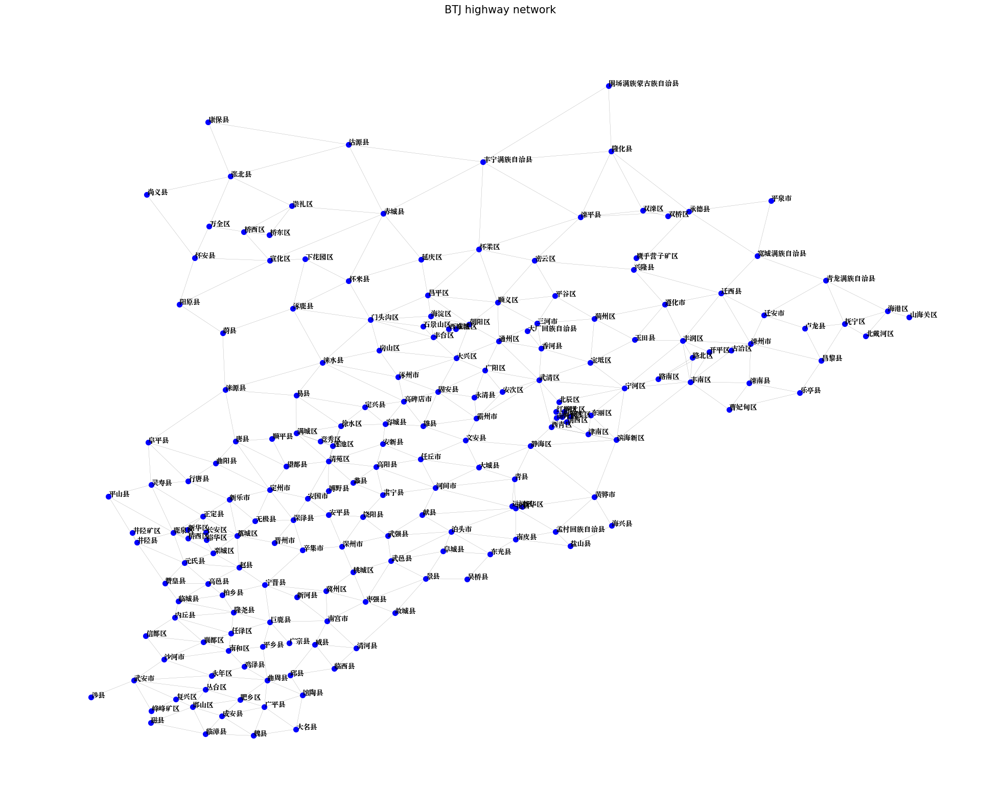

In [15]:
import matplotlib.font_manager as fm

# Specify a font that supports Chinese characters
font_path = '/System/Library/Fonts/Supplemental/Songti.ttc'
chinese_font = fm.FontProperties(fname=font_path)

# Plot the graph with the specified font
fig, ax = plt.subplots(figsize=(25, 20))

node_labels = nx.get_node_attributes(graph, 'city_name')
pos = nx.get_node_attributes(graph, 'coordinates')

nx.draw_networkx_nodes(graph, pos, node_size=50, node_color='b')
nx.draw_networkx_edges(graph, pos, arrows=False, width=0.2, edge_color='grey')
for node, label in node_labels.items():
    x, y = pos[node]
    plt.text(x, y, label, fontproperties=chinese_font, fontsize=10, color='black')

plt.title("BTJ highway network", fontsize=15)
plt.axis("off")
plt.show()


# Topological Network

### Properties

In [18]:
graph.number_of_nodes()

199

In [19]:
graph.number_of_edges()

467

In [20]:
edge_between = nx.edge_betweenness_centrality(graph)
avg_edge_between = sum(edge_between.values()) / graph.number_of_edges()
avg_edge_between

0.015385364518611052

In [21]:
between = nx.betweenness_centrality(graph)
avg_between = sum(between.values()) / graph.number_of_nodes()
avg_between

0.03139576258980387

In [22]:
deg = dict(nx.degree(graph))
avg_deg = sum(deg.values()) / graph.number_of_nodes()
avg_deg

4.693467336683417

In [23]:
nx.density(graph)

0.023704380488300085

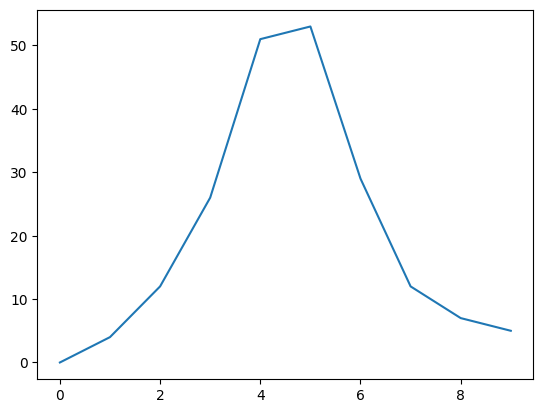

In [24]:
plt.plot(nx.degree_histogram(graph))
plt.show()

## Centrality Measures

In [25]:
#Topological betweenness centrality for the network 
# To dataframe using the nodes as the index
df = pd.DataFrame(index=graph.nodes())
betweenness_topo=nx.betweenness_centrality(graph,normalized=False)
nx.set_node_attributes(graph,betweenness_topo,'betweenness_topo')
df['betweenness_topo'] = pd.Series(nx.get_node_attributes(graph, 'betweenness_topo'))

df_sorted = df.sort_values(["betweenness_topo"], ascending=False)


In [26]:
nodes_to_remove_between_topo = df_sorted.index
nodes_to_remove_between_topo = nodes_to_remove_between_topo.tolist()
nodes_to_remove_between_topo

['涞源县_130630',
 '沧县_130921',
 '涞水县_130623',
 '滨海新区_120116',
 '泊头市_130981',
 '黄骅市_130983',
 '巨鹿县_130529',
 '宁晋县_130528',
 '武邑县_131122',
 '辛集市_130181',
 '枣强县_131121',
 '南宫市_130581',
 '武清区_120114',
 '深泽县_130128',
 '定州市_130682',
 '门头沟区_110109',
 '曲周县_130435',
 '唐县_130627',
 '阜平县_130624',
 '平乡县_130532',
 '宁河区_120117',
 '丰南区_130207',
 '灵寿县_130126',
 '丰润区_130208',
 '清苑区_130608',
 '静海区_120118',
 '昌平区_110114',
 '怀柔区_110116',
 '通州区_110112',
 '西青区_120111',
 '鹿泉区_130110',
 '蔚县_130726',
 '顺义区_110113',
 '河间市_130984',
 '迁西县_130227',
 '安国市_130683',
 '深州市_131182',
 '赤城县_130732',
 '威县_130533',
 '承德县_130821',
 '文安县_131026',
 '丰宁满族自治县_130826',
 '兴隆县_130822',
 '滦州市_130284',
 '阳原县_130727',
 '滦平县_130824',
 '霸州市_131081',
 '武强县_131123',
 '高碑店市_130684',
 '高阳县_130628',
 '邱县_130430',
 '涿鹿县_130731',
 '赵县_130133',
 '雄县_130638',
 '大兴区_110115',
 '怀来县_130730',
 '宽城满族自治县_130827',
 '肥乡区_130407',
 '任泽区_130505',
 '易县_130633',
 '藁城区_130109',
 '临城县_130522',
 '密云区_110118',
 '沙河市_130582',
 '元氏县_130132',
 '任丘市_130982',
 '固安县_1

In [27]:
shapefile_path = "./Data/city_agglomerations/京津冀/县级.shp"
shapefile_data = gpd.read_file(shapefile_path)


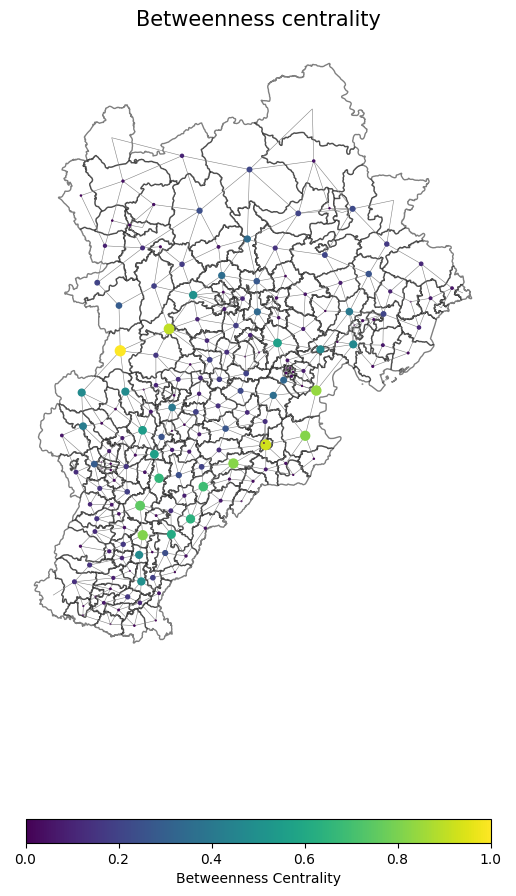

In [28]:
# Lets set colour and size of nodes according to betweenness values
between_values=[(i[1]['betweenness_topo']) for i in graph.nodes(data=True)]

deg_color=[(i[1]['betweenness_topo']/(max(between_values))) for i in graph.nodes(data=True)]
deg_size=[(i[1]['betweenness_topo']/(max(between_values)))*50 for i in graph.nodes(data=True)]

# Plot graph

#pos= nx.get_node_attributes(graph, 'coords')

fig, ax = plt.subplots(figsize=(12,12))
# Draw shapefile layer
shapefile_data.plot(ax=ax, alpha=0.5, edgecolor='black',facecolor='white')

nx.draw_networkx_edges(graph, pos,edge_color='gray', 
        width=0.4)
nod=nx.draw_networkx_nodes(graph,
        pos = pos,
        node_color= deg_color,
        node_size= deg_size)
plt.colorbar(nod,label="Betweenness Centrality",orientation="horizontal", shrink=0.5)
plt.axis("off")
plt.title("Betweenness centrality",fontsize=15)
plt.show()

In [192]:
#define a function that measures the impact
def impact_measure(network):
    #eccentricities = nx.eccentricity(network)
    #diameter = max(eccentricities.values())
    largest_component = max(nx.connected_components(network), key=len)
    largest_subgraph = network.subgraph(largest_component)
    largest_component_size = len(largest_component)
    #diameter = nx.diameter(largest_subgraph)
    connectivity = nx.edge_connectivity(network)
    efficiency = nx.global_efficiency(network)
    clustering = nx.average_clustering(network)
    #avg_shortest_path_length = nx.average_shortest_path_length(network)
    return largest_component_size, efficiency

In [30]:
edges_removed = []
def remove_nodes(graph, nodes_to_remove, result_table):
    
    i = 0
    for node in nodes_to_remove:
        graph.remove_node(node)
        edges_removed.extend(list(graph.edges(node)))
        # measure the impact
        if graph.number_of_nodes() > 0:  # Check if there are nodes remaining in the graph
            largest_component_size, connectivity, efficiency = impact_measure(graph)
            # store the results in the DataFrame
            result_table.loc[i+1] = [node,largest_component_size, connectivity, efficiency]
        else:
            largest_component_size = 1
            efficiency = 0
            result_table.loc[i+1] = [node,largest_component_size, connectivity, efficiency]
            
        #print(f'The ranked {i+1} {node} is removed')
        i += 1
    return result_table #, edges_removed

In [30]:
graph_origin = graph.copy()
def add_nodes(graph, nodes_to_add, result_table):
    i =  len(list(nodes_to_add))
    for node in nodes_to_add:
        graph.add_node(node)
        graph.add_edges_from(list(graph_origin.edges(node)))
        largest_component_size, connectivity, efficiency = impact_measure(graph)
        result_table.loc[i+1] = [node, largest_component_size, connectivity, efficiency]
       # print(f'The ranked {i - len(list(nodes_to_add))} {node} is added')
        i += 1
    return result_table

## Node Removal
## Static Approach

### Random Failure

In [31]:
graph_topo_random = graph.copy()
results_random_topo = pd.DataFrame(columns=['removal', 'size of lagrest component', 'connectivity', 'efficiency'])

In [32]:
import random
random_nodes_to_remove = random.sample(list(graph_topo_random.nodes()), k = int(len(list(graph_topo_random.nodes()))))

In [33]:
remove_nodes(graph_topo_random,random_nodes_to_remove,results_random_topo)
add_nodes(graph_topo_random,random_nodes_to_remove,results_random_topo)

ValueError: not enough values to unpack (expected 3, got 2)

208


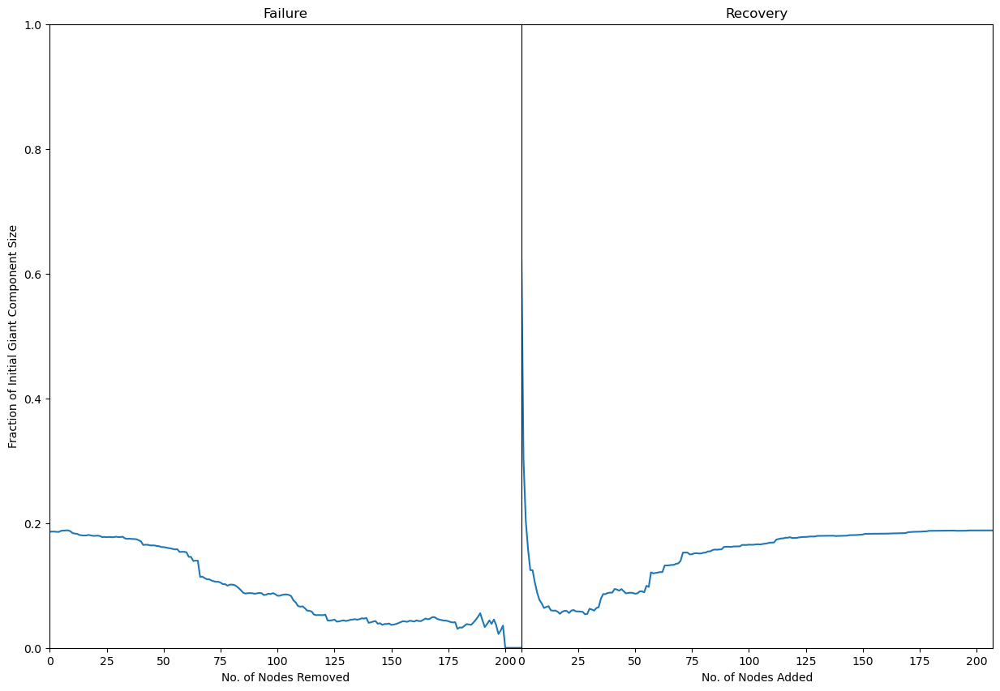

In [ ]:
node_frac = np.arange(len(random_nodes_to_remove)) 
len_node = len(node_frac)

print(len(node_frac))

import matplotlib.pyplot as plt

plt.figure(figsize=(15, 10))

plt.subplot(1, 2, 1)
plt.plot(node_frac, results_random_topo.loc[0:len_node]['efficiency'])

plt.ylim(top=1.0, bottom=0.0)
plt.xlabel('No. of Nodes Removed')
plt.ylabel('Fraction of Initial Giant Component Size')
plt.title('Failure')
plt.margins(x=0, y=0)

plt.subplot(1, 2, 2)
plt.plot(node_frac, results_random_topo.loc[len_node+1:len_node*2]['efficiency'])
plt.ylim(bottom=0, top=1.0)
plt.yticks([])
plt.xlabel('No. of Nodes Added')
plt.title('Recovery')
plt.margins(x=0, y=0)

plt.subplots_adjust(wspace=0)
plt.show()


### Directed Failure

In [ ]:
graph_topo_between = graph.copy()
results_between_topo = pd.DataFrame({'removal': ['initial'],
                        'size of lagrest component': [largest_component_size_init],
                        #'connectivity': [connectivity_init],
                        'efficiency':[efficiency_init]})
#results_between_topo = pd.DataFrame(columns=['removal', 'size of lagrest component', 'connectivity', 'efficiency'])

In [ ]:
remove_nodes(graph_topo_between, nodes_to_remove_between_topo, results_between_topo)

,removal,size of lagrest component,connectivity,efficiency
0,initial,208,1,0.188228
1,涞源县_130630_130630,207,1,0.183473
2,巨鹿县_130529_130529,206,1,0.181023
3,沧县_130921_130921,205,1,0.178453
4,涞水县_130623_130623,204,1,0.174952
...,...,...,...,...
204,围场满族蒙古族自治县_130828_130828,1,0,0.000000
205,鹰手营子矿区_130804_130804,1,0,0.000000
206,新华区_130902_130902,1,0,0.000000
207,竞秀区_130602_130602,1,0,0.000000


In [ ]:
add_nodes(graph_topo_between, nodes_to_remove_between_topo, results_between_topo)

,removal,size of lagrest component,connectivity,efficiency
0,initial,208,1,0.188228
1,涞源县_130630_130630,207,1,0.183473
2,巨鹿县_130529_130529,206,1,0.181023
3,沧县_130921_130921,205,1,0.178453
4,涞水县_130623_130623,204,1,0.174952
...,...,...,...,...
412,围场满族蒙古族自治县_130828_130828,208,1,0.188228
413,鹰手营子矿区_130804_130804,208,1,0.188228
414,新华区_130902_130902,208,1,0.188228
415,竞秀区_130602_130602,208,1,0.188228


In [ ]:
node_frac = np.arange(len(nodes_to_remove_between_topo)) 

print(len(node_frac))

208


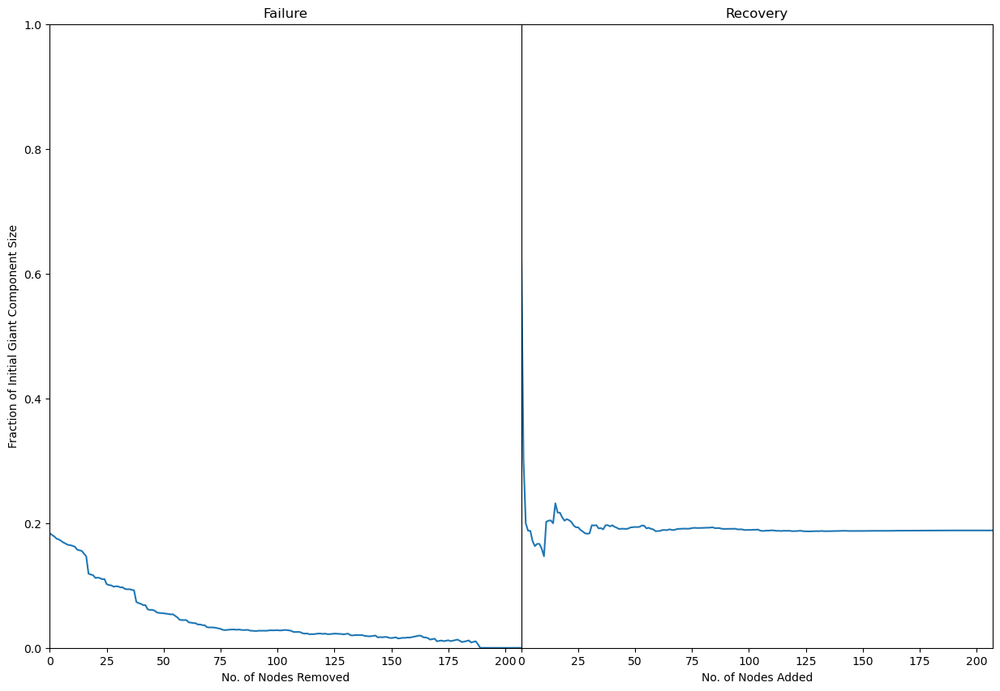

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(15, 10))

plt.subplot(1, 2, 1)
plt.plot(node_frac, results_between_topo.loc[1:208]['efficiency'])

plt.ylim(top=1, bottom=0)
plt.xlabel('No. of Nodes Removed')
plt.ylabel('Fraction of Initial Giant Component Size')
plt.title('Failure')
plt.margins(x=0, y=0)

plt.subplot(1, 2, 2)
plt.plot(node_frac, results_between_topo.loc[209:416]['efficiency'])
plt.ylim(bottom=0, top=1)
plt.yticks([])
plt.xlabel('No. of Nodes Added')
plt.title('Recovery')
plt.margins(x=0, y=0)

plt.subplots_adjust(wspace=0)
plt.show()


### Analysis
涞源地处两省三市交界处（山西and河北，保定、张家口、大同）
巨鹿县 地处

Recovery

## Dynamic Appproach

### Cascading Failure

node capacity

load $L_{i} = Betweenness centrality

In [34]:
def node_capacity(alpha, load):
    #alpha is the tolerance parameter
    capacity = (1 + alpha) * load
    return capacity

In [35]:
# Iterate over the nodes and add capacity as an attribute
for node, data in graph.nodes(data=True):
    data['capacity'] = node_capacity(0.01, data['betweenness_topo'])

In [36]:
graph_topo_cascading = graph.copy()
results_topo_cascading = pd.DataFrame({'removal': ['initial'],
                        'size of lagrest component': [largest_component_size_init],
                        #'connectivity': [connectivity_init],
                        #'average shortest path length': [avg_shortest_path_length_init],
                        'efficiency':[efficiency_init]})

NameError: name 'largest_component_size_init' is not defined

In [ ]:
def find_between_top(graph):
    heavily_loaded = []
    for node, data in graph.nodes(data=True):
        #if one node's load is bigger than capacity
        if data['betweenness_cascading']>data['capacity'] :
            print(f'{node} exceeds capacity')
            heavily_loaded.append(node)
    return heavily_loaded
def find_closest(graph, top_node, node_lists):
    min_distance = float('inf')  # Initialize with a large value
    min_distance_node = None
    for node in node_lists:
        distance = nx.shortest_path_length(graph, top_node, node, weight='distance')
        if distance < min_distance:  # Update condition to check for minimum distance
            min_distance = distance
            min_distance_node = node
    return min_distance_node

    

In [ ]:
#remove first node
nodes_removed = []
 # find the node with the highest betweenness centrality
highest_betweenness = max(graph.nodes(data=True), key=lambda x: x[1]['betweenness_topo'])
highest_betweenness_node = highest_betweenness[0]
#print(highest_betweenness_node)
# append the node into the list
nodes_removed.append(highest_betweenness_node)
# remove the first node that has the highest betweenness centrality
graph_topo_cascading.remove_node(highest_betweenness_node)
largest_component_size, connectivity, efficiency = impact_measure(graph_topo_cascading)
results_topo_cascading.loc[1] = [highest_betweenness_node, largest_component_size, connectivity, efficiency]

In [ ]:
def iterative_node_removal(between_graph, original_graph, results_table):
    i = 2
    nodes_removed = []
    while True:
        # after removal recalculate the betweenness centrality
        betweenness_centrality = nx.betweenness_centrality(between_graph)
        # assign the betweenness centrality to the nodes
        nx.set_node_attributes(between_graph, betweenness_centrality, 'betweenness_cascading')
        # find the nodes that their capacity exceeds their capacity
        heavily_loaded_nodes = find_between_top(between_graph)
        if not heavily_loaded_nodes:
            break
        # find the node that is closest to the highest betweenness centrality
        closest_node = find_closest(between_graph, nodes_removed[i-2], heavily_loaded_nodes)
        nodes_removed.append(closest_node)
        between_graph.remove_node(closest_node)
        largest_component_size, connectivity, efficiency = impact_measure(between_graph)
        results_table.loc[i+1] = [closest_node, largest_component_size, connectivity, efficiency]
        print(f"Closest node to {highest_betweenness_node}: {closest_node}")
        i += 1
    return between_graph, results_table


In [ ]:
i = 2
while True:
    heavily_loaded = []
     # after removal recalculate the betweenness centrality
    betweenness_cascading=nx.betweenness_centrality(graph_topo_cascading,normalized=False)
    # assign the betweenness centrality to the nodes
    nx.set_node_attributes(graph_topo_cascading,betweenness_cascading,'betweenness_cascading')
    ##df['betweenness_cascading'] = pd.Series(nx.get_node_attributes(graph_topo_cascading, 'betweenness_cascading'))
    # find the nodes that their capacity exceeds their capacity
    for node, data in graph_topo_cascading.nodes(data=True):
        #if one node's load is bigger than capacity
        if data['betweenness_cascading']>data['capacity'] :
            #print(f'{node} exceeds capacity')
            heavily_loaded.append(node)
    # If no more heavily loaded nodes, break the loop
    if not heavily_loaded:
        break
    #find the node that is the closest to the former failed node 
    closest_node = find_closest(graph, nodes_removed[i-2], heavily_loaded)
    nodes_removed.append(closest_node)
    graph_topo_cascading.remove_node(closest_node)
    largest_component_size, connectivity, efficiency = impact_measure(graph_topo_cascading)
    results_topo_cascading.loc[i+1] = [closest_node, largest_component_size, connectivity, efficiency]
    print(f"Closest node to {nodes_removed[i-2]}: {closest_node}")
    i += 1
    #graph_topo_cascading.remove_nodes_from(heavily_loaded)
    #largest_component_size,connectivity,efficiency = impact_measure(graph_topo_cascading)
    # store the results in the DataFrame
    #results_topo_cascading.loc[i+1] = [heavily_loaded, largest_component_size,connectivity,efficiency]
    
    #print(f'The {i}th {heavily_loaded} is removed')
    #i = i + 1
    


Closest node to 涞源县_130630_130630: 易县_130633_130633
Closest node to 易县_130633_130633: 定兴县_130626_130626
Closest node to 定兴县_130626_130626: 徐水区_130609_130609
Closest node to 徐水区_130609_130609: 莲池区_130606_130606
Closest node to 莲池区_130606_130606: 清苑区_130608_130608
Closest node to 清苑区_130608_130608: 蠡县_130635_130635
Closest node to 蠡县_130635_130635: 高阳县_130628_130628
Closest node to 高阳县_130628_130628: 安新县_130632_130632
Closest node to 安新县_130632_130632: 雄县_130638_130638
Closest node to 雄县_130638_130638: 固安县_131022_131022
Closest node to 固安县_131022_131022: 永清县_131023_131023
Closest node to 永清县_131023_131023: 安次区_131002_131002
Closest node to 安次区_131002_131002: 广阳区_131003_131003
Closest node to 广阳区_131003_131003: 大兴区_110115_110115
Closest node to 大兴区_110115_110115: 通州区_110112_110112
Closest node to 通州区_110112_110112: 香河县_131024_131024
Closest node to 香河县_131024_131024: 三河市_131082_131082
Closest node to 三河市_131082_131082: 平谷区_110117_110117
Closest node to 平谷区_110117_110117: 顺义区_110113_110113

In [ ]:
results_topo_cascading

,removal,size of lagrest component,connectivity,efficiency
0,initial,208,1,0.188228
1,涞源县_130630_130630,207,1,0.183473
3,易县_130633_130633,206,1,0.181763
4,定兴县_130626_130626,205,1,0.181651
5,徐水区_130609_130609,204,1,0.181172
...,...,...,...,...
112,正定县_130123_130123,205,1,0.187597
113,新乐市_130184_130184,206,1,0.187838
114,行唐县_130125_130125,207,1,0.187804
115,曲阳县_130634_130634,207,1,0.188214


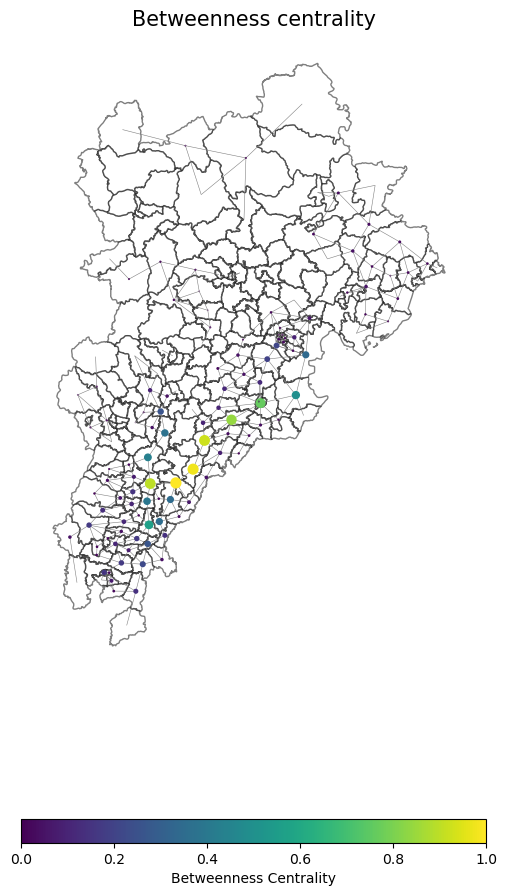

In [ ]:
# Lets set colour and size of nodes according to betweenness values
between_values=[(i[1]['betweenness_cascading']) for i in graph_topo_cascading.nodes(data=True)]

deg_color=[(i[1]['betweenness_cascading']/(max(between_values))) for i in graph_topo_cascading.nodes(data=True)]
deg_size=[(i[1]['betweenness_cascading']/(max(between_values)))*50 for i in graph_topo_cascading.nodes(data=True)]

# Plot graph_topo_cascading

#pos= nx.get_node_attributes(graph_topo_cascading, 'coords')

fig, ax = plt.subplots(figsize=(12,12))
# Draw shapefile layer
shapefile_data.plot(ax=ax, alpha=0.5, edgecolor='black',facecolor='white')

nx.draw_networkx_edges(graph_topo_cascading, pos,edge_color='gray', 
        width=0.4)
nod=nx.draw_networkx_nodes(graph_topo_cascading,
        pos = pos,
        node_color= deg_color,
        node_size= deg_size)
plt.colorbar(nod,label="Betweenness Centrality",orientation="horizontal", shrink=0.5)
plt.axis("off")
plt.title("Betweenness centrality",fontsize=15)
plt.show()

Recovery

In [ ]:
add_nodes(graph_topo_cascading, nodes_removed, results_topo_cascading)

,removal,size of lagrest component,connectivity,efficiency
0,initial,208,1,0.188228
1,涞源县_130630_130630,207,1,0.183473
3,易县_130633_130633,206,1,0.181763
4,定兴县_130626_130626,205,1,0.181651
5,徐水区_130609_130609,204,1,0.181172
...,...,...,...,...
112,正定县_130123_130123,205,1,0.187597
113,新乐市_130184_130184,206,1,0.187838
114,行唐县_130125_130125,207,1,0.187804
115,曲阳县_130634_130634,207,1,0.188214


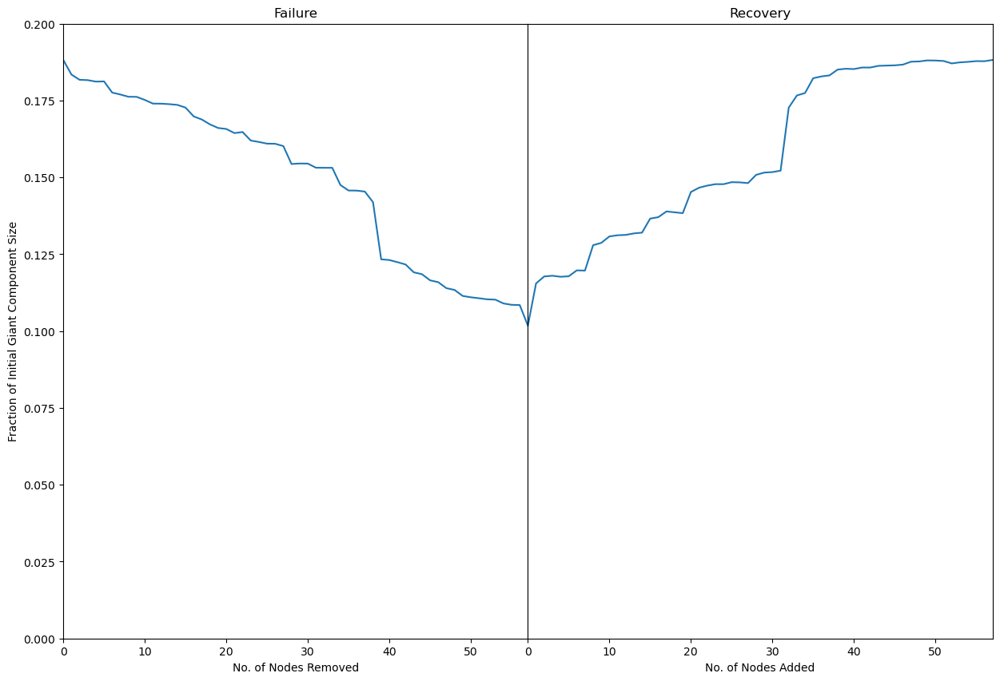

In [ ]:
node_frac = np.arange(len(nodes_removed)) 
import matplotlib.pyplot as plt

plt.figure(figsize=(15, 10))

plt.subplot(1, 2, 1)
plt.plot(node_frac, results_topo_cascading.loc[0:58]['efficiency'])

plt.ylim(top=0.2, bottom=0)
plt.xlabel('No. of Nodes Removed')
plt.ylabel('Fraction of Initial Giant Component Size')
plt.title('Failure')
plt.margins(x=0, y=0)

plt.subplot(1, 2, 2)
plt.plot(node_frac, results_topo_cascading.loc[58:115]['efficiency'])
plt.ylim(bottom=0, top=0.2)
plt.yticks([])
plt.xlabel('No. of Nodes Added')
plt.title('Recovery')
plt.margins(x=0, y=0)

plt.subplots_adjust(wspace=0)
plt.show()


In [ ]:
def plot_did(edges_removed,result_table):
    edge_frac = np.arange(len(edges_removed))
    len_edge = len(edge_frac)
    plt.figure(figsize=(15, 10))

    plt.subplot(1, 2, 1)
    plt.plot(edge_frac, result_table.loc[0:len_edge]['efficiency'])

    plt.ylim(top=0.2, bottom=0)
    plt.xlabel('No. of Links Removed')
    plt.ylabel('Fraction of Initial Giant Component Size')
    plt.title('Failure')
    plt.margins(x=0, y=0)

    plt.subplot(1, 2, 2)
    plt.plot(edge_frac, result_table.loc[len_edge:len_edge*2-1]['efficiency'])
    plt.ylim(bottom=0, top=0.2)
    plt.yticks([])
    plt.xlabel('No. of Nodes Added')
    plt.title('Recovery')
    plt.margins(x=0, y=0)

    plt.subplots_adjust(wspace=0)
    plt.show()


## Edge removal

In [ ]:
gcc_init_topo,efficiency_init_topo = impact_measure(graph)

In [392]:
def remove_edges(graph, edges_to_remove, result_table):
    i = 0
    #edges_removed = []
    threshold = 0.2*efficiency_init_topo
    for edge in edges_to_remove:
        graph.remove_edge(edge[0],edge[1])
        #edges_removed.append(edge)
        #edges_removed.extend(list(graph.edges(edge)))
        # measure the impact
        if graph.number_of_edges() > 0:  # Check if there are edges remaining in the graph
            largest_component_size,efficiency = impact_measure(graph)
            # store the results in the DataFrame
            result_table.loc[i+1] = [edge,largest_component_size, efficiency]
        else:
            largest_component_size = 1
            efficiency = 0
            result_table.loc[i+1] = [edge,largest_component_size, efficiency]
            
        #print(f'The ranked {i+1} {edge} is removed')
        if efficiency <= threshold:
            break
        i += 1
    return result_table#,edges_removed

#Di_graph_origin = Di_graph.copy()
def add_edges(graph, edges_to_add, result_table):
    i =  len(edges_to_add)
    edges_to_add_array = np.array(edges_to_add, dtype=object)
    for edge in edges_to_add_array:
        #graph.add_node(node)
        graph.add_edge(edge[0],edge[1])
        #print(f'{edge} has been added')
        largest_component_size, efficiency = impact_measure(graph)
        result_table.loc[i+1] = [edge, largest_component_size, efficiency]
       # print(f'The ranked {i - len(list(edges_to_add))} {node} is added')
        i += 1
    return result_table

### Cascading Failure

In [195]:
def edge_capacity(alpha, load):
    #alpha is the tolerance parameter
    capacity = (1 + alpha) * load
    return capacity

In [196]:
# Iterate over the nodes and add capacity as an attribute
for node1,node2, data in graph.edges(data=True):
    data['capacity'] = edge_capacity(0.1, data['betweenness_edge'])

In [197]:
graph_cascading_edge_topo = graph.copy()
results_cascading_edge_topo = pd.DataFrame(columns=['removal', 'gcc', 'efficiency'])

In [198]:
#remove first node
edges_removed_cascadin_topo = []
 # find the node with the highest betweenness centrality
#highest_betweenness = max(graph.edges(data=True), key=lambda x: x[1]['betweenness_dir'])
highest_betweenness = max(graph_cascading_edge_topo.edges(data=True), key=lambda x: x[2].get('betweenness_edge', 0))

highest_betweenness_edge = highest_betweenness[0],highest_betweenness[1]

# append the node into the list
edges_removed_cascadin_topo.append(highest_betweenness_edge)
# remove the first node that has the highest betweenness centrality
graph_cascading_edge_topo.remove_edge( highest_betweenness[0],highest_betweenness[1])
largest_component_size, efficiency = impact_measure(graph_cascading_edge_topo)
results_cascading_edge_topo.loc[1] = [highest_betweenness_edge, largest_component_size, efficiency]

In [49]:
highest_betweenness_edge

('沧县_130921', '泊头市_130981')

In [199]:
i = 2
while True:
    betweenness_cascading_edge = nx.edge_betweenness_centrality(graph_cascading_edge_topo, normalized=False)
    nx.set_edge_attributes(graph_cascading_edge_topo, betweenness_cascading_edge, 'betweenness_edge')
    
    # Create a copy of edges_removed_cascadin_topo to avoid modifying it while iterating
    edges_removed_copy = edges_removed_cascadin_topo.copy()
    
    shortest_paths = []
    for edge in edges_removed_copy:
        try:
            shortest_path = nx.shortest_path(graph_cascading_edge_topo, edge[0], edge[1], weight='distance')
            shortest_paths.append(shortest_path)
        except nx.NetworkXNoPath:
            print(f"No path between {edge[0]} and {edge[1]}")

    exceeding_capacity_edges = False  # Flag to indicate if there are exceeding capacity edges
    
    for shortest_path in shortest_paths:
        shortest_edges_list = []
        for idx in range(len(shortest_path)-1):
            shortest_edge = (shortest_path[idx], shortest_path[idx+1])
            shortest_edges_list.append(shortest_edge)
        
        for edge in shortest_edges_list:
            edge_data = graph_cascading_edge_topo.get_edge_data(*edge)
            if edge_data is not None:
                load = edge_data.get('betweenness_edge', 0)
                capacity = edge_data.get('capacity', 0)
                if load is not None and capacity is not None and load > capacity:
                    print(f"The load of edge {edge} is greater than capacity.")
                    edges_removed_cascadin_topo.append(edge)
                    graph_cascading_edge_topo.remove_edge(*edge)
                    largest_component_size, efficiency = impact_measure(graph_cascading_edge_topo)
                    results_cascading_edge_topo.loc[i] = [edge, largest_component_size, efficiency]
                    i += 1
                    exceeding_capacity_edges = True  # Set the flag to True
                else:
                    print(f"The load of edge {edge} is within capacity.")
            else:
                print(f"No edge data found for {edge}")
    
    if not exceeding_capacity_edges:
        break  # Break the loop if there are no exceeding capacity edges


The load of edge ('沧县_130921', '南皮县_130927') is greater than capacity.
The load of edge ('南皮县_130927', '泊头市_130981') is greater than capacity.
The load of edge ('沧县_130921', '献县_130929') is greater than capacity.
The load of edge ('献县_130929', '泊头市_130981') is greater than capacity.
The load of edge ('沧县_130921', '孟村回族自治县_130930') is greater than capacity.
The load of edge ('孟村回族自治县_130930', '南皮县_130927') is greater than capacity.
The load of edge ('南皮县_130927', '东光县_130923') is greater than capacity.
The load of edge ('东光县_130923', '泊头市_130981') is greater than capacity.
The load of edge ('沧县_130921', '河间市_130984') is greater than capacity.
The load of edge ('河间市_130984', '献县_130929') is greater than capacity.
The load of edge ('献县_130929', '武强县_131123') is greater than capacity.
The load of edge ('武强县_131123', '泊头市_130981') is within capacity.
The load of edge ('沧县_130921', '黄骅市_130983') is within capacity.
The load of edge ('黄骅市_130983', '海兴县_130924') is greater than capacity.
The l

In [200]:
add_edges(graph_cascading_edge_topo, edges_removed_cascadin_topo, results_cascading_edge_topo)

,removal,gcc,efficiency
1,"(沧县_130921, 泊头市_130981)",199,0.194436
2,"(沧县_130921, 南皮县_130927)",199,0.194300
3,"(南皮县_130927, 泊头市_130981)",199,0.194029
4,"(沧县_130921, 献县_130929)",199,0.193065
5,"(献县_130929, 泊头市_130981)",199,0.192836
...,...,...,...
444,"[宽城满族自治县_130827, 平泉市_130881]",199,0.195277
445,"[平泉市_130881, 承德县_130821]",199,0.195432
446,"[承德县_130821, 双滦区_130803]",199,0.195550
447,"[路北区_130203, 开平区_130205]",199,0.195575


In [52]:
len(edges_removed_cascadin_topo)

224

In [334]:
results_cascading_edge_topo['efficiency'].min()/efficiency_init_topo

0.22545267389717805

### Directed Failure

In [ ]:
df_between_edge = pd.DataFrame(index=graph.edges())
betweenness_edge=nx.edge_betweenness_centrality(graph,normalized=False)
nx.set_edge_attributes(graph,betweenness_edge,'betweenness_edge')
df_between_edge['betweenness_edge'] = pd.Series(nx.get_edge_attributes(graph, 'betweenness_edge'))

df_between_edge = df_between_edge.sort_values(["betweenness_edge"], ascending=False)
df_between_edge[0:10]

betweenness_edge
沧县_130921  泊头市_130981        2992.934559
           黄骅市_130983        2974.248509
黄骅市_130983 滨海新区_120116       2881.898097
涞水县_130623 涞源县_130630        2794.782204
泊头市_130981 武邑县_131122        2649.052668
武邑县_131122 枣强县_131121        2399.020125
辛集市_130181 宁晋县_130528        2377.700109
枣强县_131121 南宫市_130581        2216.968449
巨鹿县_130529 宁晋县_130528        2058.091016
平乡县_130532 巨鹿县_130529        2028.183994

In [414]:
edges_to_remove_between_topo = df_between_edge.index
edges_to_remove_between_topo = edges_to_remove_between_topo.tolist()
removed_edges_between = edges_to_remove_between_topo[0:224]

In [415]:
len(removed_edges_between)

224

In [416]:
graph_between_edge = graph.copy()
results_between_edge = pd.DataFrame(columns=['removal', 'gcc', 'efficiency'])

In [417]:
remove_edges(graph_between_edge, removed_edges_between, results_between_edge)
add_edges(graph_between_edge, removed_edges_between, results_between_edge)

,removal,gcc,efficiency
1,"(沧县_130921, 泊头市_130981)",199,0.194436
2,"(沧县_130921, 黄骅市_130983)",199,0.193919
3,"(黄骅市_130983, 滨海新区_120116)",199,0.192979
4,"(涞水县_130623, 涞源县_130630)",199,0.191382
5,"(泊头市_130981, 武邑县_131122)",199,0.191135
...,...,...,...
444,"[磁县_130427, 邯山区_130402]",199,0.195012
445,"[武清区_120114, 宝坻区_120115]",199,0.195222
446,"[阜平县_130624, 行唐县_130125]",199,0.195373
447,"[大名县_130425, 馆陶县_130433]",199,0.195458


In [ ]:
len(removed_edges_between)

251

Ascending

In [ ]:
df_between_edge_ascending = df_between_edge.sort_values(["betweenness_edge"], ascending=True)
df_between_edge_ascending

,,betweenness_edge
西城区_110102,东城区_110101,1.333333
南开区_120104,河西区_120103,2.833333
桥西区_130104,新华区_130105,3.438567
古冶区_130204,开平区_130205,3.570707
长安区_130102,裕华区_130108,3.652381
...,...,...
泊头市_130981,武邑县_131122,2649.052668
涞水县_130623,涞源县_130630,2794.782204
黄骅市_130983,滨海新区_120116,2881.898097
沧县_130921,黄骅市_130983,2974.248509


In [ ]:
edges_to_remove_between_topo_a = df_between_edge_ascending.index
edges_to_remove_between_topo_a = edges_to_remove_between_topo_a.tolist()

In [ ]:
graph_between_edge_a = graph.copy()
results_between_edge_a = pd.DataFrame(columns=['removal', 'gcc', 'efficiency'])

In [ ]:
remove_edges(graph_between_edge_a,edges_to_remove_between_topo_a,results_between_edge_a)
add_edges(graph_between_edge_a,edges_to_remove_between_topo_a,results_between_edge_a)

['西城区_110102' '东城区_110101'] has been added
['南开区_120104' '河西区_120103'] has been added
['桥西区_130104' '新华区_130105'] has been added
['古冶区_130204' '开平区_130205'] has been added
['长安区_130102' '裕华区_130108'] has been added
['复兴区_130404' '峰峰矿区_130406'] has been added
['成安县_130424' '魏县_130434'] has been added
['开平区_130205' '路北区_130203'] has been added
['红桥区_120106' '南开区_120104'] has been added
['红桥区_120106' '河北区_120105'] has been added
['丰台区_110106' '海淀区_110108'] has been added
['永年区_130408' '鸡泽县_130431'] has been added
['广平县_130432' '肥乡区_130407'] has been added
['临漳县_130423' '磁县_130427'] has been added
['成安县_130424' '邯山区_130402'] has been added
['运河区_130903' '新华区_130902'] has been added
['东丽区_120110' '津南区_120112'] has been added
['滦南县_130224' '曹妃甸区_130209'] has been added
['河北区_120105' '南开区_120104'] has been added
['抚宁区_130306' '卢龙县_130324'] has been added
['隆化县_130825' '双滦区_130803'] has been added
['桥西区_130703' '万全区_130708'] has been added
['无极县_130130' '新乐市_130184'] has been added
['河北区_12010

,removal,gcc,efficiency
1,"(西城区_110102, 东城区_110101)",199,0.195611
2,"(南开区_120104, 河西区_120103)",199,0.195585
3,"(桥西区_130104, 新华区_130105)",199,0.195560
4,"(古冶区_130204, 开平区_130205)",199,0.195535
5,"(长安区_130102, 裕华区_130108)",199,0.195509
...,...,...,...
930,"[泊头市_130981, 武邑县_131122]",199,0.191382
931,"[涞水县_130623, 涞源县_130630]",199,0.192979
932,"[黄骅市_130983, 滨海新区_120116]",199,0.193919
933,"[沧县_130921, 黄骅市_130983]",199,0.194436


### Random Failure

Repetition

In [418]:
import random

#  Repeat the random failure and recovery process 30 times
all_results = []

for i in range(10):
    print(f"Repetition {i+1} of 10 is in progress...")  # Reminder of the repetition process
    
    graph_random_edge = graph.copy()
    results_random_edge = pd.DataFrame(columns=['removal', 'gcc', 'efficiency'])
    
    #num_edges_to_remove = int(len(list(graph_random_edge.edges())))
    random_edges_to_remove = random.sample(list(graph_random_edge.edges()), k=224)
    
    remove_edges(graph_random_edge, random_edges_to_remove, results_random_edge)
    add_edges(graph_random_edge, random_edges_to_remove, results_random_edge)  # Use removed_edges here instead of random_edges_to_remove
    
    all_results.append(results_random_edge)  # Append results_after_addition to all_results


Repetition 1 of 10 is in progress...
Repetition 2 of 10 is in progress...
Repetition 3 of 10 is in progress...
Repetition 4 of 10 is in progress...
Repetition 5 of 10 is in progress...
Repetition 6 of 10 is in progress...
Repetition 7 of 10 is in progress...
Repetition 8 of 10 is in progress...
Repetition 9 of 10 is in progress...
Repetition 10 of 10 is in progress...


In [419]:
# Calculate mean and standard deviation for each fraction of links removed/added
mean_gcc = pd.concat([df['gcc'] for df in all_results], axis=1).mean(axis=1)
std_gcc = pd.concat([df['gcc'] for df in all_results], axis=1).std(axis=1)
mean_eff = pd.concat([df['efficiency'] for df in all_results], axis=1).mean(axis=1)
std_eff = pd.concat([df['efficiency'] for df in all_results], axis=1).std(axis=1)

One time

In [ ]:
graph_random_edge = graph.copy()
results_random_edge = pd.DataFrame(columns=['removal', 'gcc', 'efficiency'])

In [ ]:

num_edges_to_remove = int(len(list(graph_random_edge.edges())))
random_edges_to_remove = random.sample(list(graph_random_edge.edges()), k = num_edges_to_remove)
random_edges_to_remove

[('高邑县_130127', '临城县_130522'),
 ('高阳县_130628', '河间市_130984'),
 ('迁西县_130227', '滦州市_130284'),
 ('武清区_120114', '北辰区_120113'),
 ('威县_130533', '南宫市_130581'),
 ('大名县_130425', '广平县_130432'),
 ('深泽县_130128', '辛集市_130181'),
 ('乐亭县_130225', '曹妃甸区_130209'),
 ('威县_130533', '广宗县_130531'),
 ('遵化市_130281', '丰润区_130208'),
 ('滦平县_130824', '承德县_130821'),
 ('枣强县_131121', '南宫市_130581'),
 ('广宗县_130531', '巨鹿县_130529'),
 ('高阳县_130628', '肃宁县_130926'),
 ('北辰区_120113', '红桥区_120106'),
 ('望都县_130631', '唐县_130627'),
 ('大兴区_110115', '涿州市_130681'),
 ('南宫市_130581', '清河县_130534'),
 ('桃城区_131102', '冀州区_131103'),
 ('沙河市_130582', '南和区_130506'),
 ('清苑区_130608', '安新县_130632'),
 ('定州市_130682', '深泽县_130128'),
 ('广阳区_131003', '永清县_131023'),
 ('鹿泉区_130110', '元氏县_130132'),
 ('海兴县_130924', '盐山县_130925'),
 ('门头沟区_110109', '房山区_110111'),
 ('武安市_130481', '涉县_130426'),
 ('任泽区_130505', '隆尧县_130525'),
 ('鹿泉区_130110', '裕华区_130108'),
 ('肥乡区_130407', '曲周县_130435'),
 ('平乡县_130532', '巨鹿县_130529'),
 ('元氏县_130132', '栾城区_130111'),
 ('易县_1306

In [ ]:
remove_edges(graph_random_edge,random_edges_to_remove,results_random_edge)
add_edges(graph_random_edge,random_edges_to_remove,results_random_edge)

['高邑县_130127' '临城县_130522'] has been added
['高阳县_130628' '河间市_130984'] has been added
['迁西县_130227' '滦州市_130284'] has been added
['武清区_120114' '北辰区_120113'] has been added
['威县_130533' '南宫市_130581'] has been added
['大名县_130425' '广平县_130432'] has been added
['深泽县_130128' '辛集市_130181'] has been added
['乐亭县_130225' '曹妃甸区_130209'] has been added
['威县_130533' '广宗县_130531'] has been added
['遵化市_130281' '丰润区_130208'] has been added
['滦平县_130824' '承德县_130821'] has been added
['枣强县_131121' '南宫市_130581'] has been added
['广宗县_130531' '巨鹿县_130529'] has been added
['高阳县_130628' '肃宁县_130926'] has been added
['北辰区_120113' '红桥区_120106'] has been added
['望都县_130631' '唐县_130627'] has been added
['大兴区_110115' '涿州市_130681'] has been added
['南宫市_130581' '清河县_130534'] has been added
['桃城区_131102' '冀州区_131103'] has been added
['沙河市_130582' '南和区_130506'] has been added
['清苑区_130608' '安新县_130632'] has been added
['定州市_130682' '深泽县_130128'] has been added
['广阳区_131003' '永清县_131023'] has been added
['鹿泉区_130110'

,removal,gcc,efficiency
1,"(高邑县_130127, 临城县_130522)",199,0.195542
2,"(高阳县_130628, 河间市_130984)",199,0.195149
3,"(迁西县_130227, 滦州市_130284)",199,0.194914
4,"(武清区_120114, 北辰区_120113)",199,0.194638
5,"(威县_130533, 南宫市_130581)",199,0.194367
...,...,...,...
930,"[安国市_130683, 博野县_130637]",199,0.193752
931,"[泊头市_130981, 武邑县_131122]",199,0.194957
932,"[深州市_131182, 辛集市_130181]",199,0.195459
933,"[顺义区_110113, 三河市_131082]",199,0.195590


In [ ]:
results_random_edge.to_csv('results_random_edge.csv', encoding='utf-8-sig')

### Comparison

In [54]:
gcc_init_topo,efficiency_init_topo

(199, 0.1956360952561006)

#### 组间比较-Eff

In [351]:
def plot_did_comparison(scenario_data):
    plt.figure(figsize=(15, 10))
    
    colors = ['blue', 'red', 'green', 'purple']
    scenario_names = ['Random Attack','Directed Attack','Cascading Failure']  # Names of scenarios
    
    for idx, (edges_removed, result_table) in enumerate(scenario_data):
        edge_frac = np.arange(len(edges_removed))
        len_edge = len(edge_frac)
        
        # Failure subplot
        plt.subplot(1, 2, 1)
        plt.plot(edge_frac/len_edge*100, result_table.loc[0:len_edge]['efficiency']/efficiency_init_topo*100, color=colors[idx], label=scenario_names[idx])
        plt.ylim(top=100, bottom=0)  # Adjusted to show percentage
        plt.xlabel('Fraction of Links Removed (%)',size=16)
        plt.ylabel('Proportion of Initial Efficiency (%)',size=16)
        plt.title('Failure',size=16)
        plt.legend(fontsize=16)
        plt.margins(x=0, y=0)
        
        # Recovery subplot
        plt.subplot(1, 2, 2)
        plt.plot(edge_frac/len_edge*100, result_table.loc[len_edge:len_edge*2-1]['efficiency']/efficiency_init_topo*100, color=colors[idx], label=scenario_names[idx])
        plt.ylim(bottom=0, top=100)  # Adjusted to show percentage
        plt.yticks([])
        plt.xlabel('Fraction of Links Added (%)',size=16)
        plt.title('Recovery',size=16)
        plt.legend(fontsize=16)
        plt.margins(x=0, y=0)
        
    plt.subplots_adjust(wspace=0)
    plt.savefig('plots/efficiency.png')
    plt.show()




In [352]:
def plot_with_shading_eff(scenario_data):
    plt.figure(figsize=(15, 10))
    
    colors = ['blue', 'red', 'green', 'purple']
    scenario_names = ['Random Attack', 'Directed Attack', 'Cascading Failure']
    
    for idx, (edges_removed, result_table) in enumerate(scenario_data):
        edge_frac = np.arange(len(edges_removed))
        len_edge = len(edge_frac)
        # Failure subplot
        plt.subplot(1, 2, 1)
        plt.grid(True, which='both', linestyle='--', linewidth=0.5) 
        # Add shading only for Random Attack
        if scenario_names[idx] == 'Random Attack':
            plt.plot(edge_frac/len_edge*100, mean_eff[:len_edge]/efficiency_init_topo*100, color=colors[idx], label=scenario_names[idx])
            plt.fill_between(edge_frac/len_edge*100, 
                             (mean_eff[:len_edge] - std_eff[:len_edge])/efficiency_init_topo*100, 
                             (mean_eff[:len_edge] + std_eff[:len_edge])/efficiency_init_topo*100, 
                             color=colors[idx], alpha=0.2)
        else:
            plt.plot(edge_frac/len_edge*100, result_table.loc[:len_edge]['efficiency']/efficiency_init_topo*100, color=colors[idx], label=scenario_names[idx])
        plt.ylim(top=100, bottom=0)  # Adjusted to show percentage
        plt.xlabel('Fraction of Links Removed (%)',size=16)
        plt.ylabel('Proportion of Initial Efficiency (%)',size=16)
        plt.title('Failure',size=16)
        plt.legend(fontsize=16)
        plt.margins(x=0, y=0)
        
        # Recovery subplot
        plt.subplot(1, 2, 2)
        plt.grid(True, which='both', linestyle='--', linewidth=0.5)
        ax = plt.gca()  # Get current axis
        ax.set_yticklabels([])  # Remove y-tick labels but keep the ticks
        # Add shading only for Random Attack
        if scenario_names[idx] == 'Random Attack':
            plt.plot(edge_frac/len_edge*100, mean_eff[len_edge:]/efficiency_init_topo*100, color=colors[idx], label=scenario_names[idx])
            plt.fill_between(edge_frac/len_edge*100, 
                             (mean_eff[len_edge:] - std_eff[len_edge:])/efficiency_init_topo*100, 
                             (mean_eff[len_edge:] + std_eff[len_edge:])/efficiency_init_topo*100, 
                             color=colors[idx], alpha=0.2)
        else:
            plt.plot(edge_frac/len_edge*100, result_table.loc[len_edge:2*len_edge-1]['efficiency']/efficiency_init_topo*100, color=colors[idx], label=scenario_names[idx])
        plt.ylim(bottom=0, top=100)  # Adjusted to show percentage
        #plt.yticks([])
        plt.xlabel('Fraction of Links Added (%)',size=16)
        plt.title('Recovery',size=16)
        plt.legend(fontsize=16)
        plt.margins(x=0, y=0)
        
    plt.subplots_adjust(wspace=0)
    plt.savefig('plots/efficiency.png')
    plt.show()




/var/folders/t2/rbnfb0fd63x_nzy8bn0_m4x80000gn/T/ipykernel_49265/397808188.py:15: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  plt.plot(edge_frac/len_edge*100, mean_eff[:len_edge]/efficiency_init_topo*100, color=colors[idx], label=scenario_names[idx])
/var/folders/t2/rbnfb0fd63x_nzy8bn0_m4x80000gn/T/ipykernel_49265/397808188.py:17: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  (mean_eff[:len_edge] - std_eff[:len_edge])/efficiency_init_topo*100,
/var/folders/t2/rbnfb0fd63x_nzy8bn

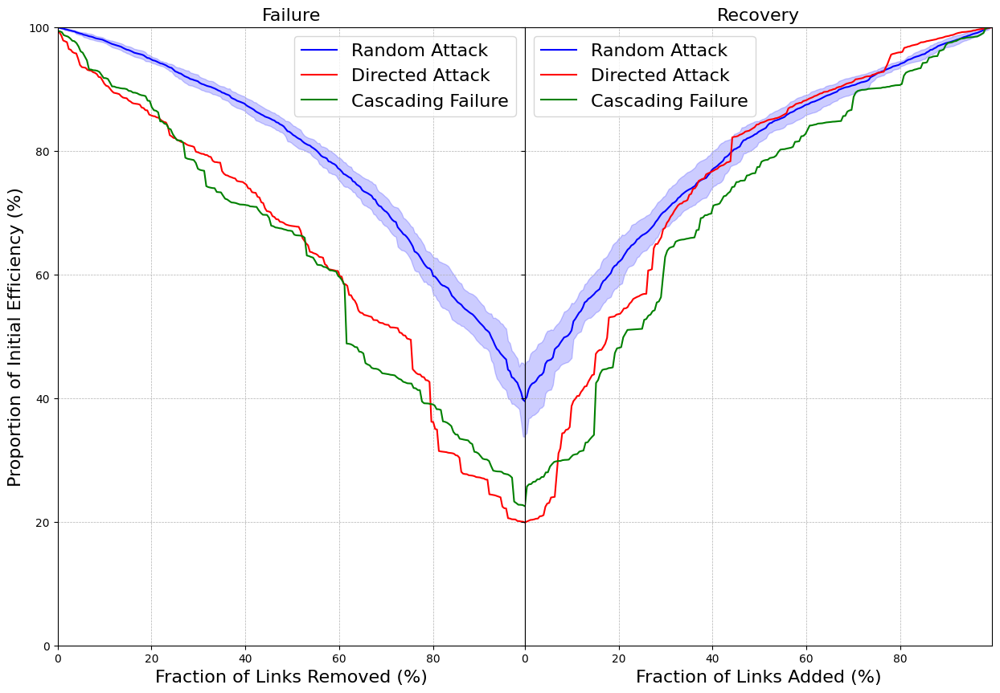

In [397]:
plot_with_shading_eff([(random_edges_to_remove, results_random_edge), 
                   (removed_edges_between,results_after_removal_bw_topo),
                   (edges_removed_cascadin_topo, results_cascading_edge_topo)])

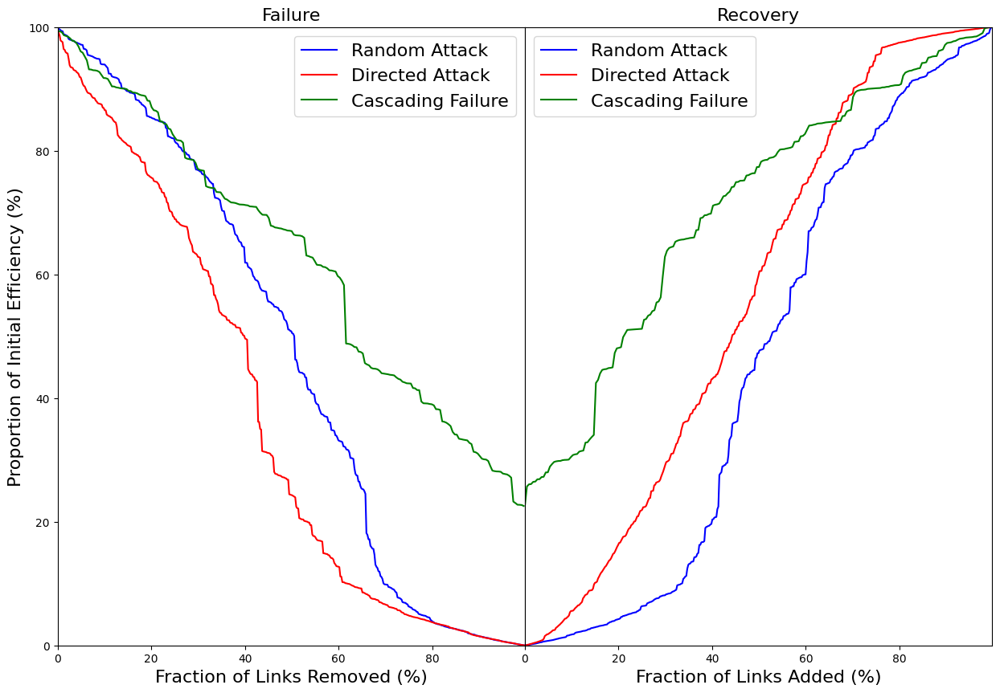

In [213]:
# Use the function like this:
plot_did_comparison([(random_edges_to_remove, results_random_edge), (edges_to_remove_between_topo, results_between_edge),(edges_removed_cascadin_topo, results_cascading_edge_topo)])


#### 组间比较-GCC

In [197]:
def plot_did_comparison1(scenario_data):
    plt.figure(figsize=(15, 10))
    
    colors = ['blue', 'red', 'green', 'purple']
    scenario_names = ['Random Attack','Directed Attack','Cascading Failure']  # Names of scenarios
    
    for idx, (edges_removed, result_table) in enumerate(scenario_data):
        edge_frac = np.arange(len(edges_removed))
        len_edge = len(edge_frac)
        
        # Failure subplot
        plt.subplot(1, 2, 1)
        plt.plot(edge_frac/len_edge*100, result_table.loc[0:len_edge]['gcc']/gcc_init_topo*100, color=colors[idx], label=scenario_names[idx])
        plt.ylim(top=100, bottom=0)  # Adjusted to show percentage
        plt.xlabel('Fraction of Links Removed (%)',size=16)
        plt.ylabel('Relative GCC (%)',size=16)
        plt.title('Failure',size=16)
        plt.legend(fontsize=16)
        plt.margins(x=0, y=0)
        
        # Recovery subplot
        plt.subplot(1, 2, 2)
        plt.plot(edge_frac/len_edge*100, result_table.loc[len_edge:len_edge*2-1]['gcc']/gcc_init_topo*100, color=colors[idx], label=scenario_names[idx])
        plt.ylim(bottom=0, top=100)  # Adjusted to show percentage
        plt.yticks([])
        plt.xlabel('Fraction of Links Added (%)',size=16)
        plt.title('Recovery',size=16)
        plt.legend(fontsize=16)
        plt.margins(x=0, y=0)
        
    plt.subplots_adjust(wspace=0)
    plt.show()


In [399]:
def plot_with_shading_gcc(scenario_data):
    plt.figure(figsize=(15, 10))
    
    colors = ['blue', 'red', 'green', 'purple']
    scenario_names = ['Random Attack', 'Directed Attack', 'Cascading Failure']
    
    for idx, (edges_removed, result_table) in enumerate(scenario_data):
        edge_frac = np.arange(len(edges_removed))
        len_edge = len(edge_frac)
        # Failure subplot
        plt.subplot(1, 2, 1)
        plt.grid(True, which='both', linestyle='--', linewidth=0.5)
        # Add shading only for Random Attack
        if scenario_names[idx] == 'Random Attack':
            plt.plot(edge_frac/len_edge*100, mean_gcc[:len_edge]/gcc_init_topo*100, color=colors[idx], label=scenario_names[idx])
            plt.fill_between(edge_frac/len_edge*100, 
                             (mean_gcc[:len_edge] - std_gcc[:len_edge])/gcc_init_topo*100, 
                             (mean_gcc[:len_edge] + std_gcc[:len_edge])/gcc_init_topo*100, 
                             color=colors[idx], alpha=0.2)
        else:
            plt.plot(edge_frac/len_edge*100, result_table.loc[:len_edge]['gcc']/gcc_init_topo*100, color=colors[idx], label=scenario_names[idx])
        plt.ylim(top=100, bottom=0)  # Adjusted to show percentage
        plt.xlabel('Fraction of Links Removed (%)',size=16)
        plt.ylabel('Relative GCC (%)',size=16)
        plt.title('Failure',size=16)
        plt.legend(fontsize=16)
        plt.margins(x=0, y=0)
        
        # Recovery subplot
        plt.subplot(1, 2, 2)
        plt.grid(True, which='both', linestyle='--', linewidth=0.5)
        ax = plt.gca()  # Get current axis
        ax.set_yticklabels([])  # Remove y-tick labels but keep the ticks
        # Add shading only for Random Attack
        if scenario_names[idx] == 'Random Attack':
            plt.plot(edge_frac/len_edge*100, mean_gcc[len_edge:]/gcc_init_topo*100, color=colors[idx], label=scenario_names[idx])
            plt.fill_between(edge_frac/len_edge*100, 
                             (mean_gcc[len_edge:] - std_gcc[len_edge:])/gcc_init_topo*100, 
                             (mean_gcc[len_edge:] + std_gcc[len_edge:])/gcc_init_topo*100, 
                             color=colors[idx], alpha=0.2)
        else:
            plt.plot(edge_frac/len_edge*100, result_table.loc[len_edge:2*len_edge-1]['gcc']/gcc_init_topo*100, color=colors[idx], label=scenario_names[idx])
        plt.ylim(bottom=0, top=100)  # Adjusted to show percentage
        #plt.yticks([])
        plt.xlabel('Fraction of Links Added (%)',size=16)
        plt.title('Recovery',size=16)
        plt.legend(fontsize=16)
        plt.margins(x=0, y=0)
        
    plt.subplots_adjust(wspace=0)
    plt.show()




/var/folders/t2/rbnfb0fd63x_nzy8bn0_m4x80000gn/T/ipykernel_49265/352996727.py:15: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  plt.plot(edge_frac/len_edge*100, mean_gcc[:len_edge]/gcc_init_topo*100, color=colors[idx], label=scenario_names[idx])
/var/folders/t2/rbnfb0fd63x_nzy8bn0_m4x80000gn/T/ipykernel_49265/352996727.py:17: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  (mean_gcc[:len_edge] - std_gcc[:len_edge])/gcc_init_topo*100,
/var/folders/t2/rbnfb0fd63x_nzy8bn0_m4x80000gn/T

ValueError: x and y must have same first dimension, but have shapes (224,) and (278,)

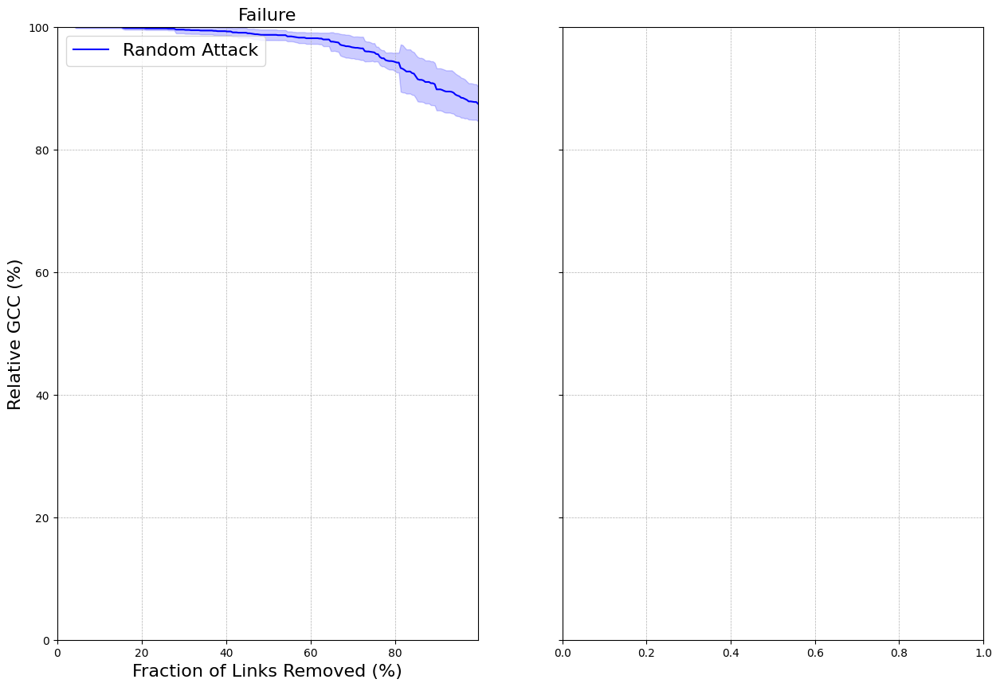

In [409]:
plot_with_shading_gcc([(random_edges_to_remove, results_random_edge), 
                   (removed_edges_between,results_after_removal_bw_topo),
                   (edges_removed_cascadin_topo, results_cascading_edge_topo)])

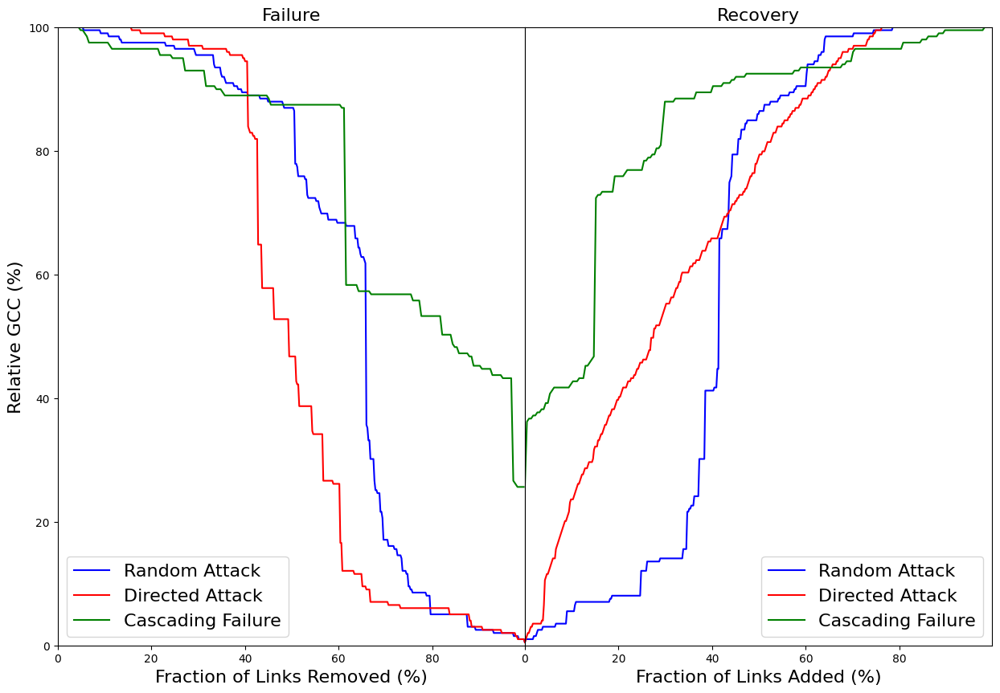

In [214]:

# Use the function like this:
plot_did_comparison1([(random_edges_to_remove, results_random_edge), (edges_to_remove_between_topo, results_between_edge),(edges_removed_cascadin_topo, results_cascading_edge_topo)])


#### 组间比较-GCC+Eff

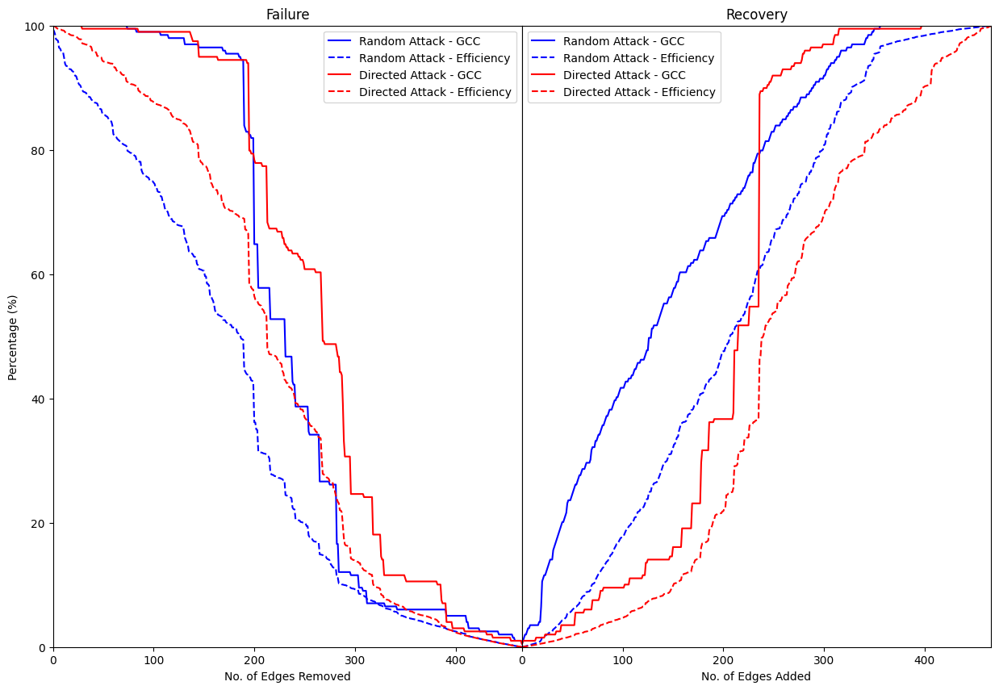

In [57]:
def plot_did_comparison2(scenario_data):
    plt.figure(figsize=(15, 10))
    
    colors = ['blue', 'red', 'green', 'purple']
    scenario_names = ['Random Attack', 'Directed Attack']  # Names of scenarios
    
    for idx, (edges_removed, result_table) in enumerate(scenario_data):
        edge_frac = np.arange(len(edges_removed))
        len_edge = len(edge_frac)
        
        # Failure subplot
        plt.subplot(1, 2, 1)
        # Plotting GCC
        plt.plot(edge_frac, result_table.loc[0:len_edge]['gcc']/gcc_init_topo*100, color=colors[idx], label=f'{scenario_names[idx]} - GCC')
        # Plotting efficiency (assuming efficiency column exists in the dataframe)
        plt.plot(edge_frac, result_table.loc[0:len_edge]['efficiency']/efficiency_init_topo*100, '--', color=colors[idx], label=f'{scenario_names[idx]} - Efficiency')
        plt.ylim(top=100, bottom=0)
        plt.xlabel('No. of Edges Removed')
        plt.ylabel('Percentage (%)')
        plt.title('Failure')
        plt.legend()
        plt.margins(x=0, y=0)
        
        # Recovery subplot
        plt.subplot(1, 2, 2)
        # Plotting GCC
        plt.plot(edge_frac, result_table.loc[len_edge:len_edge*2-1]['gcc']/gcc_init_topo*100, color=colors[idx], label=f'{scenario_names[idx]} - GCC')
        # Plotting efficiency
        plt.plot(edge_frac, result_table.loc[len_edge:len_edge*2-1]['efficiency']/efficiency_init_topo*100, '--', color=colors[idx], label=f'{scenario_names[idx]} - Efficiency')
        plt.ylim(bottom=0, top=100)
        plt.yticks([])
        plt.xlabel('No. of Edges Added')
        plt.title('Recovery')
        plt.legend()
        plt.margins(x=0, y=0)
        
    plt.subplots_adjust(wspace=0)
    plt.show()

# Use the function:
plot_did_comparison2([(edges_to_remove_between_topo, results_between_edge), (random_edges_to_remove, results_random_edge)])


#### 组内比较

In [384]:
def plot_did_comparison3(edges_removed, result_table):
    edge_frac = np.arange(len(edges_removed))
    len_edge = len(edge_frac)
    
    plt.figure(figsize=(15, 10))
    colors = ['blue', 'red', 'green', 'purple']

    # Failure subplot
    plt.subplot(1, 2, 1)
    plt.plot(edge_frac, result_table.loc[0:len_edge]['gcc']/gcc_init_topo*100, color=colors[0], label='GCC')
    plt.plot(edge_frac, result_table.loc[0:len_edge]['efficiency']/efficiency_init_topo*100, color=colors[1], label='Efficiency')
    plt.ylim(top=100, bottom=0)  # Adjusted the limit to 100 to show percentage
    plt.xlabel('No. of Edges Removed')
    plt.ylabel('Fraction(%)')  # Added % to the label
    plt.title('Failure')
    plt.legend()
    plt.margins(x=0, y=0)

    # Recovery subplot
    plt.subplot(1, 2, 2)
    plt.plot(edge_frac, result_table.loc[len_edge:len_edge*2-1]['gcc']/gcc_init_topo*100, color=colors[0], label='GCC')
    plt.plot(edge_frac, result_table.loc[len_edge:len_edge*2-1]['efficiency']/efficiency_init_topo*100, color=colors[1], label='Efficiency')
    plt.ylim(bottom=0, top=100)  # Adjusted the limit to 100 to show percentage
    plt.yticks([])
    plt.xlabel('No. of Edges Added')
    plt.title('Recovery')
    plt.legend()
    plt.margins(x=0, y=0)

    plt.subplots_adjust(wspace=0)
    plt.show()

# When you want to use the function, call it like this:
# plot_combined_failure_recovery(edges_removed, result_table, gcc_init_topo, efficiency_init_topo)


##### Directed Attack

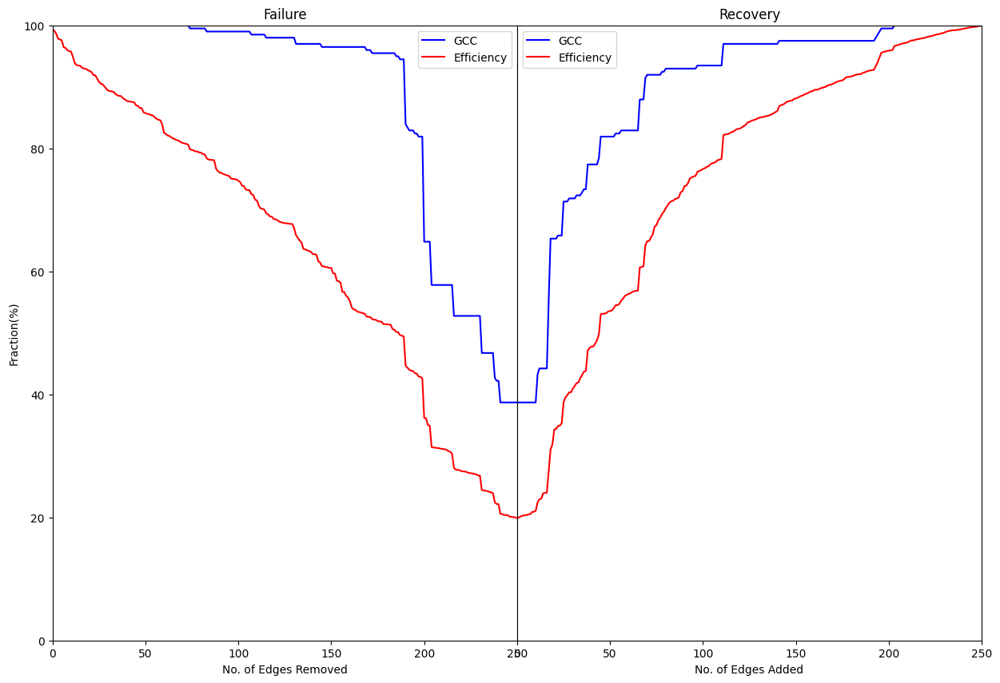

In [389]:
plot_did_comparison3(removed_edges_between,results_after_removal_bw_topo)

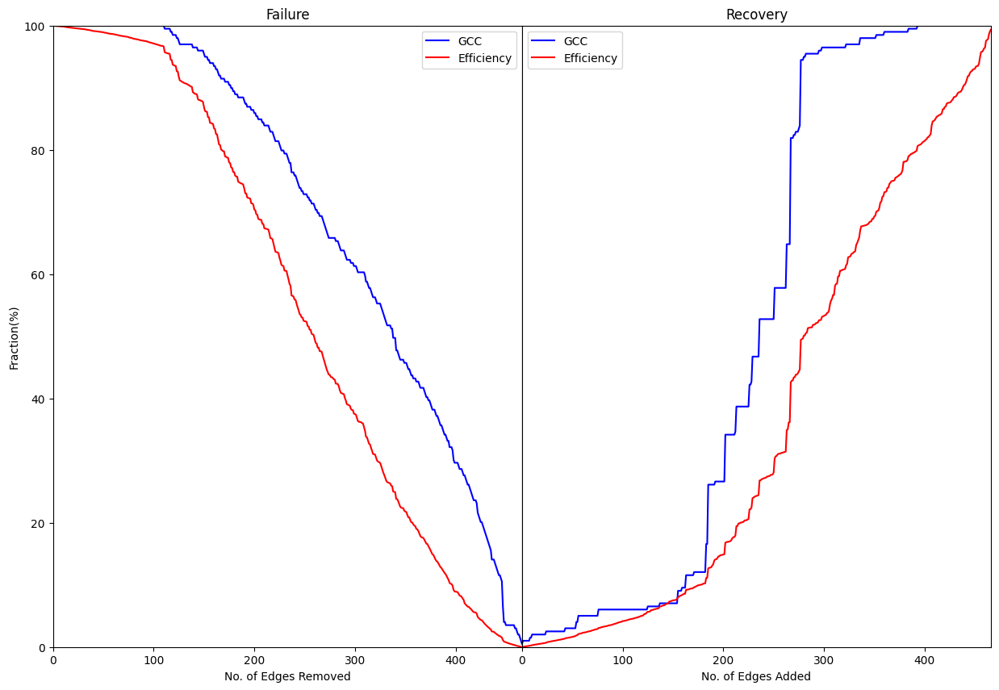

In [60]:
plot_did_comparison3(edges_to_remove_between_topo_a,results_between_edge_a)

##### Random Attack

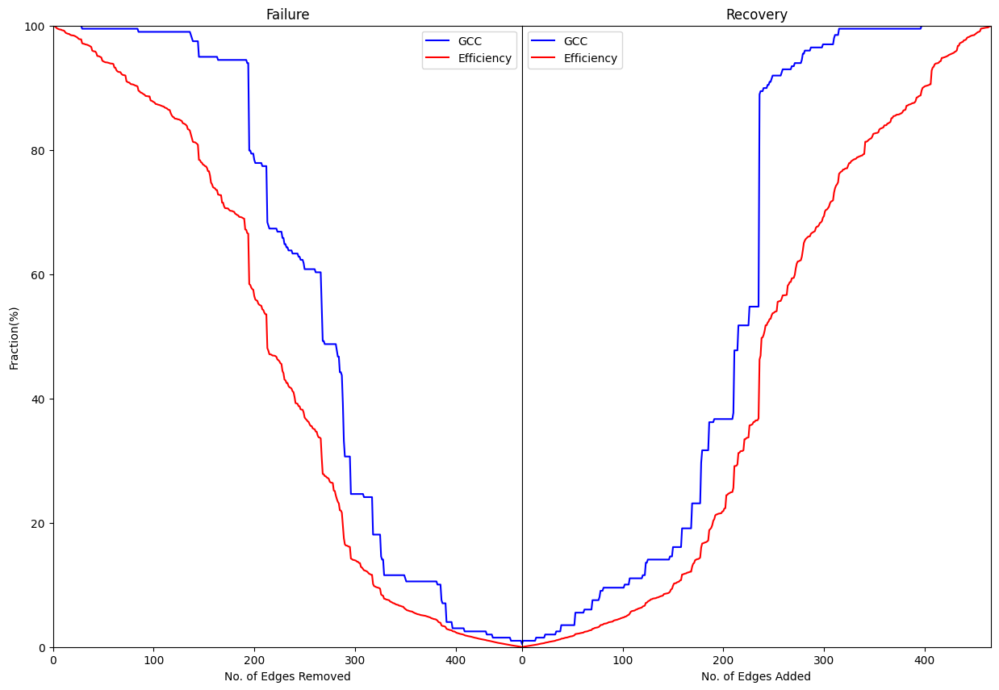

In [61]:
plot_did_comparison3(random_edges_to_remove,results_random_edge)

##### Cascading Failure

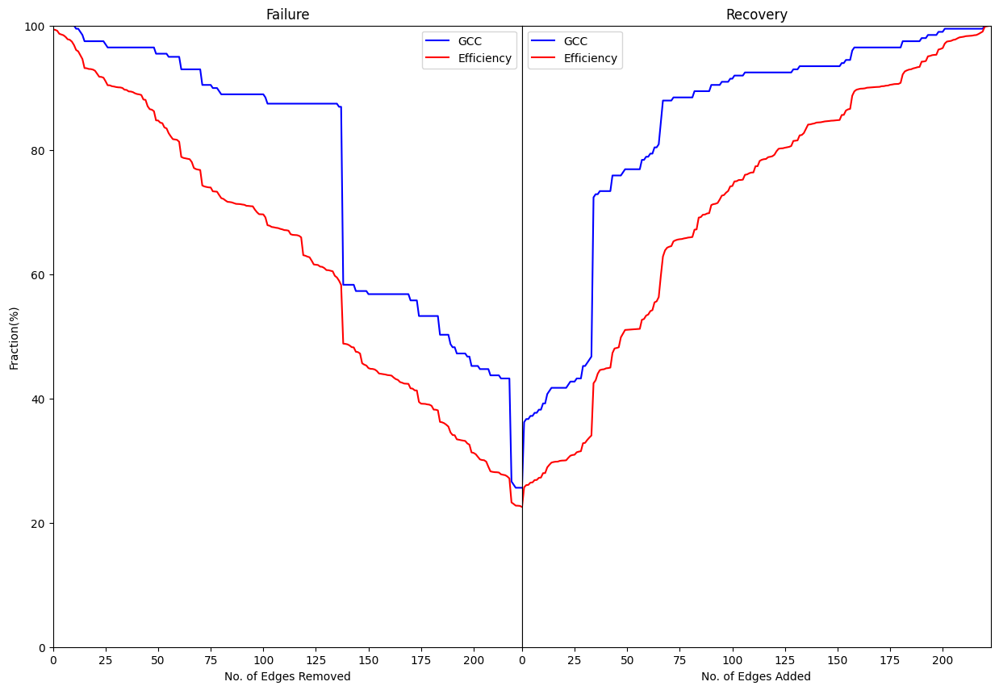

In [62]:
plot_did_comparison3(edges_removed_cascadin_topo,results_cascading_edge_topo)

#### 分区

In [63]:
def plot_did_comparison_areas(edges_removed, result_table, x, eff_init, gcc_init):
    edge_frac = np.arange(len(edges_removed))
    len_edge = len(edge_frac)
    
    plt.figure(figsize=(15, 10))
    colors = ['blue', 'red', 'green', 'purple']

    threshold_eff = x * eff_init / 100
    threshold_gcc = x * gcc_init / 100
    
    # Finding the points where efficiency and gcc cross the threshold
    t0_gcc = result_table[result_table['gcc'] < threshold_gcc].index.min()
    t1_gcc = result_table[(result_table['gcc'] > threshold_gcc) & (result_table.index > t0_gcc)].index.min()

    t0_eff = result_table[result_table['efficiency'] < threshold_eff].index.min()
    t1_eff = result_table[(result_table['efficiency'] > threshold_eff) & (result_table.index > t0_eff)].index.min()

    # Failure subplot
    plt.subplot(1, 2, 1)
    plt.plot(edge_frac, result_table.loc[0:len_edge]['gcc']/gcc_init*100, color=colors[0], label='GCC')
    plt.plot(edge_frac, result_table.loc[0:len_edge]['efficiency']/eff_init*100, '--', color=colors[1], label='Efficiency')
    plt.axvline(x=t0_gcc, color=colors[0], linestyle='-.', alpha=0.5)
    plt.axvline(x=t0_eff, color=colors[1], linestyle='-.', alpha=0.5)
    plt.ylim(top=100, bottom=0)
    plt.xlabel('No. of Edges Removed')
    plt.ylabel('Fraction(%)')
    plt.title('Failure')
    plt.legend()

    # Recovery subplot
    plt.subplot(1, 2, 2)
    plt.plot(edge_frac, result_table.loc[len_edge:len_edge*2-1]['gcc']/gcc_init_topo*100, color=colors[0], label='GCC')
    plt.plot(edge_frac, result_table.loc[len_edge:len_edge*2-1]['efficiency']/efficiency_init_topo*100, '--', color=colors[1], label='Efficiency')
    plt.plot(edge_frac, result_table.loc[len_edge:len_edge*2-1]['gcc']/gcc_init*100, color=colors[0], label='GCC')
    plt.plot(edge_frac, result_table.loc[len_edge:len_edge*2-1]['efficiency']/eff_init*100, '--', color=colors[1], label='Efficiency')
    plt.axvline(x=t1_gcc - len_edge, color=colors[0], linestyle='-.', alpha=0.5)  # Corrected x-coordinate
    plt.axvline(x=t1_eff - len_edge, color=colors[1], linestyle='-.', alpha=0.5)  # Corrected x-coordinate
    plt.ylim(bottom=0, top=100)  # Adjusted the limit to 100 to show percentage
    plt.yticks([])
    plt.xlabel('No. of Edges Added')
    plt.title('Recovery')
    plt.legend()
    plt.margins(x=0, y=0)
    
    plt.subplots_adjust(wspace=0)  # Adjusting the space between plots for clarity
    plt.show()
    


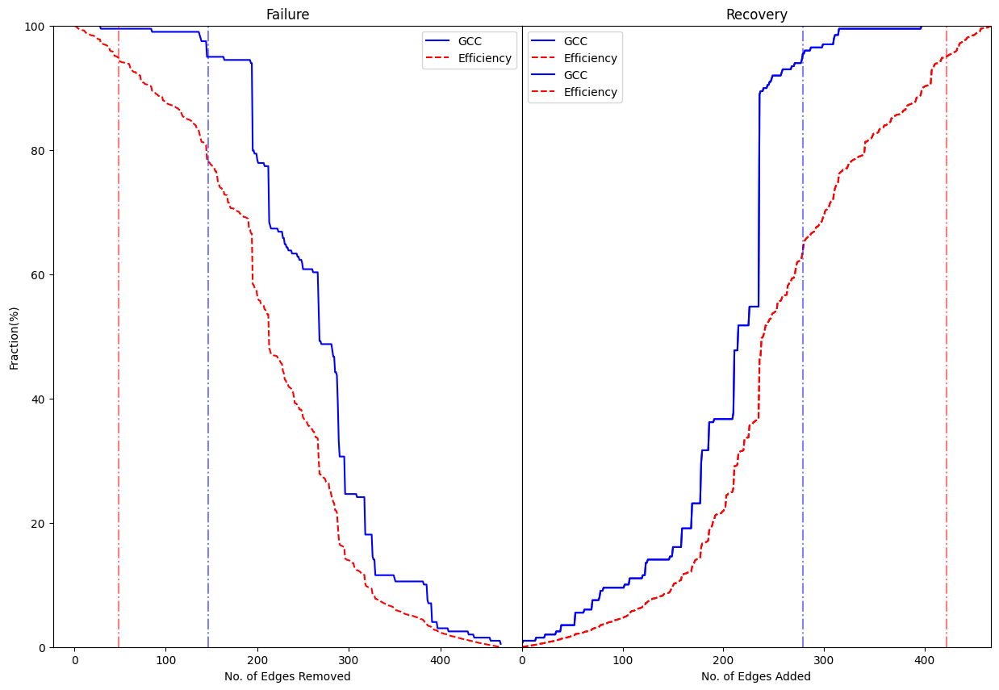

In [64]:
plot_did_comparison_areas(random_edges_to_remove,results_random_edge,95,efficiency_init_topo,gcc_init_topo)

#### 组内比较-突出点

In [204]:
def plot_comparison3_with_highlights(edges_removed, result_table, threshold=5):
    edge_frac = np.arange(len(edges_removed))
    len_edge = len(edge_frac)

    # Split the result table into failure and recovery phases
    failure_data = result_table.iloc[:len_edge]
    recovery_data = result_table.iloc[len_edge:2*len_edge]

    # Calculate the derivatives for FAILURE phase
    gcc_derivative_failure = np.diff(failure_data['gcc'].values) / np.diff(edge_frac)
    efficiency_derivative_failure = np.diff(failure_data['efficiency'].values) / np.diff(edge_frac)
    
    # Identify points where the change in the derivatives exceeds the threshold for FAILURE phase
    gcc_change_points_failure = np.where(np.abs(gcc_derivative_failure) > threshold)[0]
    efficiency_change_points_failure = np.where(np.abs(efficiency_derivative_failure) > threshold)[0]

    # Calculate the derivatives for RECOVERY phase
    gcc_derivative_recovery = np.diff(recovery_data['gcc'].values) / np.diff(edge_frac)
    efficiency_derivative_recovery = np.diff(recovery_data['efficiency'].values) / np.diff(edge_frac)
    
    # Identify points where the change in the derivatives exceeds the threshold for RECOVERY phase
    gcc_change_points_recovery = np.where(np.abs(gcc_derivative_recovery) > threshold)[0]
    efficiency_change_points_recovery = np.where(np.abs(efficiency_derivative_recovery) > threshold)[0]

    # Plotting
    plt.figure(figsize=(15, 10))
    colors = ['blue', 'red']

    # Failure subplot
    plt.subplot(1, 2, 1)
    plt.plot(edge_frac, failure_data['gcc']/gcc_init_topo*100, color=colors[0], label='GCC')
    plt.plot(edge_frac, failure_data['efficiency']/efficiency_init_topo*100, '--', color=colors[1], label='Efficiency')
    plt.scatter(gcc_change_points_failure, failure_data['gcc'].iloc[gcc_change_points_failure]/gcc_init_topo*100, c='#8adf3f', marker='o')
    plt.scatter(efficiency_change_points_failure, failure_data['efficiency'].iloc[efficiency_change_points_failure]/efficiency_init_topo*100, c='blue', marker='x')
    plt.ylim(top=100, bottom=0)  # Adjusted the limit to 100 to show percentage
    plt.xlabel('No. of Edges Removed')
    plt.ylabel('Fraction(%)')  # Added % to the label
    plt.title('Failure')
    plt.legend()
    plt.margins(x=0, y=0)

    # Recovery subplot
    plt.subplot(1, 2, 2)
    plt.plot(edge_frac, recovery_data['gcc']/gcc_init_topo*100, color=colors[0], label='GCC')
    plt.plot(edge_frac, recovery_data['efficiency']/efficiency_init_topo*100, '--', color=colors[1], label='Efficiency')
    plt.scatter(gcc_change_points_recovery, recovery_data['gcc'].iloc[gcc_change_points_recovery]/gcc_init_topo*100, c='#8adf3f', marker='o')
    plt.scatter(efficiency_change_points_recovery, recovery_data['efficiency'].iloc[efficiency_change_points_recovery]/efficiency_init_topo*100, c='blue', marker='x')
    plt.ylim(bottom=0, top=100)  # Adjusted the limit to 100 to show percentage
    plt.yticks([])
    plt.xlabel('No. of Edges Added')
    plt.title('Recovery')
    plt.legend()
    plt.margins(x=0, y=0)
    
    plt.subplots_adjust(wspace=0)  # Adjusting the space between plots for clarity
    plt.show()

    return gcc_change_points_failure,gcc_change_points_recovery

# You can use the function as:
# plot_comparison_with_highlights(edges_to_remove_between_topo, results_between_edge)


##### Random Attack

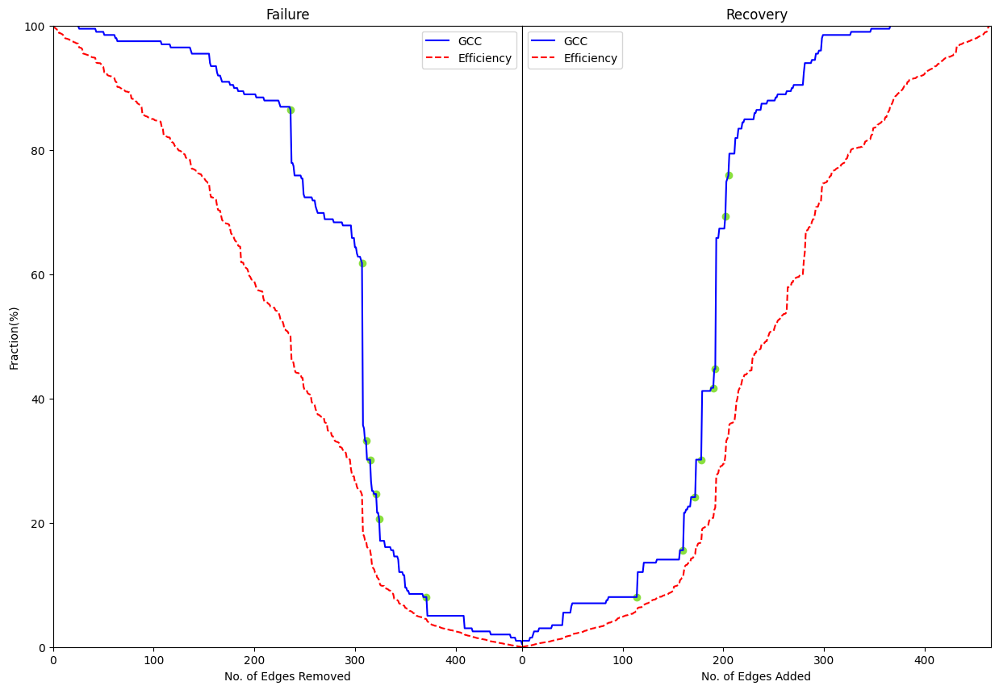

In [240]:
ra_points = plot_comparison3_with_highlights(random_edges_to_remove,results_random_edge)

In [220]:
ra_points

(array([236, 307, 311, 315, 321, 324, 371]),
 array([114, 160, 172, 178, 190, 192, 202, 205]))

In [222]:
results_random_edge.iloc[236]

removal       (广平县_130432, 馆陶县_130433)
gcc                                172
efficiency                    0.097863
Name: 237, dtype: object

In [223]:
results_random_edge.iloc[307]

removal       (香河县_131024, 大厂回族自治县_131028)
gcc                                    123
efficiency                         0.04795
Name: 308, dtype: object

In [224]:
results_random_edge.iloc[178+len(random_edges_to_remove)]

removal       [河间市_130984, 沧县_130921]
gcc                                60
efficiency                   0.032978
Name: 646, dtype: object

In [225]:
results_random_edge.iloc[192+len(random_edges_to_remove)]

removal       [藁城区_130109, 长安区_130102]
gcc                                 89
efficiency                    0.043914
Name: 660, dtype: object

In [72]:
results_random_edge

,removal,gcc,efficiency
1,"(红桥区_120106, 南开区_120104)",199,0.195602
2,"(新乐市_130184, 正定县_130123)",199,0.195449
3,"(南和区_130506, 任泽区_130505)",199,0.195396
4,"(临城县_130522, 内丘县_130523)",199,0.195092
5,"(怀柔区_110116, 丰宁满族自治县_130826)",199,0.194766
...,...,...,...
930,"[崇礼区_130709, 桥西区_130703]",199,0.195051
931,"[宣化区_130705, 阳原县_130727]",199,0.195310
932,"[藁城区_130109, 裕华区_130108]",199,0.195417
933,"[广阳区_131003, 永清县_131023]",199,0.195482


##### Directed Attack

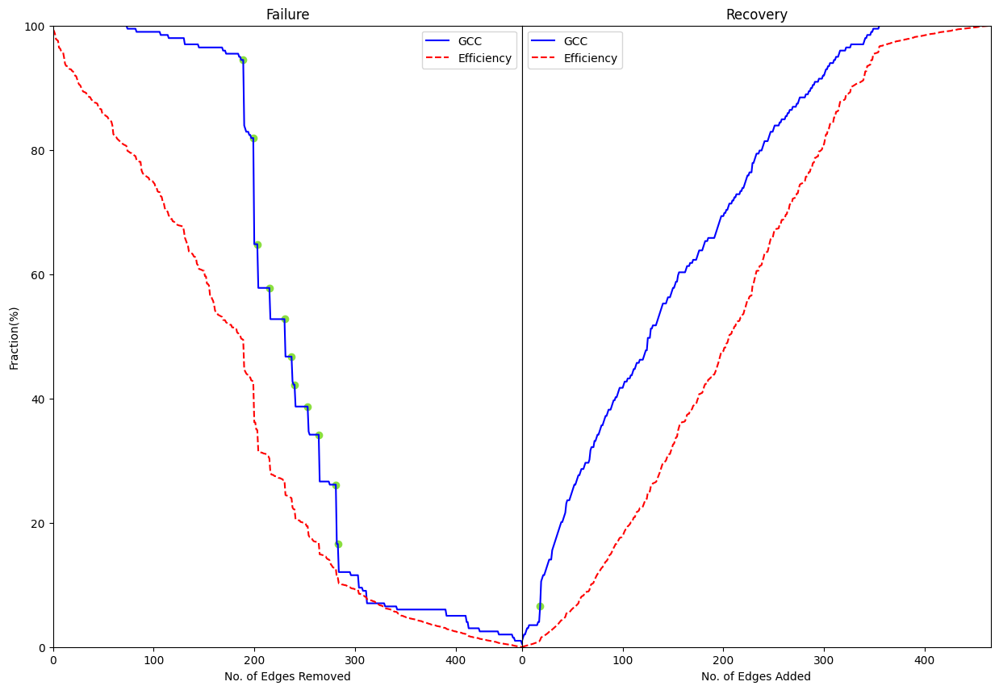

In [207]:
da_points = plot_comparison3_with_highlights(edges_to_remove_between_topo,results_between_edge)

In [74]:
da_points

(array([189, 199, 203, 215, 230, 237, 240, 253, 264, 281, 283]), array([18]))

In [208]:
da_points_incremented = tuple(arr + 1 for arr in da_points)
da_points_incremented

(array([190, 200, 204, 216, 231, 238, 241, 254, 265, 282, 284]), array([19]))

In [378]:
results_between_edge.loc[180:200]

,removal,gcc,efficiency
180,"(任丘市_130982, 河间市_130984)",190,0.100601
181,"(魏县_130434, 广平县_130432)",190,0.100575
182,"(香河县_131024, 武清区_120114)",190,0.100483
183,"(峰峰矿区_130406, 武安市_130481)",190,0.100387
184,"(涿州市_130681, 固安县_131022)",190,0.098987
185,"(广阳区_131003, 固安县_131022)",190,0.098830
186,"(黄骅市_130983, 海兴县_130924)",189,0.098122
187,"(高碑店市_130684, 容城县_130629)",189,0.098034
188,"(饶阳县_131124, 深州市_131182)",188,0.097091
189,"(新乐市_130184, 藁城区_130109)",188,0.096925


In [416]:
results_between_edge.iloc[190]

removal       (襄都区_130502, 内丘县_130523)
gcc                                167
efficiency                    0.087383
Name: 191, dtype: object

In [417]:
results_between_edge.iloc[199+1]

removal       (深泽县_130128, 安平县_131125)
gcc                                129
efficiency                    0.070759
Name: 201, dtype: object

In [418]:
results_between_edge.iloc[281+1]

removal       (门头沟区_110109, 石景山区_110107)
gcc                                   33
efficiency                      0.021809
Name: 283, dtype: object

In [419]:
results_between_edge.iloc[18+1+len(edges_to_remove_between_topo)]

removal       [南宫市_130581, 巨鹿县_130529]
gcc                                 21
efficiency                    0.002997
Name: 487, dtype: object

##### Cascading Failure

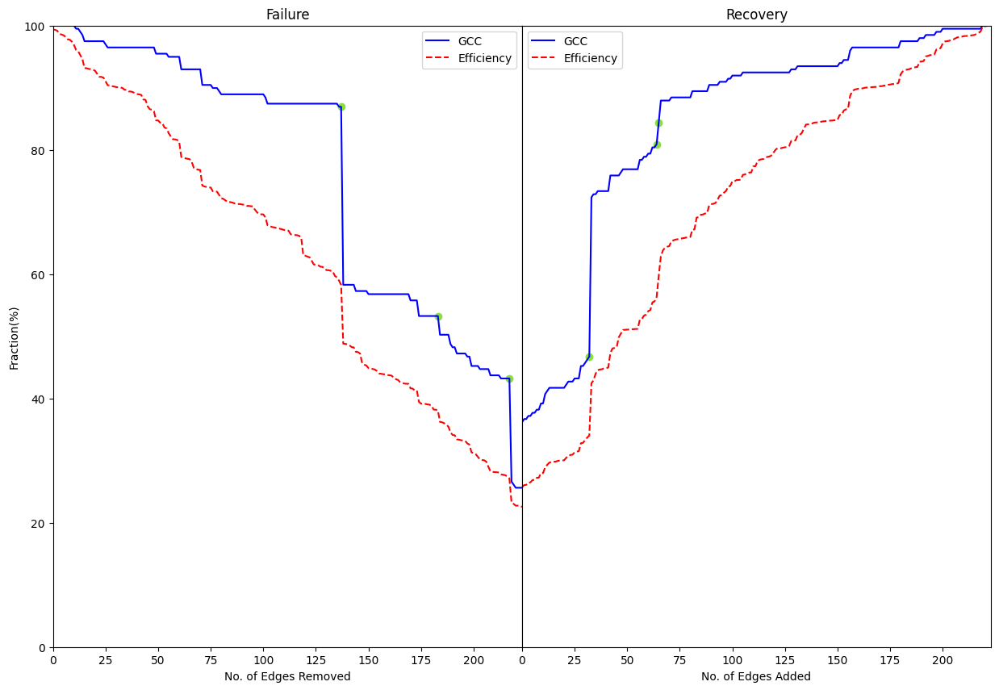

In [209]:
cf_points = plot_comparison3_with_highlights(edges_removed_cascadin_topo,results_cascading_edge_topo)

In [80]:
cf_points

(array([137, 183, 217]), array([32, 64, 65]))

In [210]:
cf_points_incremented = tuple(arr + 1 for arr in cf_points)
cf_points_incremented

(array([138, 184, 218]), array([33, 65, 66]))

In [420]:
results_cascading_edge_topo.iloc[137+1]

removal       (行唐县_130125, 灵寿县_130126)
gcc                                116
efficiency                    0.095515
Name: 139, dtype: object

In [421]:
results_cascading_edge_topo.iloc[217+1]

removal       (青龙满族自治县_130321, 宽城满族自治县_130827)
gcc                                         53
efficiency                             0.04551
Name: 219, dtype: object

In [422]:
results_cascading_edge_topo.iloc[32+1+len(edges_removed_cascadin_topo)]

removal       [博野县_130637, 安国市_130683]
gcc                                144
efficiency                    0.083028
Name: 258, dtype: object

## 找重要点图像

In [201]:
from copy import deepcopy
def copy_graph_failure(graph, edges_to_remove, change_points=None):
    
    # Create a dictionary to store graph copies at specific indices
    graphs_at_change_points = {}
    
    # Use the first array from change_points if it's not None
    flat_change_points = []
    if change_points is not None:
        flat_change_points.extend(change_points[0].tolist())  # <-- Here, using the first array
    
    i = 0
    for edge in edges_to_remove:
        # If flat_change_points is not empty and the current index is in flat_change_points
        if flat_change_points and i in flat_change_points:
            graphs_at_change_points[i] = deepcopy(graph)
        graph.remove_edge(edge[0], edge[1])
        i += 1

    return graphs_at_change_points


def copy_graph_recovery(graph, edges_to_add, change_points=None):
    
    # Create a dictionary to store graph copies at specific indices
    graphs_at_change_points = {}
    
    # Use the second array from change_points if it's not None
    flat_change_points = []
    if change_points is not None:
        flat_change_points.extend(change_points[1].tolist())  # <-- Here, using the second array
    
    edges_to_add_array = np.array(edges_to_add, dtype=object)
    
    i = 0
    for edge in edges_to_add_array:
        # If flat_change_points is not empty and the current index is in flat_change_points
        if flat_change_points and i in flat_change_points:
            graphs_at_change_points[i] = deepcopy(graph)
        graph.add_edge(edge[0], edge[1])
        i += 1

    return graphs_at_change_points



In [308]:
from copy import deepcopy

def copy_graph(graph, edges_to_remove, change_points=None):
    """
    For each edge in edges_to_remove, remove it from the graph. 
    If the edge's index is in change_points, make a deep copy of the graph.
    
    Parameters:
    - graph: The initial graph.
    - edges_to_remove: List of edges to be removed from the graph.
    - change_points: List of indices at which we need to copy the graph.
    
    Returns:
    - Dictionary with copied graphs at change points as keys. Each entry is a tuple of (copied graph, edge).
    """
    
    graphs_at_change_points = {}
    
    for i, edge in enumerate(edges_to_remove):
        # If change_points is specified and the current index is a change point
        if change_points is not None and i in change_points:
            graphs_at_change_points[i] = (deepcopy(graph), edge)

        graph.remove_edge(edge[0], edge[1])
        i += 1
    return graphs_at_change_points


In [53]:
import matplotlib.colors as mcolors
def get_variable_name(var):
    for variable_name, variable_value in globals().items():
        if var is variable_value:
            return variable_name
    return None

In [54]:
def plot_two_layered_graphs(original_graph, modified_graph,ax=None):
    """
    Plot two graphs layered on each other. The original graph is at the bottom 
    and the graph with marked edges is on top.
    """
    #if ax is None:
    #    fig, ax = plt.subplots(figsize=(5, 5))

    
    # Plot the graph with the specified font
    fig, ax = plt.subplots(figsize=(10, 8))
    ax.set_facecolor('white')
    ax.axis('off')  # Turn off the frame
    fig.patch.set_alpha(0.0)  # Set figure background to transparent
    ax.patch.set_alpha(0.0)
    pos = nx.get_node_attributes(original_graph, 'coordinates')  # Use coordinates for layout

    # Get degrees of each node for node size and color
    degrees = [d for n, d in modified_graph.degree()]
    #node_sizes = [(d / max(degrees) * 50 + 10) for d in degrees]
    node_colors = degrees

    # Plot original graph at the bottom layer with some transparency
    #nx.draw_networkx_nodes(original_graph, pos, node_size=node_sizes, node_color=node_colors, cmap=plt.cm.YlOrRd)
    nx.draw_networkx_edges(original_graph, pos, edge_color='grey', style='dashed',width=2)
    
    # Plot modified graph at the top layer with marked edges
    nx.draw_networkx_edges(modified_graph, pos, width=2)
    nx.draw_networkx_nodes(modified_graph, pos, node_size=30, node_color=node_colors, cmap=plt.cm.YlOrRd)

    # Add colorbar
    cax = fig.add_axes([0.6, 0.25, 0.15, 0.03])
    node_colorbar = plt.colorbar(plt.cm.ScalarMappable(cmap=plt.cm.YlOrRd, 
                            norm=plt.Normalize(vmin=min(node_colors), vmax=max(node_colors))), cax=cax, orientation='horizontal')

    # Set tick labels to start, middle, end with two-digit decimals
    min_val, max_val = min(node_colors), max(node_colors)
    middle_val = (min_val + max_val) / 2
    node_colorbar.set_ticks([min_val, middle_val, max_val])
    #node_colorbar.set_ticklabels([f"{min_val:.f}", f"{middle_val:.0f}", f"{max_val:.2f}"])
    node_colorbar.set_label('Node Degree',labelpad = -50)
    variable_name = get_variable_name(modified_graph)
    if variable_name:
        plt.savefig(f'{variable_name}.png',dpi=300 ,bbox_inches='tight', pad_inches=0.1, transparent=True)
    plt.show()
    plt.show()


In [55]:
from pypinyin import lazy_pinyin
import matplotlib.colors as mcolors
def plot_two_layered_graphs_between(original_graph, modified_graph,specific_link_nodes):
    """
    Plot two graphs layered on each other. The original graph is at the bottom 
    and the graph with marked edges is on top.
    """
    
    fig, ax = plt.subplots(figsize=(10, 8))
    ax.set_facecolor('white')
    ax.axis('off')  # Turn off the frame
    fig.patch.set_alpha(0.0)  # Set figure background to transparent
    ax.patch.set_alpha(0.0)
    pos = nx.get_node_attributes(original_graph, 'coordinates')  # Use coordinates for layout

    # Get degrees of each node for node size and color
    degrees = [d for n, d in modified_graph.degree()]
    #node_sizes = [(d / max(degrees) * 50 + 10) for d in degrees]
    # Create a custom colormap
    colors = [(0.5, 0.5, 0.5)] + [plt.cm.YlOrRd(i) for i in np.linspace(0, 1, 255)]
    custom_colormap = mcolors.LinearSegmentedColormap.from_list("custom", colors, N=256)

    # Normalize the degrees for colormap
    norm = plt.Normalize(vmin=0, vmax=max(degrees))
    node_colors_rgb = [custom_colormap(norm(d)) for d in degrees]

    # Plot original graph at the bottom layer with some transparency
    nx.draw_networkx_edges(original_graph, pos, edge_color='grey', style='dashed', width=1)
    
    # Calculate edge betweenness centrality for the modified graph
    edge_betweenness = nx.edge_betweenness_centrality(modified_graph)
    # Get edge widths and colors based on betweenness centrality
    edge_widths = [edge_betweenness[edge] * 3 + 1.5 for edge in modified_graph.edges()]  # Multiply by 10 for better visualization
    edge_colors = [edge_betweenness[edge] for edge in modified_graph.edges()]

    start = 0.5  # Start from the midpoint of BuPu
    stop = 1.0  # End at the darkest color
    colors = plt.cm.BuPu(np.linspace(start, stop, 256))
    custom_BuPu = mcolors.LinearSegmentedColormap.from_list('custom_BuPu', colors)

    # Plot modified graph at the top layer with marked edges
    specific_link = tuple(specific_link_nodes)
    nx.draw_networkx_edges(modified_graph, pos, edgelist=[specific_link], edge_color='red', width=2.5)
    # Label the two nodes of the specific link
    # Get all node labels from the graph
    all_node_labels = nx.get_node_attributes(modified_graph, 'city_name')

    # Extract labels for the two nodes of the specific link
    node_labels = {node: ''.join(lazy_pinyin(all_node_labels[node])) for node in specific_link if node in all_node_labels}
    #nx.draw_networkx_labels(modified_graph, pos, labels=node_labels, font_size=10, font_color='black', alpha=0.7)
    #specific_link_width = edge_betweenness[specific_link] * 3 + 1.5
    nx.draw_networkx_edges(modified_graph, pos, width=edge_widths, edge_color=edge_colors, edge_cmap=custom_BuPu)
    nx.draw_networkx_nodes(modified_graph, pos, node_size=30, node_color=node_colors_rgb, cmap=plt.cm.YlOrRd)
    nx.draw_networkx_edges(modified_graph, pos, edgelist=[specific_link], edge_color='#8adf3f', width=2.5)
    # Add colorbar for edges
    # Create new axes for colorbar
    cax = fig.add_axes([0.6, 0.2, 0.15, 0.03])
    edge_colorbar = plt.colorbar(plt.cm.ScalarMappable(cmap=custom_BuPu, 
                            norm=plt.Normalize(vmin=min(edge_colors), vmax=max(edge_colors))), cax=cax, orientation='horizontal')

    # Set tick labels to start, middle, end with two-digit decimals
    min_val, max_val = min(edge_colors), max(edge_colors)
    middle_val = (min_val + max_val) / 2
    edge_colorbar.set_ticks([min_val, middle_val, max_val])
    edge_colorbar.set_ticklabels([f"{min_val:.2f}", f"{middle_val:.2f}", f"{max_val:.2f}"])
    edge_colorbar.outline.set_edgecolor('none')
    edge_colorbar.set_label('Link Betweenness Centrality',labelpad = -50)
   
    # Create new axes for node colorbar
    cax_nodes = fig.add_axes([0.6, 0.3, 0.15, 0.03])
    node_colorbar = plt.colorbar(plt.cm.ScalarMappable(cmap=custom_colormap, 
                            norm=norm), cax=cax_nodes, orientation='horizontal')

    # Set tick labels to start, middle, end
    min_degree, max_degree = 0, max(degrees)
    middle_degree = max_degree // 2
    node_colorbar.set_ticks([min_degree, middle_degree, max_degree])
    node_colorbar.set_ticklabels([min_degree, middle_degree, max_degree])
    node_colorbar.outline.set_edgecolor('none')
    node_colorbar.set_label('Node Degree', labelpad=-50)
    
    # Save the plot
    variable_name = get_variable_name(modified_graph)
    if variable_name:
        plt.savefig(f'plots/{variable_name}.png',dpi=300 ,bbox_inches='tight', pad_inches=0.1, transparent=False)
    plt.show()

# Example of usage:
# plot_two_layered_graphs(original_graph, modified_graph)


DA

In [211]:
graph_between_edge_points = graph.copy()
graph_between_points_f = copy_graph_failure(graph_between_edge_points, edges_to_remove_between_topo ,da_points_incremented)
graph_between_points_r = copy_graph_recovery(graph_between_edge_points, edges_to_remove_between_topo,da_points_incremented)

In [412]:
graph_between_points_f

{190: <networkx.classes.graph.Graph at 0x7f82d7e36320>,
 200: <networkx.classes.graph.Graph at 0x7f82d7e340a0>,
 204: <networkx.classes.graph.Graph at 0x7f82e586f1f0>,
 216: <networkx.classes.graph.Graph at 0x7f82e74303d0>,
 231: <networkx.classes.graph.Graph at 0x7f82d51148e0>,
 238: <networkx.classes.graph.Graph at 0x7f82d7e37910>,
 241: <networkx.classes.graph.Graph at 0x7f82d7e34e80>,
 254: <networkx.classes.graph.Graph at 0x7f82d7e34310>,
 265: <networkx.classes.graph.Graph at 0x7f82d7e34c70>,
 282: <networkx.classes.graph.Graph at 0x7f82c9ba5900>,
 284: <networkx.classes.graph.Graph at 0x7f82e3b6dcc0>}

In [413]:
graph_between_points_r

{19: <networkx.classes.graph.Graph at 0x7f82d7e35b40>}

In [212]:
graph_between_point_f_189 = graph_between_points_f[189+1]
graph_between_point_f_199 = graph_between_points_f[199+1]
graph_between_point_f_281 = graph_between_points_f[281+1]
graph_between_point_r_18 = graph_between_points_r[18+1]

In [403]:
results_between_edge.iloc[189+1]

removal       (襄都区_130502, 内丘县_130523)
gcc                                167
efficiency                    0.087383
Name: 191, dtype: object

In [213]:
between_link_topo_189 = results_between_edge.iloc[189+1]['removal']
#plot_two_layered_graphs_between(graph,graph_between_point_f_189,between_link_topo_189)
between_link_topo_199= results_between_edge.iloc[199+1]['removal']
#plot_two_layered_graphs_between(graph,graph_between_point_f_199,between_link_topo_199)
between_link_topo_281= results_between_edge.iloc[281+1]['removal']
#plot_two_layered_graphs_between(graph,graph_between_point_f_281,between_link_topo_281)
between_link_topo_r_18 = results_between_edge.iloc[18+1+len(edges_to_remove_between_topo)]['removal']
#plot_two_layered_graphs_between(graph,graph_between_point_r_18,between_link_topo_r_18)

In [214]:
da_links = [between_link_topo_189,between_link_topo_199,between_link_topo_281,between_link_topo_r_18]

CF

In [215]:
graph_cascading_edge_points = graph.copy()
graph_cascading_points_f = copy_graph_failure(graph_cascading_edge_points, edges_removed_cascadin_topo,cf_points_incremented)
graph_cascading_points_r = copy_graph_recovery(graph_cascading_edge_points, edges_removed_cascadin_topo,cf_points_incremented)

In [406]:
graph_cascading_points_f

{138: <networkx.classes.graph.Graph at 0x7f82e687e9b0>,
 184: <networkx.classes.graph.Graph at 0x7f82e8432b00>,
 218: <networkx.classes.graph.Graph at 0x7f82e687d450>}

In [407]:
graph_cascading_points_r

{33: <networkx.classes.graph.Graph at 0x7f82e687c3a0>,
 65: <networkx.classes.graph.Graph at 0x7f82e5d268f0>,
 66: <networkx.classes.graph.Graph at 0x7f82e8432c50>}

In [216]:
graph_cascading_point_f_137 = graph_cascading_points_f[137+1]
graph_cascading_point_f_217 = graph_cascading_points_f[217+1]
graph_cascading_point_r_32 = graph_cascading_points_r[32+1]
graph_cascading_point_r_64 = graph_cascading_points_r[64+1]

In [394]:
results_cascading_edge_topo.iloc[137+1]

removal       (行唐县_130125, 灵寿县_130126)
gcc                                116
efficiency                    0.095515
Name: 139, dtype: object

In [393]:
results_cascading_edge_topo.loc[135:140]

,removal,gcc,efficiency
135,"(宁河区_120117, 武清区_120114)",174,0.116872
136,"(武清区_120114, 通州区_110112)",174,0.116338
137,"(深泽县_130128, 无极县_130130)",173,0.115333
138,"(新乐市_130184, 行唐县_130125)",173,0.113981
139,"(行唐县_130125, 灵寿县_130126)",116,0.095515
140,"(灵寿县_130126, 正定县_130123)",116,0.095428


In [227]:
results_cascading_edge_topo.iloc[1+32+len(edges_removed_cascadin_topo)]

removal       [博野县_130637, 安国市_130683]
gcc                                144
efficiency                    0.083028
Name: 258, dtype: object

In [391]:
results_cascading_edge_topo.loc[256:260]

,removal,gcc,efficiency
256,"[高阳县_130628, 蠡县_130635]",92,0.065927
257,"[蠡县_130635, 博野县_130637]",93,0.066595
258,"[博野县_130637, 安国市_130683]",144,0.083028
259,"[安国市_130683, 安平县_131125]",145,0.083985
260,"[安平县_131125, 深州市_131182]",145,0.086048


In [217]:
cascading_link_topo_137 = results_cascading_edge_topo.iloc[137+1]['removal']
#plot_two_layered_graphs_between(graph,graph_cascading_point_f_137,cascading_link_topo_137)
cascading_link_topo_217 = results_cascading_edge_topo.iloc[217+1]['removal']
#plot_two_layered_graphs_between(graph,graph_cascading_point_f_217,cascading_link_topo_217)
cascading_link_topo_r_32 = results_cascading_edge_topo.iloc[32+1+len(edges_removed_cascadin_topo)]['removal']
#plot_two_layered_graphs_between(graph,graph_cascading_point_r_32,cascading_link_topo_r_32)
cascading_link_topo_r_64 = results_cascading_edge_topo.iloc[64+1+len(edges_removed_cascadin_topo)]['removal']
#plot_two_layered_graphs_between(graph,graph_cascading_point_r_64,cascading_link_topo_r_64)

In [228]:
cf_links = [cascading_link_topo_137,cascading_link_topo_217,cascading_link_topo_r_32]

## Resilience index

In [403]:
def calculate_resilience_index_gcc(df, x, y):
    """
    Calculate the resilience index based on the provided dataframe and thresholds.
    
    Parameters:
    - df: A dataframe with 'gcc' representing the size of the largest component.
    - x: The percentage of the original value y to determine t0 and t1.
    - y: The original value.
    
    Returns:
    - Resilience index.
    """
    threshold = x / 100  # Calculate the threshold
    
    # Find t0 and t1
    t0 = df[df['gcc']/y < threshold].index.min()
    t1 = df[(df['gcc']/y > threshold) & (df.index > t0)].index.min()
    
    if pd.isna(t0) or pd.isna(t1):
        return None  # Cannot compute resilience index if either t0 or t1 are not found
    
    # Calculate the resilience index
    Q_integral = df.loc[t0:t1, 'gcc'].sum() / y
    resilience_index = Q_integral / (t1 - t0)
    
    return resilience_index
def calculate_resilience_index_eff(df, x, y):
    """
    Calculate the resilience index based on the provided dataframe and thresholds.
    
    Parameters:
    - df: A dataframe with 'gcc' representing the size of the largest component.
    - x: The percentage of the original value y to determine t0 and t1.
    - y: The original value.
    
    Returns:
    - Resilience index.
    """
    threshold = x / 100  # Calculate the threshold
    
    # Find t0 and t1
    t0 = df[df['efficiency']/y < threshold].index.min()
    t1 = df[(df['efficiency']/y > threshold) & (df.index > t0)].index.min()
    
    if pd.isna(t0) or pd.isna(t1):
        return None  # Cannot compute resilience index if either t0 or t1 are not found
    
    # Calculate the resilience index
    Q_integral = df.loc[t0:t1, 'efficiency'].sum() / y
    resilience_index = Q_integral / (t1 - t0)
    
    return resilience_index



In [404]:
def calculate_mean_resilience_index(all_results, x, y, metric='gcc'):
    """
    Calculate the mean resilience index across multiple repetitions.
    
    Parameters:
    - all_results: A list of dataframes from multiple repetitions.
    - x: The percentage of the original value y to determine t0 and t1.
    - y: The original value.
    - metric: The metric to use ('gcc' or 'efficiency').
    
    Returns:
    - Mean resilience index.
    """
    if metric == 'gcc':
        calculate_resilience = calculate_resilience_index_gcc
    elif metric == 'efficiency':
        calculate_resilience = calculate_resilience_index_eff
    else:
        raise ValueError("Invalid metric. Choose 'gcc' or 'efficiency'.")
    
    # Calculate resilience index for each repetition
    resilience_indices = [calculate_resilience(df, x, y) for df in all_results]
    
    # Filter out None values
    resilience_indices = [ri for ri in resilience_indices if ri is not None]
    
    # Check if there are valid resilience indices
    if not resilience_indices:
        return None  # Return None if no valid resilience indices
    
    # Calculate the mean resilience index
    mean_resilience_index = sum(resilience_indices) / len(resilience_indices)
    
    return mean_resilience_index


In [322]:
calculate_resilience_index_gcc(results_between_edge,99,gcc_init_topo)

False

In [362]:
calculate_mean_resilience_index(all_results, 99,efficiency_init_topo, metric='efficiency')

0.4564653354662317

In [405]:
ri_gcc_random_topo = calculate_mean_resilience_index(all_results, 99,gcc_init_topo, metric='gcc')
ri_eff_random_topo = calculate_mean_resilience_index(all_results, 99,efficiency_init_topo, metric='efficiency')
ri_gcc_between_topo = calculate_resilience_index_gcc(results_between_edge,99,gcc_init_topo)
ri_eff_between_topo = calculate_resilience_index_eff(results_between_edge,99,efficiency_init_topo)
ri_gcc_cascading_topo = calculate_resilience_index_gcc(results_cascading_edge_topo,99,gcc_init_topo)
ri_eff_cascading_topo = calculate_resilience_index_eff(results_cascading_edge_topo,99,efficiency_init_topo)

In [406]:
ri_gcc_random_topo,ri_eff_random_topo,ri_eff_random_topo,ri_eff_between_topo,ri_gcc_cascading_topo,ri_eff_cascading_topo

(0.9665735489963125,
 0.8324561904340463,
 0.8324561904340463,
 0.6807206528356712,
 0.7856068664490334,
 0.6634748841803886)

In [314]:
def normalize_values(values):
    """
    Normalize a list of values to the range [0, 1].
    
    Parameters:
    - values: A list of numbers to be normalized.
    
    Returns:
    - List of normalized values.
    """
    min_val = min(values)
    max_val = max(values)
    
    normalized = [(val - min_val) / (max_val - min_val) for val in values]
    
    return normalized

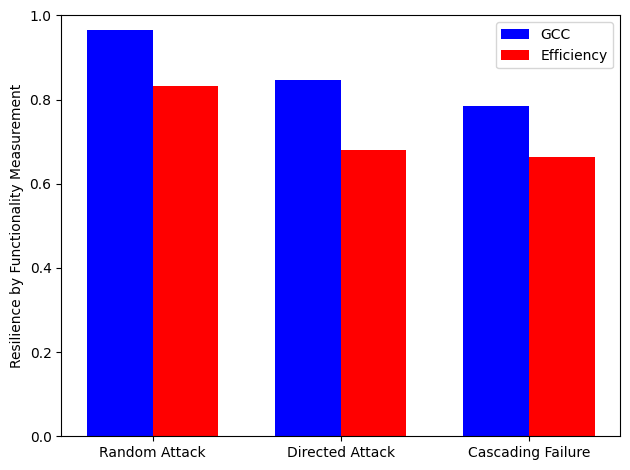

In [420]:
labels = ['Random Attack', 'Directed Attack', 'Cascading Failure']
gcc_values = [ri_gcc_random_topo, ri_gcc_between_topo, ri_gcc_cascading_topo]
eff_values = [ri_eff_random_topo, ri_eff_between_topo, ri_eff_cascading_topo]
x = np.arange(len(labels))  # label locations
width = 0.35  # width of the bars

fig, ax = plt.subplots()

rects1 = ax.bar(x - width/2, gcc_values, width, label='GCC', color='blue')
rects2 = ax.bar(x + width/2, eff_values, width, label='Efficiency', color='red')

# Add some text for labels, title, and custom x-axis tick labels, etc.
#ax.set_xlabel('Method')
ax.set_ylabel('Resilience by Functionality Measurement')
#ax.set_title('Resilience Index by Method and Measure')
ax.set_ylim(top=1,bottom=0)
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend()

fig.tight_layout()
plt.savefig('plots/resilience_topo.png')
plt.show()


In [229]:
cf_links

[('行唐县_130125', '灵寿县_130126'),
 ('青龙满族自治县_130321', '宽城满族自治县_130827'),
 array(['博野县_130637', '安国市_130683'], dtype=object)]

In [225]:
da_links

[('襄都区_130502', '内丘县_130523'),
 ('深泽县_130128', '安平县_131125'),
 ('门头沟区_110109', '石景山区_110107'),
 array(['南宫市_130581', '巨鹿县_130529'], dtype=object)]

## 原始图像

In [235]:
def translate_to_english(chinese_text):
    # This is just a dummy translation. You need to integrate with Google Translate or other translation service.
    dummy_translation = {
        '行唐县': 'Xingtang',
        '灵寿县': 'Lingshou',
        '青龙满族自治县': 'Qinglong',
        '宽城满族自治县':'Kuancheng',
        '博野县':'Boye',
        '安国市':'Anguo',
        '襄都区': 'Xiangdu',
        '内丘县':'Neiqiu',
        '深泽县': 'Shenze',
        '安平县': 'Anping',
        '门头沟区':'Mentougou',
        '石景山区':'Shijingshan',
        '南宫市':'Nangong',
        '巨鹿县':'Julu'
    }
    return dummy_translation.get(chinese_text, chinese_text)

In [251]:
import matplotlib.colors as mcolors
from pypinyin import lazy_pinyin

def plot_graphs(modified_graph, da_links, cf_links, filename=None):
    """
    Plot two graphs layered on each other. The original graph is at the bottom 
    and the graph with marked edges is on top.
    """
    
    fig, ax = plt.subplots(figsize=(10, 8))
    ax.set_facecolor('white')
    ax.axis('off')
    fig.patch.set_alpha(0.0)
    ax.patch.set_alpha(0.0)
    
    pos = nx.get_node_attributes(modified_graph, 'coordinates')
    
    degrees = [d for n, d in modified_graph.degree()]
    colors = [(0.5, 0.5, 0.5)] + [plt.cm.YlOrRd(i) for i in np.linspace(0, 1, 255)]
    custom_colormap = mcolors.LinearSegmentedColormap.from_list("custom", colors, N=256)
    norm = plt.Normalize(vmin=0, vmax=max(degrees))
    node_colors_rgb = [custom_colormap(norm(d)) for d in degrees]
    
    edge_betweenness = nx.edge_betweenness_centrality(modified_graph)
    edge_widths = [edge_betweenness[edge] * 3 + 1.5 for edge in modified_graph.edges()]
    edge_colors = [edge_betweenness[edge] for edge in modified_graph.edges()]
    
    start = 0.5
    stop = 1.0
    colors = plt.cm.BuPu(np.linspace(start, stop, 256))
    custom_BuPu = mcolors.LinearSegmentedColormap.from_list('custom_BuPu', colors)
    
    all_node_labels = nx.get_node_attributes(modified_graph, 'city_name')

    # Extract labels for the two nodes of the specific link and translate them to English
    node_labels = {node: translate_to_english(all_node_labels[node]) 
               for edge in list(da_links) + list(cf_links) 
               for node in edge 
               if node in all_node_labels}

    
    nx.draw_networkx_edges(modified_graph, pos, width=edge_widths, edge_color=edge_colors, edge_cmap=custom_BuPu)
    nx.draw_networkx_nodes(modified_graph, pos, node_size=30, node_color=node_colors_rgb, cmap=plt.cm.YlOrRd)

    for da_link in da_links:
        nx.draw_networkx_edges(modified_graph, pos, edgelist=[tuple(da_link)], edge_color='#00EEEE', width=edge_widths)

    for cf_link in cf_links:
        nx.draw_networkx_edges(modified_graph, pos, edgelist=[tuple(cf_link)], edge_color='#d425e9', width=edge_widths)

    # Label nodes in da_links and cf_links
    unique_nodes_from_links = set([node for link in da_links + cf_links for node in link])
    for node in unique_nodes_from_links:
        if node in node_labels:
            x, y = pos[node]
            plt.text(x, y, node_labels[node], fontsize=10, color='black', alpha=0.7, ha='left', va='bottom')


    cax = fig.add_axes([0.6, 0.2, 0.15, 0.03])
    edge_colorbar = plt.colorbar(plt.cm.ScalarMappable(cmap=custom_BuPu, 
                        norm=plt.Normalize(vmin=min(edge_colors), vmax=max(edge_colors))), cax=cax, orientation='horizontal')
    min_val, max_val = min(edge_colors), max(edge_colors)
    middle_val = (min_val + max_val) / 2
    edge_colorbar.set_ticks([min_val, middle_val, max_val])
    edge_colorbar.set_ticklabels([f"{min_val:.2f}", f"{middle_val:.2f}", f"{max_val:.2f}"])
    edge_colorbar.outline.set_edgecolor('none')
    edge_colorbar.set_label('Link Betweenness Centrality',labelpad=-50)
    
    cax_nodes = fig.add_axes([0.6, 0.3, 0.15, 0.03])
    node_colorbar = plt.colorbar(plt.cm.ScalarMappable(cmap=custom_colormap, 
                        norm=norm), cax=cax_nodes, orientation='horizontal')
    min_degree, max_degree = 0, max(degrees)
    middle_degree = max_degree // 2
    node_colorbar.set_ticks([min_degree, middle_degree, max_degree])
    node_colorbar.set_ticklabels([min_degree, middle_degree, max_degree])
    node_colorbar.outline.set_edgecolor('none')
    node_colorbar.set_label('Node Degree', labelpad=-50)
    
    if filename:
        plt.savefig(f'{filename}.png', dpi=400, bbox_inches='tight', pad_inches=0.1, transparent=True)
    
    plt.show()

# Example usage:
# plot_graphs(modified_graph, da_links, cf_links, filename="desired_name")


/Users/liaoyuhan/opt/anaconda3/envs/urbsim/lib/python3.10/site-packages/networkx/drawing/nx_pylab.py:433: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(


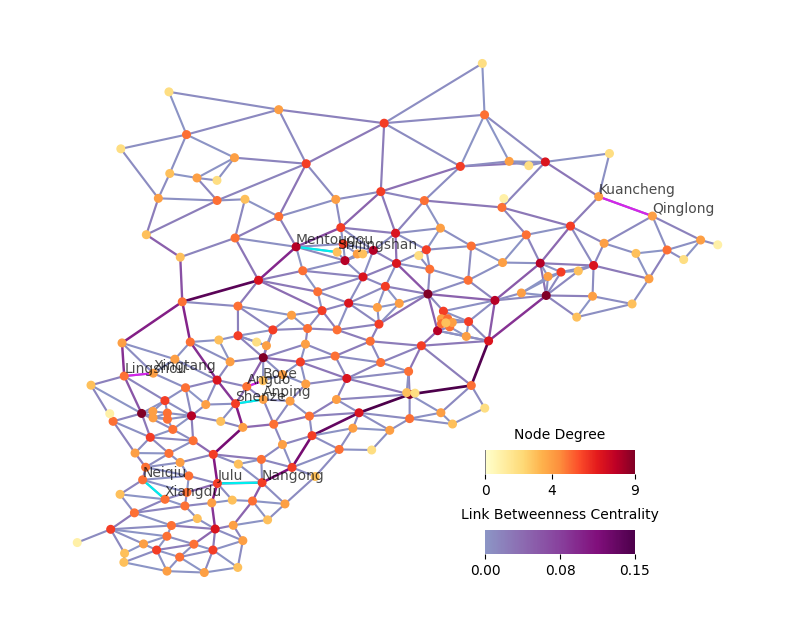

In [252]:
plot_graphs(graph,da_links, cf_links, filename="graph_links")

In [268]:
def create_centrality_table(graph, da_links, cf_links):
    """
    Create a table with node degrees and edge betweenness centrality for given links.

    Parameters:
    - graph: A networkx graph.
    - da_links: List of DA links.
    - cf_links: List of CF links.

    Returns:
    - DataFrame: A pandas DataFrame containing the link vertex1, degree1, link vertex2, degree2, and betweenness centrality.
    """
    
    # Calculate betweenness centrality for edges
    edge_betweenness = nx.edge_betweenness_centrality(graph,normalized=False)

    # Calculate degrees for nodes
    #all_degrees = nx.degree_centrality(graph)
    all_degrees = dict(graph.degree())

    # Combine da_links and cf_links
    combined_links = da_links + cf_links

    # Extract relevant data
    data = []
    for edge in combined_links:
        vertex1, vertex2 = tuple(edge)  # Convert the edge (which might be a numpy array) to a tuple
        degree1 = all_degrees.get(vertex1, 0) # get degree or return 0 if not found
        degree2 = all_degrees.get(vertex2, 0) # get degree or return 0 if not found
        betweenness = edge_betweenness.get((vertex1, vertex2), 0) # get betweenness or return 0 if not found
        data.append([vertex1, degree1, vertex2, degree2, betweenness])

    # Create the DataFrame
    df = pd.DataFrame(data, columns=['Link Vertex1', 'Degree1', 'Link Vertex2', 'Degree2', 'Betweenness Centrality'])

    return df



In [269]:
create_centrality_table(graph,da_links,cf_links)

,Link Vertex1,Degree1,Link Vertex2,Degree2,Betweenness Centrality
0,襄都区_130502,5,内丘县_130523,5,203.007292
1,深泽县_130128,6,安平县_131125,4,194.238820
2,门头沟区_110109,8,石景山区_110107,3,126.203715
3,南宫市_130581,6,巨鹿县_130529,6,1355.604410
4,行唐县_130125,4,灵寿县_130126,5,41.337689
5,青龙满族自治县_130321,4,宽城满族自治县_130827,4,0.000000
6,博野县_130637,3,安国市_130683,5,0.000000


# Weighted Network

In [ ]:
#create an O-D matrix to get the flow between nodes

#assign the flow to the network

In [17]:
# Create an empty directed graph
Di_graph = nx.DiGraph()

# Add nodes to the graph
Di_graph.add_nodes_from(BTJ['Origin'])
Di_graph.add_nodes_from(BTJ['Dest'])

# Add directed edges with flow as edge weights
for row in BTJ.itertuples(index=False):
    origin = row.Origin
    dest = row.Dest
    origin_coords = row.OrigCoords
    distance = row.Distance
    flow = row.flow
    Di_graph.add_node(origin, coords=origin_coords)
    Di_graph.add_edge(origin, dest, flow=flow, distance = distance)

In [18]:
#since coords tuples are stored as string, need to convert them back to tuples using eval()
for node in Di_graph.nodes():
    Di_graph.nodes[node]['coords'] = eval(Di_graph.nodes[node]['coords'])

In [19]:
for node_name in Di_graph.nodes():
    city_name = node_name.split('_')[0]  # Extract the city name without code
    Di_graph.nodes[node_name]['city_name'] = city_name

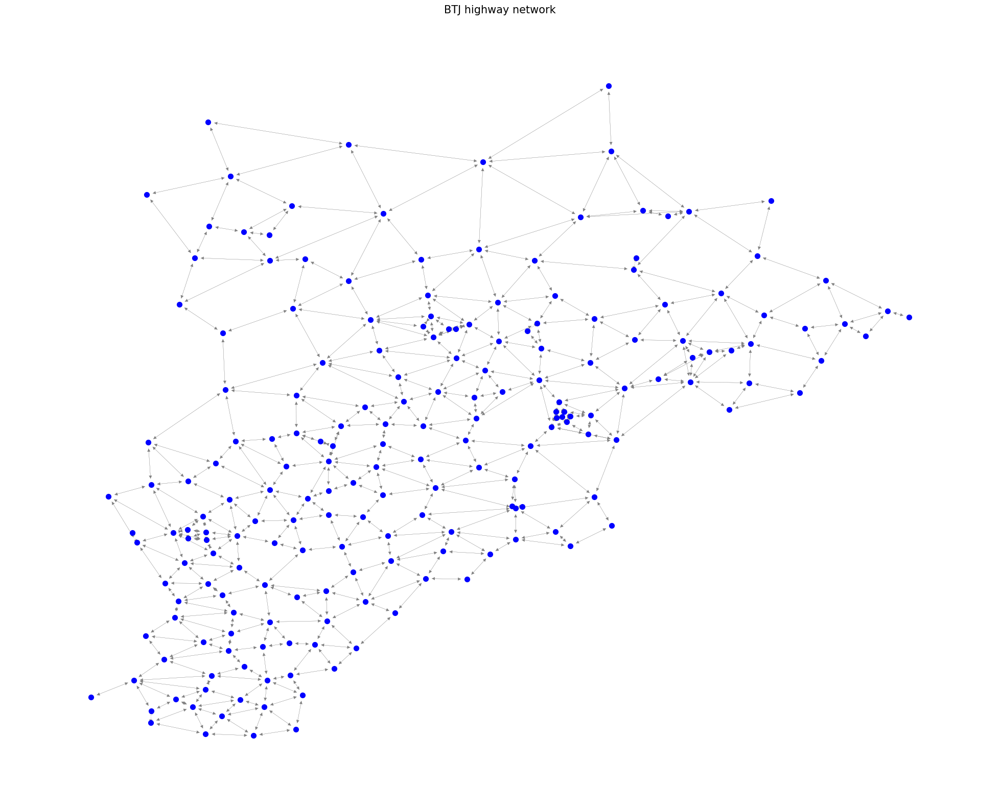

In [138]:
import matplotlib.font_manager as fm

# Specify a font that supports Chinese characters
font_path = '/System/Library/Fonts/Supplemental/Songti.ttc'
chinese_font = fm.FontProperties(fname=font_path)

# Plot the graph with the specified font
fig, ax = plt.subplots(figsize=(25, 20))

node_labels = nx.get_node_attributes(Di_graph, 'city_name')
pos = nx.get_node_attributes(Di_graph, 'coords')

nx.draw_networkx_nodes(Di_graph, pos, node_size=50, node_color='b')
nx.draw_networkx_edges(Di_graph, pos, arrows=True, width=0.2, edge_color='grey')
#for node, label in node_labels.items():
#    x, y = pos[node]
#    plt.text(x, y, label, fontproperties=chinese_font, fontsize=10, color='black')

plt.title("BTJ highway network", fontsize=15)
plt.axis("off")
plt.show()


### Properties

In [20]:
Di_graph.number_of_nodes()

199

In [21]:
Di_graph.number_of_edges()

934

In [22]:
Di_edge_between = nx.edge_betweenness_centrality(Di_graph, weight='flow')
Di_avg_edge_between = sum(Di_edge_between.values()) / Di_graph.number_of_edges()
Di_avg_edge_between

0.009947646653660656

In [23]:
Di_between = nx.betweenness_centrality(Di_graph, weight='flow')
Di_avg_between = sum(Di_between.values()) / Di_graph.number_of_nodes()
Di_avg_between

0.04208681205339624

In [24]:
Di_deg = dict(nx.degree(Di_graph))
Di_avg_deg = sum(Di_deg.values()) / Di_graph.number_of_nodes()
Di_avg_deg

9.386934673366834

In [ ]:
nx.density(Di_graph)

0.023704380488300085

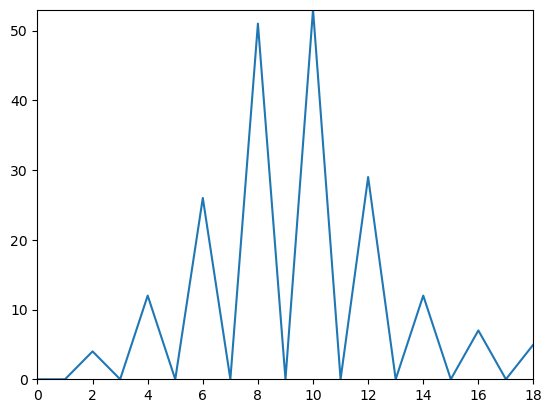

In [ ]:
plt.plot(nx.degree_histogram(Di_graph))
plt.margins(x=0, y=0)
plt.show()

### Centrality Measures

In [21]:
df_dir = pd.DataFrame(index=Di_graph.edges())
betweenness_dir=nx.edge_betweenness_centrality(Di_graph,normalized=False,weight='flow')
nx.set_edge_attributes(Di_graph,betweenness_dir,'betweenness_dir')
df_dir['betweenness_dir'] = pd.Series(nx.get_edge_attributes(Di_graph, 'betweenness_dir'))

df_dir_sorted = df_dir.sort_values(["betweenness_dir"], ascending=False)
df_dir_sorted[0:10]

,,betweenness_dir
门头沟区_110109,涞水县_130623,5812.0
涞水县_130623,门头沟区_110109,5275.0
涞源县_130630,涞水县_130623,4881.0
涞水县_130623,涞源县_130630,4784.0
怀来县_130730,赤城县_130732,4761.0
门头沟区_110109,怀来县_130730,4691.0
泊头市_130981,沧县_130921,4560.0
涞源县_130630,阜平县_130624,4527.0
枣强县_131121,武邑县_131122,4341.0
阜平县_130624,灵寿县_130126,4235.0


## Static Approach

In [22]:
import bct

In [23]:
def impact_measure_dir(network):
    adj_matrix = nx.to_numpy_array(network)
    global_efficiency = bct.efficiency_wei(adj_matrix)
    # Calculate the largest strongly connected component
    largest_scc = max(nx.strongly_connected_components(network), key=len)

    # Create a subgraph of the largest strongly connected component
    gcc = len(largest_scc)
    return gcc, global_efficiency


In [ ]:
gcc_init, ge_init = impact_measure_dir(Di_graph)
gcc_init, ge_init

(199, 0.1956360952561111)

In [426]:
def remove_edges_dir(graph, edges_to_remove, result_table):
    
    i = 0
    threshold = 0.2*ge_init
    #edges_removed = []
    for edge in edges_to_remove:
        graph.remove_edge(edge[0],edge[1])
        #edges_removed.append(edge)
        #edges_removed.extend(list(graph.edges(edge)))
        # measure the impact
        if graph.number_of_edges() > 0:  # Check if there are edges remaining in the graph
            largest_component_size,efficiency = impact_measure_dir(graph)
            # store the results in the DataFrame
            result_table.loc[i+1] = [edge,largest_component_size, efficiency]
        else:
            largest_component_size = 1
            efficiency = 0
            result_table.loc[i+1] = [edge,largest_component_size, efficiency]
            
        #print(f'The ranked {i+1} {edge} is removed')
        if efficiency <= threshold:
            break
        i += 1
    return result_table# ,edges_removed

In [367]:
#Di_graph_origin = Di_graph.copy()
def add_edges_dir(graph, edges_to_add, result_table):
    i =  len(edges_to_add)
    edges_to_add_array = np.array(edges_to_add, dtype=object)
    for edge in edges_to_add_array:
        #graph.add_node(node)
        graph.add_edge(edge[0],edge[1])
        #print(f'{edge} has been added')
        largest_component_size, efficiency = impact_measure_dir(graph)
        result_table.loc[i+1] = [edge, largest_component_size, efficiency]
       # print(f'The ranked {i - len(list(edges_to_add))} {node} is added')
        i += 1
    return result_table

### Cascading failure

In [ ]:
def edge_capacity(alpha, load):
    #alpha is the tolerance parameter
    capacity = (1 + alpha) * load
    return capacity

In [ ]:
list(Di_graph.edges(data=True))[0:10]

[('昌平区_110114_110114',
  '顺义区_110113_110113',
  {'flow': 265.0118547036413, 'distance': 50.177, 'betweenness_dir': 0.0}),
 ('昌平区_110114_110114',
  '怀柔区_110116_110116',
  {'flow': 6.9610214784901165, 'distance': 120.788, 'betweenness_dir': 395.0}),
 ('昌平区_110114_110114',
  '延庆区_110119_110119',
  {'flow': 9.421129625355993, 'distance': 66.278, 'betweenness_dir': 0.0}),
 ('昌平区_110114_110114',
  '门头沟区_110109_110109',
  {'flow': 9.757038138476023, 'distance': 76.683, 'betweenness_dir': 15.0}),
 ('昌平区_110114_110114',
  '海淀区_110108_110108',
  {'flow': 5216.066760505902, 'distance': 28.165, 'betweenness_dir': 0.0}),
 ('昌平区_110114_110114',
  '朝阳区_110105_110105',
  {'flow': 1524.5219767382603, 'distance': 45.628, 'betweenness_dir': 0.0}),
 ('朝阳区_110105_110105',
  '顺义区_110113_110113',
  {'flow': 371.96938851497225, 'distance': 46.06, 'betweenness_dir': 0.0}),
 ('朝阳区_110105_110105',
  '海淀区_110108_110108',
  {'flow': 4369.014784029188, 'distance': 33.468, 'betweenness_dir': 0.0}),
 ('朝阳区_110105_110

In [ ]:
# Iterate over the nodes and add capacity as an attribute
for node1,node2, data in Di_graph.edges(data=True):
    data['capacity'] = edge_capacity(0.1, data['betweenness_dir'])

In [ ]:
Di_graph_cascading = Di_graph.copy()
results_cascading_w = pd.DataFrame(columns=['removal', 'gcc', 'efficiency'])

In [ ]:
#remove first node
edges_removed_cascadin_dir = []
 # find the node with the highest betweenness centrality
#highest_betweenness = max(graph.edges(data=True), key=lambda x: x[1]['betweenness_dir'])
highest_betweenness = max(Di_graph_cascading.edges(data=True), key=lambda x: x[2].get('betweenness_dir', 0))

highest_betweenness_edge = highest_betweenness[0],highest_betweenness[1]

# append the node into the list
edges_removed_cascadin_dir.append(highest_betweenness_edge)
# remove the first node that has the highest betweenness centrality
Di_graph_cascading.remove_edge( highest_betweenness[0],highest_betweenness[1])
largest_component_size, efficiency = impact_measure_dir(Di_graph_cascading)
results_cascading_w.loc[1] = [highest_betweenness_edge, largest_component_size, efficiency]

In [ ]:
highest_betweenness_edge

('赤城县_130732_130732', '怀来县_130730_130730')

In [ ]:
i = 2
while True:

    betweenness_cascading_dir = nx.edge_betweenness_centrality(Di_graph_cascading, normalized=False,weight='flow')
    nx.set_edge_attributes(Di_graph_cascading, betweenness_cascading_dir, 'betweenness_dir')
    
    # Create a copy of edges_removed_cascadin_dir to avoid modifying it while iterating
    edges_removed_copy = edges_removed_cascadin_dir.copy()
    
    shortest_paths = []
    for edge in edges_removed_copy:
        try:
            shortest_path = nx.shortest_path(Di_graph_cascading, edge[0], edge[1], weight='distance')
            shortest_paths.append(shortest_path)
        except nx.NetworkXNoPath:
            print(f"No path between {edge[0]} and {edge[1]}")
    
    exceeding_capacity_edges = False  # Flag to indicate if there are exceeding capacity edges

    for shortest_path in shortest_paths:
        shortest_edges_list = []
        for idx in range(len(shortest_path)-1):
            shortest_edge = (shortest_path[idx], shortest_path[idx+1])
            shortest_edges_list.append(shortest_edge)
        
        for edge in shortest_edges_list:
            edge_data = Di_graph_cascading.get_edge_data(*edge)
            if edge_data is not None:
                load = edge_data.get('betweenness_dir', 0)
                capacity = edge_data.get('capacity', 0)
                if load is not None and capacity is not None and load > capacity:
                    print(f"The load of edge {edge} is greater than capacity.")
                    edges_removed_cascadin_dir.append(edge)
                    Di_graph_cascading.remove_edge(*edge)
                    largest_component_size, efficiency = impact_measure_dir(Di_graph_cascading)
                    results_cascading_w.loc[i] = [edge, largest_component_size, efficiency]
                    i += 1
                    exceeding_capacity_edges = True 
                else:
                    print(f"The load of edge {edge} is within capacity.")
            else:
                print(f"No edge data found for {edge}")
    if not exceeding_capacity_edges:
        break  # Break the loop if there are no exceeding capacity edges


The load of edge ('门头沟区_110109', '房山区_110111') is within capacity.
The load of edge ('房山区_110111', '涞水县_130623') is greater than capacity.
The load of edge ('门头沟区_110109', '涿鹿县_130731') is greater than capacity.
The load of edge ('涿鹿县_130731', '涞水县_130623') is greater than capacity.
The load of edge ('房山区_110111', '涿州市_130681') is within capacity.
The load of edge ('涿州市_130681', '涞水县_130623') is greater than capacity.
The load of edge ('门头沟区_110109', '房山区_110111') is within capacity.
The load of edge ('房山区_110111', '涿州市_130681') is greater than capacity.
The load of edge ('涿州市_130681', '高碑店市_130684') is greater than capacity.
The load of edge ('高碑店市_130684', '涞水县_130623') is greater than capacity.
No edge data found for ('房山区_110111', '涿州市_130681')
No edge data found for ('涿州市_130681', '高碑店市_130684')
No edge data found for ('高碑店市_130684', '涞水县_130623')
The load of edge ('门头沟区_110109', '怀来县_130730') is greater than capacity.
The load of edge ('怀来县_130730', '涿鹿县_130731') is greater than 

In [ ]:
add_edges_dir(Di_graph_cascading,edges_removed_cascadin_dir,results_cascading_w)

,removal,gcc,efficiency
1,"(门头沟区_110109, 涞水县_130623)",199,0.195155
2,"(房山区_110111, 涞水县_130623)",199,0.194992
3,"(门头沟区_110109, 涿鹿县_130731)",199,0.194787
4,"(涿鹿县_130731, 涞水县_130623)",199,0.194510
5,"(涿州市_130681, 涞水县_130623)",199,0.194162
...,...,...,...
614,"[磁县_130427, 邯山区_130402]",199,0.195324
615,"[通州区_110112, 顺义区_110113]",199,0.195573
616,"[永年区_130408, 丛台区_130403]",199,0.195597
617,"[复兴区_130404, 峰峰矿区_130406]",199,0.195609


In [421]:
len(edges_removed_cascadin_dir)

309

### Random Failure

Repetition

In [427]:
all_results_w = []

for i in range(10):
    print(f"Repetition {i+1} of 10 is in progress...")  # Reminder of the repetition process
    
    Di_graph_random_w = Di_graph.copy()
    results_random_w = pd.DataFrame(columns=['removal', 'gcc', 'efficiency'])
    
    num_edges_to_remove_w = int(len(list(Di_graph_random_w.edges())))
    random_edges_to_remove_w = random.sample(list(Di_graph_random_w.edges()), k=len(edges_removed_cascadin_dir))
    
    remove_edges_dir(Di_graph_random_w, random_edges_to_remove_w, results_random_w)
    add_edges_dir(Di_graph_random_w, random_edges_to_remove_w, results_random_w)
    
    all_results_w.append(results_random_w)


Repetition 1 of 10 is in progress...
Repetition 2 of 10 is in progress...
Repetition 3 of 10 is in progress...
Repetition 4 of 10 is in progress...
Repetition 5 of 10 is in progress...
Repetition 6 of 10 is in progress...
Repetition 7 of 10 is in progress...
Repetition 8 of 10 is in progress...
Repetition 9 of 10 is in progress...
Repetition 10 of 10 is in progress...


In [428]:
# Calculate mean and standard deviation for each fraction of links removed/added
mean_gcc_w = pd.concat([df['gcc'] for df in all_results_w], axis=1).mean(axis=1)
std_gcc_w = pd.concat([df['gcc'] for df in all_results_w], axis=1).std(axis=1)
mean_eff_w = pd.concat([df['efficiency'] for df in all_results_w], axis=1).mean(axis=1)
std_eff_w = pd.concat([df['efficiency'] for df in all_results_w], axis=1).std(axis=1)

One time

In [150]:
graph_w_random = Di_graph.copy()
#results_random_topo = pd.DataFrame({'removal': ['initial'],
#                        'size of lagrest component': [largest_component_size_init],
#                        'connectivity': [connectivity_init],
#                        #'average shortest path length': [avg_shortest_path_length_init],
#                        'efficiency':[efficiency_init]})
results_random_w = pd.DataFrame(columns=['removal', 'gcc', 'efficiency'])

In [151]:
import random
num_edges_to_remove_w = int(len(list(graph_w_random.edges())))
random_edges_to_remove_w = random.sample(list(graph_w_random.edges()), k = num_edges_to_remove_w)
random_edges_to_remove_w

[('复兴区_130404', '邯山区_130402'),
 ('任丘市_130982', '安新县_130632'),
 ('滦州市_130284', '迁安市_130283'),
 ('安平县_131125', '深泽县_130128'),
 ('峰峰矿区_130406', '复兴区_130404'),
 ('魏县_130434', '临漳县_130423'),
 ('大兴区_110115', '朝阳区_110105'),
 ('涞水县_130623', '易县_130633'),
 ('枣强县_131121', '景县_131127'),
 ('蓟州区_120119', '遵化市_130281'),
 ('枣强县_131121', '南宫市_130581'),
 ('磁县_130427', '临漳县_130423'),
 ('赤城县_130732', '丰宁满族自治县_130826'),
 ('深泽县_130128', '定州市_130682'),
 ('高碑店市_130684', '雄县_130638'),
 ('任泽区_130505', '襄都区_130502'),
 ('崇礼区_130709', '张北县_130722'),
 ('滨海新区_120116', '东丽区_120110'),
 ('丰润区_130208', '迁西县_130227'),
 ('涞水县_130623', '房山区_110111'),
 ('西青区_120111', '北辰区_120113'),
 ('武邑县_131122', '景县_131127'),
 ('阜城县_131128', '泊头市_130981'),
 ('新华区_130105', '正定县_130123'),
 ('河西区_120103', '津南区_120112'),
 ('青龙满族自治县_130321', '抚宁区_130306'),
 ('霸州市_131081', '固安县_131022'),
 ('鹿泉区_130110', '灵寿县_130126'),
 ('沧县_130921', '黄骅市_130983'),
 ('献县_130929', '武强县_131123'),
 ('涞水县_130623', '高碑店市_130684'),
 ('曲阳县_130634', '唐县_130627'),
 ('任丘

In [152]:
remove_edges_dir(graph_w_random,random_edges_to_remove_w,results_random_w)

,removal,gcc,efficiency
1,"(复兴区_130404, 邯山区_130402)",199,0.195613
2,"(任丘市_130982, 安新县_130632)",199,0.195571
3,"(滦州市_130284, 迁安市_130283)",199,0.195529
4,"(安平县_131125, 深泽县_130128)",199,0.195492
5,"(峰峰矿区_130406, 复兴区_130404)",199,0.195479
...,...,...,...
930,"(通州区_110112, 大兴区_110115)",1,0.000102
931,"(襄都区_130502, 信都区_130503)",1,0.000076
932,"(和平区_120101, 南开区_120104)",1,0.000051
933,"(蠡县_130635, 肃宁县_130926)",1,0.000025


In [153]:
add_edges_dir(graph_w_random,random_edges_to_remove_w,results_random_w)

['复兴区_130404' '邯山区_130402'] has been added
['任丘市_130982' '安新县_130632'] has been added
['滦州市_130284' '迁安市_130283'] has been added
['安平县_131125' '深泽县_130128'] has been added
['峰峰矿区_130406' '复兴区_130404'] has been added
['魏县_130434' '临漳县_130423'] has been added
['大兴区_110115' '朝阳区_110105'] has been added
['涞水县_130623' '易县_130633'] has been added
['枣强县_131121' '景县_131127'] has been added
['蓟州区_120119' '遵化市_130281'] has been added
['枣强县_131121' '南宫市_130581'] has been added
['磁县_130427' '临漳县_130423'] has been added
['赤城县_130732' '丰宁满族自治县_130826'] has been added
['深泽县_130128' '定州市_130682'] has been added
['高碑店市_130684' '雄县_130638'] has been added
['任泽区_130505' '襄都区_130502'] has been added
['崇礼区_130709' '张北县_130722'] has been added
['滨海新区_120116' '东丽区_120110'] has been added
['丰润区_130208' '迁西县_130227'] has been added
['涞水县_130623' '房山区_110111'] has been added
['西青区_120111' '北辰区_120113'] has been added
['武邑县_131122' '景县_131127'] has been added
['阜城县_131128' '泊头市_130981'] has been added
['新华区_1301

,removal,gcc,efficiency
1,"(复兴区_130404, 邯山区_130402)",199,0.195613
2,"(任丘市_130982, 安新县_130632)",199,0.195571
3,"(滦州市_130284, 迁安市_130283)",199,0.195529
4,"(安平县_131125, 深泽县_130128)",199,0.195492
5,"(峰峰矿区_130406, 复兴区_130404)",199,0.195479
...,...,...,...
1864,"[通州区_110112, 大兴区_110115]",199,0.195517
1865,"[襄都区_130502, 信都区_130503]",199,0.195530
1866,"[和平区_120101, 南开区_120104]",199,0.195547
1867,"[蠡县_130635, 肃宁县_130926]",199,0.195580


### Directed Failure

In [26]:
#weighted betweenness, weighted by flow
edges_to_remove_between_w = df_dir_sorted.index
edges_to_remove_between_w = edges_to_remove_between_w.tolist()
edges_to_remove_between_w

[('门头沟区_110109', '涞水县_130623'),
 ('涞水县_130623', '门头沟区_110109'),
 ('涞源县_130630', '涞水县_130623'),
 ('涞水县_130623', '涞源县_130630'),
 ('怀来县_130730', '赤城县_130732'),
 ('门头沟区_110109', '怀来县_130730'),
 ('泊头市_130981', '沧县_130921'),
 ('涞源县_130630', '阜平县_130624'),
 ('枣强县_131121', '武邑县_131122'),
 ('阜平县_130624', '灵寿县_130126'),
 ('赤城县_130732', '丰宁满族自治县_130826'),
 ('武邑县_131122', '泊头市_130981'),
 ('承德县_130821', '滦平县_130824'),
 ('灵寿县_130126', '鹿泉区_130110'),
 ('兴隆县_130822', '迁西县_130227'),
 ('滦平县_130824', '承德县_130821'),
 ('南宫市_130581', '枣强县_131121'),
 ('迁西县_130227', '滦州市_130284'),
 ('承德县_130821', '兴隆县_130822'),
 ('兴隆县_130822', '承德县_130821'),
 ('沧县_130921', '泊头市_130981'),
 ('丰宁满族自治县_130826', '滦平县_130824'),
 ('阜平县_130624', '涞源县_130630'),
 ('昌平区_110114', '门头沟区_110109'),
 ('武邑县_131122', '枣强县_131121'),
 ('怀柔区_110116', '昌平区_110114'),
 ('宁河区_120117', '丰润区_130208'),
 ('迁西县_130227', '兴隆县_130822'),
 ('泊头市_130981', '武邑县_131122'),
 ('涞水县_130623', '易县_130633'),
 ('易县_130633', '满城区_130607'),
 ('滦平县_130824', '怀柔区_110116'),


In [429]:
graph_w_between = Di_graph.copy()
#results_random_topo = pd.DataFrame({'removal': ['initial'],
#                        'size of lagrest component': [largest_component_size_init],
#                        'connectivity': [connectivity_init],
#                        #'average shortest path length': [avg_shortest_path_length_init],
#                        'efficiency':[efficiency_init]})
results_between_w = pd.DataFrame(columns=['removal', 'gcc', 'efficiency'])

In [430]:
num_edges_to_remove = len(edges_removed_cascadin_dir)
edges_removed_w = edges_to_remove_between_w[0:num_edges_to_remove]

In [423]:
len(edges_removed_w)

309

In [431]:
remove_edges_dir(graph_w_between, edges_removed_w, results_between_w)
results_after_addition_bw_w = add_edges_dir(graph_w_between, edges_removed_w, results_between_w)

### Comparison

Efficiency

In [174]:
def plot_did_comparison_w(scenario_data):
    plt.figure(figsize=(15, 10))
    
    colors = ['blue', 'red', 'green', 'purple']
    scenario_names = ['Random Attack','Directed Attack','Cascading Failure']  # Names of scenarios
    
    for idx, (edges_removed, result_table) in enumerate(scenario_data):
        edge_frac = np.arange(len(edges_removed))
        len_edge = len(edge_frac)
        
        # Failure subplot
        plt.subplot(1, 2, 1)
        plt.plot(edge_frac/len_edge*100, result_table.loc[0:len_edge]['efficiency']/ge_init*100, color=colors[idx], label=scenario_names[idx])
        plt.ylim(top=100, bottom=0)  # Adjusted to show percentage
        plt.xlabel('Fraction of Links Removed (%)',size=16)
        plt.ylabel('Proportion of Initial Efficiency (%)',size=16)
        plt.title('Failure',size=16)
        plt.legend(fontsize=16)
        plt.margins(x=0, y=0)
        
        # Recovery subplot
        plt.subplot(1, 2, 2)
        plt.plot(edge_frac/len_edge*100, result_table.loc[len_edge:len_edge*2-1]['efficiency']/ge_init*100, color=colors[idx], label=scenario_names[idx])
        plt.ylim(bottom=0, top=100)  # Adjusted to show percentage
        plt.yticks([])
        plt.xlabel('Fraction of Links Added (%)',size=16)
        plt.title('Recovery',size=16)
        plt.legend(fontsize=16)
        plt.margins(x=0, y=0)
        
    plt.subplots_adjust(wspace=0)
    plt.savefig('plots/efficiency_w.png')
    plt.show()




In [371]:
def plot_with_shading_eff_w(scenario_data):
    plt.figure(figsize=(15, 10))
    
    colors = ['blue', 'red', 'green', 'purple']
    scenario_names = ['Random Attack', 'Directed Attack', 'Cascading Failure']
    
    for idx, (edges_removed, result_table) in enumerate(scenario_data):
        edge_frac = np.arange(len(edges_removed))
        len_edge = len(edge_frac)
        # Failure subplot
        plt.subplot(1, 2, 1)
        plt.grid(True, which='both', linestyle='--', linewidth=0.5) 
        # Add shading only for Random Attack
        if scenario_names[idx] == 'Random Attack':
            plt.plot(edge_frac/len_edge*100, mean_eff[:len_edge]/ge_init*100, color=colors[idx], label=scenario_names[idx])
            plt.fill_between(edge_frac/len_edge*100, 
                             (mean_eff[:len_edge] - std_eff[:len_edge])/ge_init*100, 
                             (mean_eff[:len_edge] + std_eff[:len_edge])/ge_init*100, 
                             color=colors[idx], alpha=0.2)
        else:
            plt.plot(edge_frac/len_edge*100, result_table.loc[:len_edge]['efficiency']/ge_init*100, color=colors[idx], label=scenario_names[idx])
        plt.ylim(top=100, bottom=0)  # Adjusted to show percentage
        plt.xlabel('Fraction of Links Removed (%)',size=16)
        plt.ylabel('Proportion of Initial Efficiency (%)',size=16)
        plt.title('Failure',size=16)
        plt.legend(fontsize=16)
        plt.margins(x=0, y=0)
        
        # Recovery subplot
        plt.subplot(1, 2, 2)
        plt.grid(True, which='both', linestyle='--', linewidth=0.5)
        ax = plt.gca()  # Get current axis
        ax.set_yticklabels([])  # Remove y-tick labels but keep the ticks
        # Add shading only for Random Attack
        if scenario_names[idx] == 'Random Attack':
            plt.plot(edge_frac/len_edge*100, mean_eff[len_edge:]/ge_init*100, color=colors[idx], label=scenario_names[idx])
            plt.fill_between(edge_frac/len_edge*100, 
                             (mean_eff[len_edge:] - std_eff[len_edge:])/ge_init*100, 
                             (mean_eff[len_edge:] + std_eff[len_edge:])/ge_init*100, 
                             color=colors[idx], alpha=0.2)
        else:
            plt.plot(edge_frac/len_edge*100, result_table.loc[len_edge:2*len_edge-1]['efficiency']/ge_init*100, color=colors[idx], label=scenario_names[idx])
        plt.ylim(bottom=0, top=100)  # Adjusted to show percentage
        #plt.yticks([])
        plt.xlabel('Fraction of Links Added (%)',size=16)
        plt.title('Recovery',size=16)
        plt.legend(fontsize=16)
        plt.margins(x=0, y=0)
        
    plt.subplots_adjust(wspace=0)
    plt.savefig('plots/efficiency_w.png')
    plt.show()




/var/folders/t2/rbnfb0fd63x_nzy8bn0_m4x80000gn/T/ipykernel_884/1543825812.py:15: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  plt.plot(edge_frac/len_edge*100, mean_eff[:len_edge]/ge_init*100, color=colors[idx], label=scenario_names[idx])
/var/folders/t2/rbnfb0fd63x_nzy8bn0_m4x80000gn/T/ipykernel_884/1543825812.py:17: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  (mean_eff[:len_edge] - std_eff[:len_edge])/ge_init*100,
/var/folders/t2/rbnfb0fd63x_nzy8bn0_m4x80000gn/T/ipykernel_884

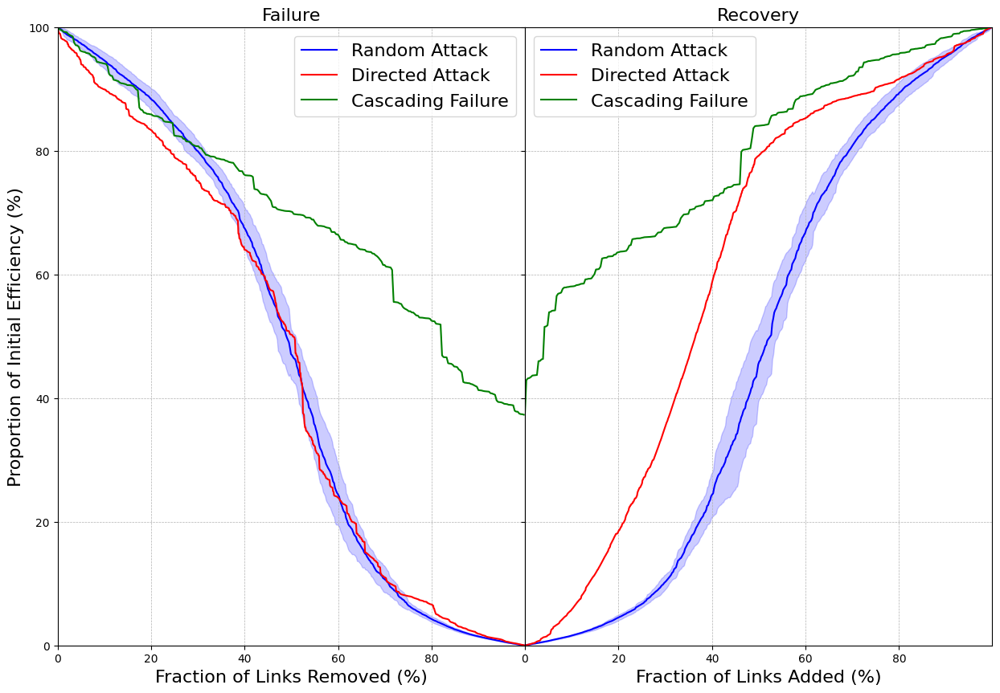

In [372]:
plot_with_shading_eff_w([(random_edges_to_remove_w,results_random_w), (edges_removed_w,results_between_w),(edges_removed_cascadin_dir,results_cascading_w)])

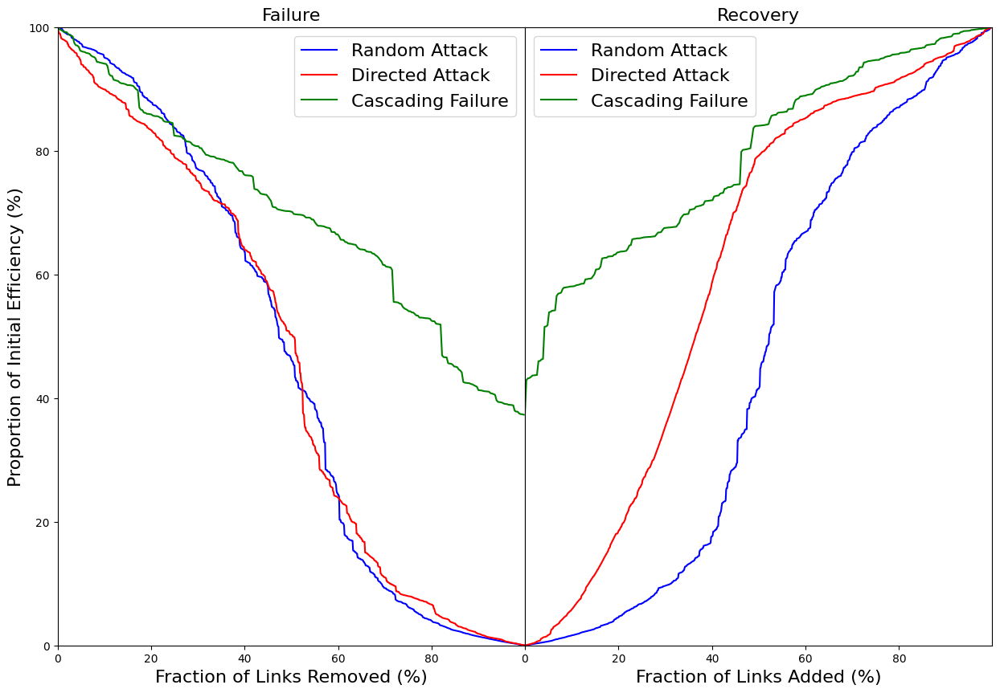

In [175]:
plot_did_comparison_w([(random_edges_to_remove_w,results_random_w), (edges_removed_w,results_between_w),(edges_removed_cascadin_dir,results_cascading_w)])

GCC

In [177]:
def plot_did_comparison_gcc_w(scenario_data):
    plt.figure(figsize=(15, 10))
    
    colors = ['blue', 'red', 'green', 'purple']
    scenario_names = ['Random Attack','Directed Attack','Cascading Failure']  # Names of scenarios
    
    for idx, (edges_removed, result_table) in enumerate(scenario_data):
        edge_frac = np.arange(len(edges_removed))
        len_edge = len(edge_frac)
        
        # Failure subplot
        plt.subplot(1, 2, 1)
        plt.plot(edge_frac/len_edge*100, result_table.loc[0:len_edge]['gcc']/gcc_init*100, color=colors[idx], label=scenario_names[idx])
        plt.ylim(top=100, bottom=0)  # Adjusted to show percentage
        plt.xlabel('Fraction of Links Removed (%)',size=16)
        plt.ylabel('Relative GCC (%)',size=16)
        plt.title('Failure',size=16)
        plt.legend(fontsize=16)
        plt.margins(x=0, y=0)
        
        # Recovery subplot
        plt.subplot(1, 2, 2)
        plt.plot(edge_frac/len_edge*100, result_table.loc[len_edge:len_edge*2-1]['gcc']/gcc_init*100, color=colors[idx], label=scenario_names[idx])
        plt.ylim(bottom=0, top=100)  # Adjusted to show percentage
        plt.yticks([])
        plt.xlabel('Fraction of Links Added (%)',size=16)
        plt.title('Recovery',size=16)
        plt.legend(fontsize=16)
        plt.margins(x=0, y=0)
        
    plt.subplots_adjust(wspace=0)
    plt.savefig('plots/gcc_w.png')
    plt.show()


In [375]:
def plot_with_shading_gcc_w(scenario_data):
    plt.figure(figsize=(15, 10))
    
    colors = ['blue', 'red', 'green', 'purple']
    scenario_names = ['Random Attack', 'Directed Attack', 'Cascading Failure']
    
    for idx, (edges_removed, result_table) in enumerate(scenario_data):
        edge_frac = np.arange(len(edges_removed))
        len_edge = len(edge_frac)
        # Failure subplot
        plt.subplot(1, 2, 1)
        plt.grid(True, which='both', linestyle='--', linewidth=0.5)
        # Add shading only for Random Attack
        if scenario_names[idx] == 'Random Attack':
            plt.plot(edge_frac/len_edge*100, mean_gcc[:len_edge]/gcc_init*100, color=colors[idx], label=scenario_names[idx])
            plt.fill_between(edge_frac/len_edge*100, 
                             (mean_gcc[:len_edge] - std_gcc[:len_edge])/gcc_init*100, 
                             (mean_gcc[:len_edge] + std_gcc[:len_edge])/gcc_init*100, 
                             color=colors[idx], alpha=0.2)
        else:
            plt.plot(edge_frac/len_edge*100, result_table.loc[:len_edge]['gcc']/gcc_init*100, color=colors[idx], label=scenario_names[idx])
        plt.ylim(top=100, bottom=0)  # Adjusted to show percentage
        plt.xlabel('Fraction of Links Removed (%)',size=16)
        plt.ylabel('Relative GCC (%)',size=16)
        plt.title('Failure',size=16)
        plt.legend(fontsize=16)
        plt.margins(x=0, y=0)
        
        # Recovery subplot
        plt.subplot(1, 2, 2)
        plt.grid(True, which='both', linestyle='--', linewidth=0.5)
        ax = plt.gca()  # Get current axis
        ax.set_yticklabels([])  # Remove y-tick labels but keep the ticks
        # Add shading only for Random Attack
        if scenario_names[idx] == 'Random Attack':
            plt.plot(edge_frac/len_edge*100, mean_gcc[len_edge:]/gcc_init*100, color=colors[idx], label=scenario_names[idx])
            plt.fill_between(edge_frac/len_edge*100, 
                             (mean_gcc[len_edge:] - std_gcc[len_edge:])/gcc_init*100, 
                             (mean_gcc[len_edge:] + std_gcc[len_edge:])/gcc_init*100, 
                             color=colors[idx], alpha=0.2)
        else:
            plt.plot(edge_frac/len_edge*100, result_table.loc[len_edge:2*len_edge-1]['gcc']/gcc_init*100, color=colors[idx], label=scenario_names[idx])
        plt.ylim(bottom=0, top=100)  # Adjusted to show percentage
        #plt.yticks([])
        plt.xlabel('Fraction of Links Added (%)',size=16)
        plt.title('Recovery',size=16)
        plt.legend(fontsize=16)
        plt.margins(x=0, y=0)
        
    plt.subplots_adjust(wspace=0)
    plt.savefig('plots/gcc_w.png')
    plt.show()

/var/folders/t2/rbnfb0fd63x_nzy8bn0_m4x80000gn/T/ipykernel_884/438262868.py:15: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  plt.plot(edge_frac/len_edge*100, mean_gcc[:len_edge]/gcc_init*100, color=colors[idx], label=scenario_names[idx])
/var/folders/t2/rbnfb0fd63x_nzy8bn0_m4x80000gn/T/ipykernel_884/438262868.py:17: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  (mean_gcc[:len_edge] - std_gcc[:len_edge])/gcc_init*100,
/var/folders/t2/rbnfb0fd63x_nzy8bn0_m4x80000gn/T/ipykernel_884

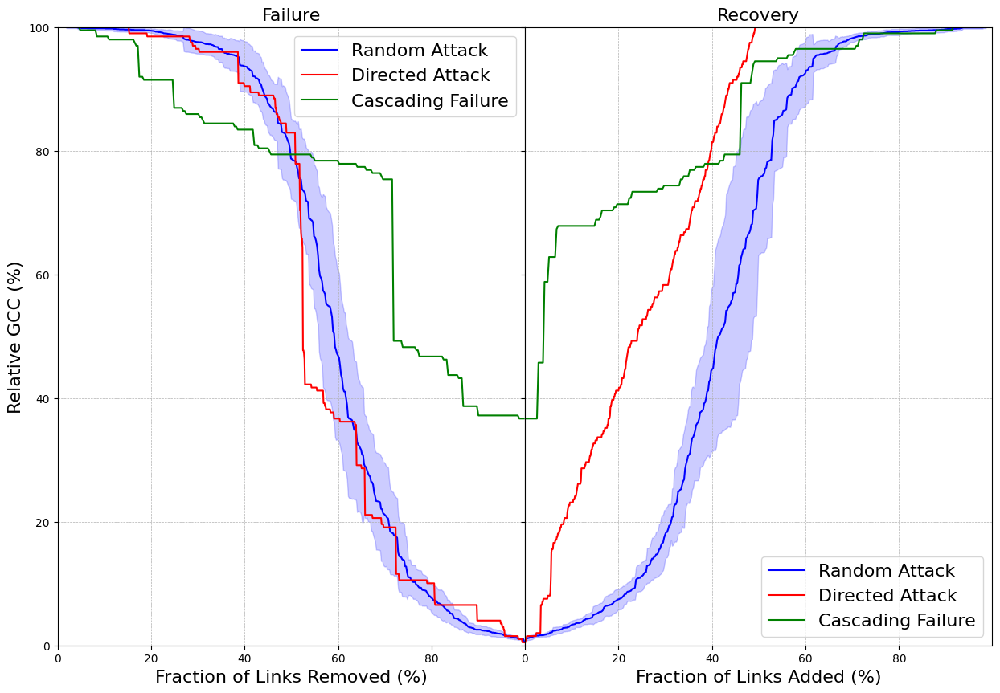

In [376]:
plot_with_shading_gcc_w([(random_edges_to_remove_w,results_random_w), (edges_removed_w,results_between_w),(edges_removed_cascadin_dir,results_cascading_w)])

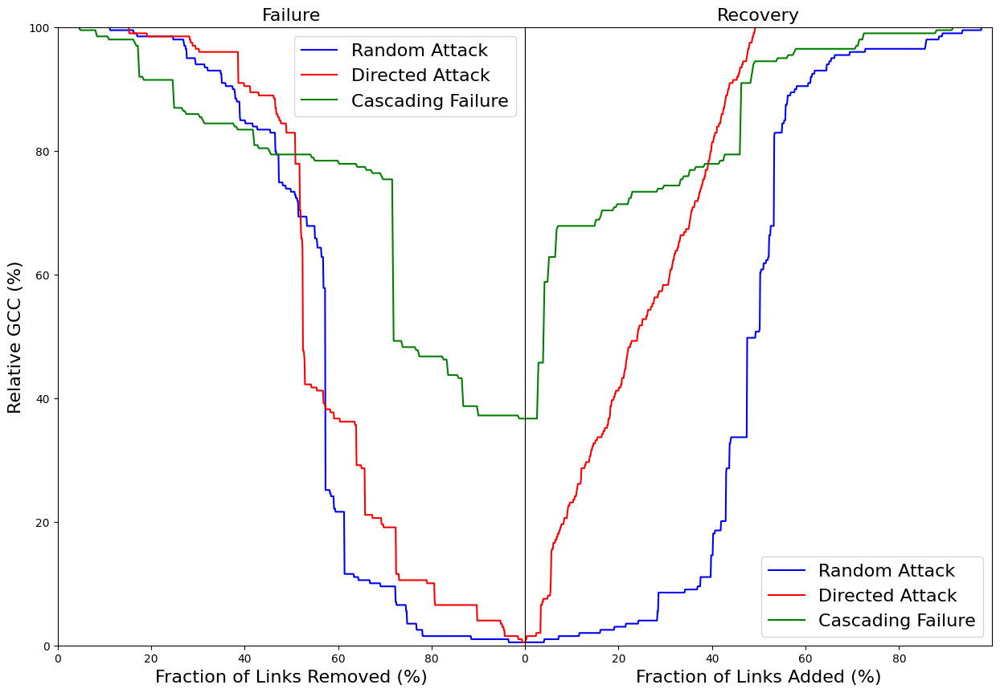

In [234]:
plot_did_comparison_gcc_w([(random_edges_to_remove_w,results_random_w), (edges_removed_w,results_between_w),(edges_removed_cascadin_dir,results_cascading_w)])

In [44]:
def plot_comparison_with_highlights_w(edges_removed, result_table, threshold=5):
    edge_frac = np.arange(len(edges_removed))
    len_edge = len(edge_frac)

    # Split the result table into failure and recovery phases
    failure_data = result_table.iloc[:len_edge]
    recovery_data = result_table.iloc[len_edge:2*len_edge]

    # Calculate the derivatives for FAILURE phase
    gcc_derivative_failure = np.diff(failure_data['gcc'].values) / np.diff(edge_frac)
    efficiency_derivative_failure = np.diff(failure_data['efficiency'].values) / np.diff(edge_frac)
    
    # Identify points where the change in the derivatives exceeds the threshold for FAILURE phase
    gcc_change_points_failure = np.where(np.abs(gcc_derivative_failure) > threshold)[0]
    efficiency_change_points_failure = np.where(np.abs(efficiency_derivative_failure) > threshold)[0]

    # Calculate the derivatives for RECOVERY phase
    gcc_derivative_recovery = np.diff(recovery_data['gcc'].values) / np.diff(edge_frac)
    efficiency_derivative_recovery = np.diff(recovery_data['efficiency'].values) / np.diff(edge_frac)
    
    # Identify points where the change in the derivatives exceeds the threshold for RECOVERY phase
    gcc_change_points_recovery = np.where(np.abs(gcc_derivative_recovery) > threshold)[0]
    efficiency_change_points_recovery = np.where(np.abs(efficiency_derivative_recovery) > threshold)[0]

    # Plotting
    plt.figure(figsize=(15, 10))
    colors = ['blue', 'red']

    # Failure subplot
    plt.subplot(1, 2, 1)
    plt.plot(edge_frac, failure_data['gcc']/gcc_init*100, color=colors[0], label='GCC')
    plt.plot(edge_frac, failure_data['efficiency']/ge_init*100, '--', color=colors[1], label='Efficiency')
    plt.scatter(gcc_change_points_failure, failure_data['gcc'].iloc[gcc_change_points_failure]/gcc_init*100, c='red', marker='o')
    plt.scatter(efficiency_change_points_failure, failure_data['efficiency'].iloc[efficiency_change_points_failure]/ge_init*100, c='blue', marker='x')
    plt.ylim(top=100, bottom=0)  # Adjusted the limit to 100 to show percentage
    plt.xlabel('No. of Edges Removed')
    plt.ylabel('Fraction(%)')  # Added % to the label
    plt.title('Failure')
    plt.legend()
    plt.margins(x=0, y=0)

    # Recovery subplot
    plt.subplot(1, 2, 2)
    plt.plot(edge_frac, recovery_data['gcc']/gcc_init*100, color=colors[0], label='GCC')
    plt.plot(edge_frac, recovery_data['efficiency']/ge_init*100, '--', color=colors[1], label='Efficiency')
    plt.scatter(gcc_change_points_recovery, recovery_data['gcc'].iloc[gcc_change_points_recovery]/gcc_init*100, c='red', marker='o')
    plt.scatter(efficiency_change_points_recovery, recovery_data['efficiency'].iloc[efficiency_change_points_recovery]/ge_init*100, c='blue', marker='x')
    plt.ylim(bottom=0, top=100)  # Adjusted the limit to 100 to show percentage
    plt.yticks([])
    plt.xlabel('No. of Edges Added')
    plt.title('Recovery')
    plt.legend()
    plt.margins(x=0, y=0)
    
    plt.subplots_adjust(wspace=0)  # Adjusting the space between plots for clarity
    plt.show()

    return gcc_change_points_failure,gcc_change_points_recovery

# You can use the function as:
# plot_comparison_with_highlights(edges_to_remove_between_topo, results_between_edge)


## 找重要点

In [151]:
def plot_two_layered_graphs_between_w(original_graph, modified_graph, specific_link_nodes):
    fig, ax = plt.subplots(figsize=(10, 8))
    ax.set_facecolor('white')
    ax.axis('off')
    fig.patch.set_alpha(0.0)
    ax.patch.set_alpha(0.0)

    # Using predefined positions based on 'coords'
    pos = nx.get_node_attributes(original_graph, 'coords')
    
    # Node plotting based on degree
    degrees = [d for n, d in modified_graph.degree()]
    colors = [(0.5, 0.5, 0.5)] + [plt.cm.YlOrRd(i) for i in np.linspace(0, 1, 255)]
    custom_colormap = mcolors.LinearSegmentedColormap.from_list("custom", colors, N=256)
    norm = plt.Normalize(vmin=0, vmax=max(degrees))
    node_colors_rgb = [custom_colormap(norm(d)) for d in degrees]
    nx.draw_networkx_nodes(modified_graph, pos, node_size=25, node_color=node_colors_rgb, cmap=plt.cm.YlOrRd)
    
    # Draw the original graph's edges with the same style as other edges beneath
    nx.draw_networkx_edges(original_graph, pos, edge_color='grey', style='dashed', width=0.5, connectionstyle="arc3,rad=0.1", alpha=0.5, arrows=True, arrowstyle="->", node_size=25, arrowsize=4 )
    
    # Edges plotting
    edge_betweenness = nx.edge_betweenness_centrality(modified_graph, weight='flow')
    
    start = 0.4  # Start from the midpoint of BuPu
    stop = 1.0  # End at the darkest color
    colors = plt.cm.BuPu(np.linspace(start, stop, 256))
    custom_BuPu = mcolors.LinearSegmentedColormap.from_list('custom_BuPu', colors)

    start_color_of_custom_BuPu = plt.cm.BuPu(0.35)
    # Determine the threshold for high betweenness centrality
    high_betweenness_threshold = np.percentile(list(edge_betweenness.values()), 50)
    high_betweenness_edges = [edge for edge, value in edge_betweenness.items() if value >= high_betweenness_threshold]
    other_edges = [edge for edge in modified_graph.edges() if edge not in high_betweenness_edges]

    nx.draw_networkx_edges(modified_graph, pos, edgelist=other_edges, edge_color=start_color_of_custom_BuPu, width=1, connectionstyle="arc3,rad=0.1", arrows=True, arrowstyle="->", node_size=25,  arrowsize=4)
    
    # Plot high betweenness edges with varying colors and widths
    edge_colors = [edge_betweenness[edge] for edge in high_betweenness_edges]
    edge_widths = [1 + edge_betweenness[edge] for edge in high_betweenness_edges]  # adjust factor as needed

    
    nx.draw_networkx_edges(modified_graph, pos, edgelist=high_betweenness_edges, edge_color=edge_colors, width=edge_widths, edge_cmap=custom_BuPu, connectionstyle="arc3,rad=0.1", arrows=True, arrowstyle="->", node_size=25, arrowsize=4 )

    # Highlight the specific edge
    specific_link = tuple(specific_link_nodes)
    nx.draw_networkx_edges(modified_graph, pos, arrows=True, edgelist=[specific_link], edge_color='#8adf3f', width=edge_widths, arrowstyle="->", connectionstyle="arc3,rad=0.1", node_size=25, arrowsize=4 )
    
     # Add colorbar for edges
    # Create new axes for colorbar
    cax = fig.add_axes([0.6, 0.2, 0.15, 0.03])
    edge_colorbar = plt.colorbar(plt.cm.ScalarMappable(cmap=custom_BuPu, 
                            norm=plt.Normalize(vmin=min(edge_colors), vmax=max(edge_colors))), cax=cax, orientation='horizontal')

    # Set tick labels to start, middle, end with two-digit decimals
    min_val, max_val = min(edge_colors), max(edge_colors)
    middle_val = (min_val + max_val) / 2
    edge_colorbar.set_ticks([min_val, middle_val, max_val])
    edge_colorbar.set_ticklabels([f"{min_val:.2f}", f"{middle_val:.2f}", f"{max_val:.2f}"])
    edge_colorbar.outline.set_edgecolor('none')
    edge_colorbar.set_label('Link Betweenness Centrality',labelpad = -50)
   
    # Create new axes for node colorbar
    cax_nodes = fig.add_axes([0.6, 0.3, 0.15, 0.03])
    node_colorbar = plt.colorbar(plt.cm.ScalarMappable(cmap=custom_colormap, 
                            norm=norm), cax=cax_nodes, orientation='horizontal')

    # Set tick labels to start, middle, end
    min_degree, max_degree = 0, max(degrees)
    middle_degree = max_degree // 2
    node_colorbar.set_ticks([min_degree, middle_degree, max_degree])
    node_colorbar.set_ticklabels([min_degree, middle_degree, max_degree])
    node_colorbar.outline.set_edgecolor('none')
    node_colorbar.set_label('Node Degree', labelpad=-50)
    
    # Save the plot
    variable_name = get_variable_name(modified_graph)
    if variable_name:
        plt.savefig(f'plots/{variable_name}.png',dpi=400 ,bbox_inches='tight', pad_inches=0.1, transparent=False)

    plt.show()


In [129]:
def plot_two_layered_graphs_between_w(original_graph, modified_graph, specific_link_nodes):
    fig, ax = plt.subplots(figsize=(10, 8))
    ax.set_facecolor('white')
    ax.axis('off')
    fig.patch.set_alpha(0.0)
    ax.patch.set_alpha(0.0)

    # Use node attributes 'coords' for positioning
    pos = nx.get_node_attributes(original_graph, 'coords')

    # Node plotting based on degree
    degrees = [d for n, d in modified_graph.degree()]
    colors = [(0.5, 0.5, 0.5)] + [plt.cm.YlOrRd(i) for i in np.linspace(0, 1, 255)]
    custom_colormap = mcolors.LinearSegmentedColormap.from_list("custom", colors, N=256)
    norm = plt.Normalize(vmin=0, vmax=max(degrees))
    node_colors_rgb = [custom_colormap(norm(d)) for d in degrees]
    nx.draw_networkx_nodes(modified_graph, pos, node_size=20, node_color=node_colors_rgb, cmap=plt.cm.YlOrRd)

    # Draw the original graph's edges with dashed style
    nx.draw_networkx_edges(original_graph, pos, edge_color='grey', style='dashed', width= 0.5, connectionstyle="arc3,rad=0.1", alpha=0.5, arrows=True, arrowstyle="->")

    # Edge plotting based on betweenness centrality
    edge_betweenness = nx.edge_betweenness_centrality(modified_graph, weight='flow')
    edge_colors = [edge_betweenness[edge] for edge in modified_graph.edges()]
    edge_widths = [1 + edge_betweenness[edge]*1 for edge in modified_graph.edges()]

    start = 0.3 # Start from the midpoint of BuPu
    stop = 1.0  # End at the darkest color
    colors = plt.cm.BuPu(np.linspace(start, stop, 256))
    custom_BuPu = mcolors.LinearSegmentedColormap.from_list('custom_BuPu', colors)
    
    nx.draw_networkx_edges(modified_graph, pos, edge_color=edge_colors, width=edge_widths, edge_cmap=custom_BuPu, connectionstyle="arc3,rad=0.1", arrows=True, arrowstyle="->")

    # Draw specific edge with distinct color
    specific_link = tuple(specific_link_nodes)
    nx.draw_networkx_edges(modified_graph, pos, edgelist=[specific_link], edge_color='#8adf3f', width=2, arrowstyle="->", connectionstyle="arc3,rad=0.1", arrowsize=10)

    plt.show()

# Usage example:
# plot_two_layered_graphs_between_w(original_graph, modified_graph, ['A', 'B'])


In [69]:
from pyvis.network import Network

def visualize_with_pyvis(original_graph, modified_graph, specific_link_nodes):
    """
    Visualize the graph using pyvis.
    """
    # Create a network
    nt = Network(notebook=True, height="800px", width="100%")
    
    # Node colors based on degree
    degrees = [d for n, d in modified_graph.degree()]
    colors = [(0.5, 0.5, 0.5)] + [plt.cm.YlOrRd(i) for i in np.linspace(0, 1, 255)]
    custom_colormap = plt.cm.colors.ListedColormap(colors)
    norm = plt.Normalize(vmin=0, vmax=max(degrees))
    node_colors_rgb = [plt.cm.colors.to_rgba(custom_colormap(norm(d))) for d in degrees]
    # Edge betweenness
    edge_betweenness = nx.edge_betweenness_centrality(modified_graph, weight='flow')
    
    # Add nodes and edges from your modified_graph to the pyvis network
    for idx, (node, data) in enumerate(modified_graph.nodes(data=True)):
        nt.add_node(node, color=plt.cm.colors.to_hex(node_colors_rgb[idx]))

    for source, target, data in modified_graph.edges(data=True):
        color = 'red' if (source, target) == tuple(specific_link_nodes) else plt.cm.colors.to_rgba(plt.cm.BuPu(edge_betweenness[(source, target)]))
        width = 2.5 if (source, target) == tuple(specific_link_nodes) else edge_betweenness[(source, target)] * 3 + 1.5
        nt.add_edge(source, target, color=plt.cm.colors.to_hex(color), width=width)

    
    # Use the node positions from original_graph
    for node, data in original_graph.nodes(data=True):
        if 'coords' in data:
            node_obj = next((n for n in nt.nodes if n['id'] == node), None)
            if node_obj:
                node_obj['x'] = data['coords'][0]
                node_obj['y'] = data['coords'][1]


    # Show the network
    nt.show("graph.html")

# Example of usage:
# visualize_with_pyvis(original_graph, modified_graph, specific_link_nodes)


DA

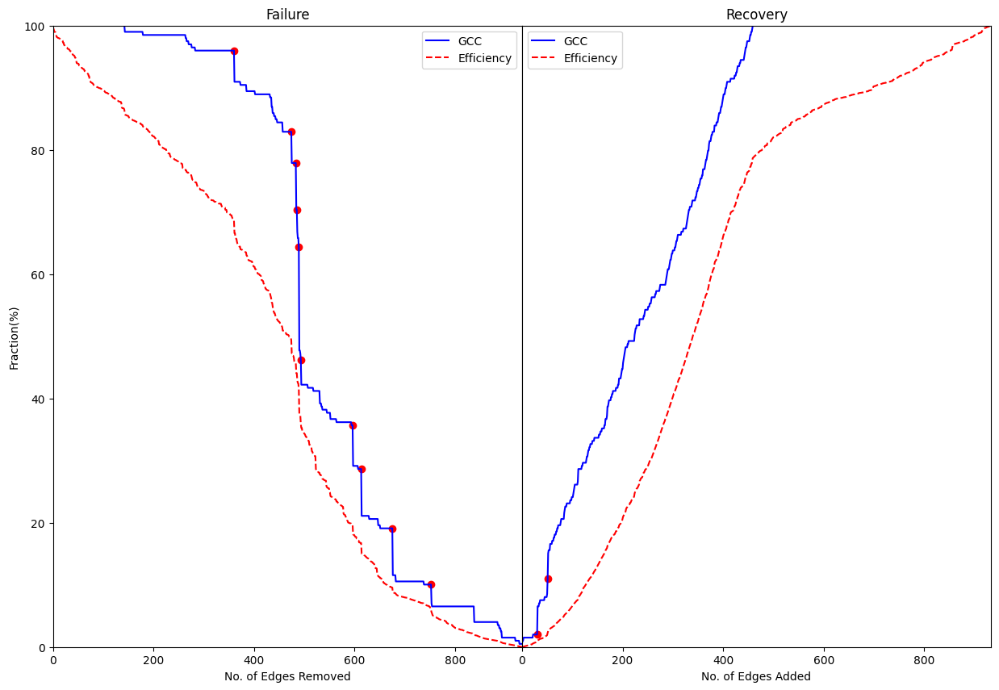

In [47]:
da_points_w = plot_comparison_with_highlights_w(edges_removed_w,results_between_w)

In [50]:
da_points_w_incremented = tuple(arr + 1 for arr in da_points_w)
da_points_w_incremented

(array([361, 475, 484, 486, 490, 494, 597, 614, 676, 753]), array([31, 52]))

In [56]:
graph_between_w_points = Di_graph.copy()
graph_between_w_points_f = copy_graph_failure(graph_between_w_points, edges_removed_w ,da_points_w_incremented)
graph_between_w_points_r = copy_graph_recovery(graph_between_w_points, edges_removed_w ,da_points_w_incremented)

In [57]:
graph_between_w_points_f

{361: <networkx.classes.digraph.DiGraph at 0x7fac67f424d0>,
 475: <networkx.classes.digraph.DiGraph at 0x7fac67f424a0>,
 484: <networkx.classes.digraph.DiGraph at 0x7fac67f42aa0>,
 486: <networkx.classes.digraph.DiGraph at 0x7fac67f414b0>,
 490: <networkx.classes.digraph.DiGraph at 0x7fac67f42290>,
 494: <networkx.classes.digraph.DiGraph at 0x7fac67f42500>,
 597: <networkx.classes.digraph.DiGraph at 0x7fac67f41330>,
 614: <networkx.classes.digraph.DiGraph at 0x7fac67f42650>,
 676: <networkx.classes.digraph.DiGraph at 0x7fac67f422c0>,
 753: <networkx.classes.digraph.DiGraph at 0x7fac67f426b0>}

In [58]:
graph_between_w_points_r

{31: <networkx.classes.digraph.DiGraph at 0x7fac67f410c0>,
 52: <networkx.classes.digraph.DiGraph at 0x7fac67f41150>}

In [59]:
graph_between_w_point_f_484 = graph_between_w_points_f[484]
graph_between_w_point_f_490 = graph_between_w_points_f[490]
graph_between_w_point_r_52 = graph_between_w_points_r[52]

In [439]:
results_between_w.iloc[484]

removal       (曲周县_130435, 鸡泽县_130431)
gcc                                140
efficiency                    0.086219
Name: 485, dtype: object

In [440]:
results_between_w.iloc[490]

removal       (满城区_130607, 顺平县_130636)
gcc                                 95
efficiency                    0.073499
Name: 491, dtype: object

In [162]:
results_between_w.iloc[52+len(edges_removed_w)]

removal       [滨海新区_120116, 黄骅市_130983]
gcc                                  30
efficiency                     0.005004
Name: 987, dtype: object

In [ ]:
between_link_w_484 = results_between_w.iloc[484]['removal']

/Users/liaoyuhan/opt/anaconda3/envs/urbsim/lib/python3.10/site-packages/networkx/drawing/nx_pylab.py:433: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(


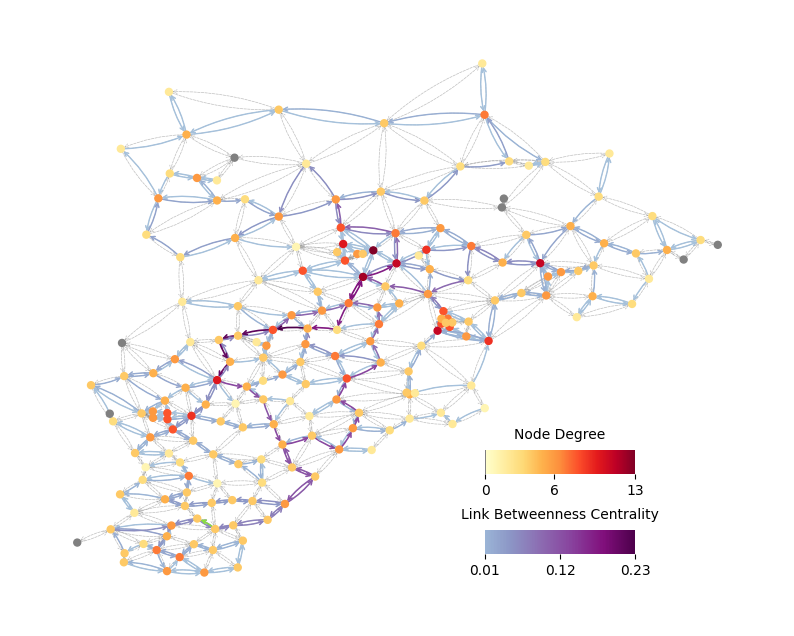

In [150]:
plot_two_layered_graphs_between_w(Di_graph,graph_between_w_point_f_484,between_link_w_484)

/Users/liaoyuhan/opt/anaconda3/envs/urbsim/lib/python3.10/site-packages/networkx/drawing/nx_pylab.py:433: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(


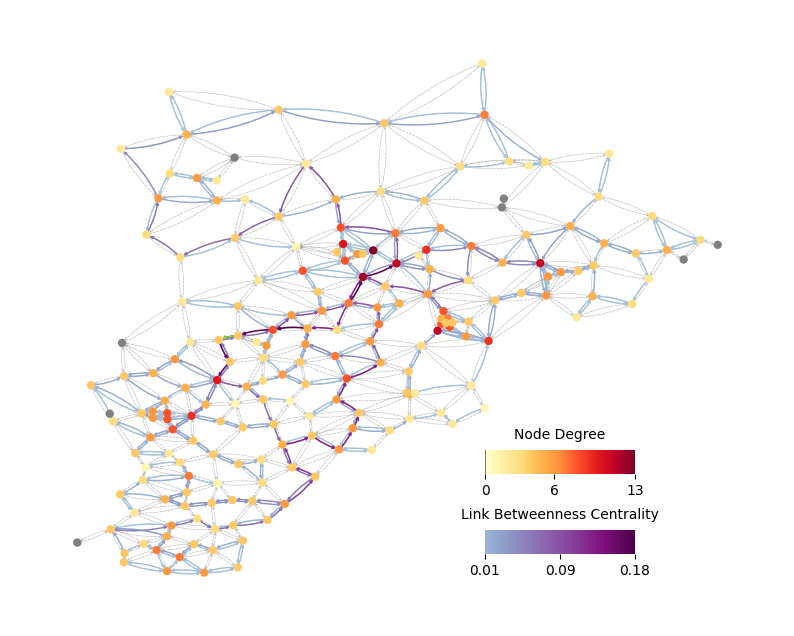

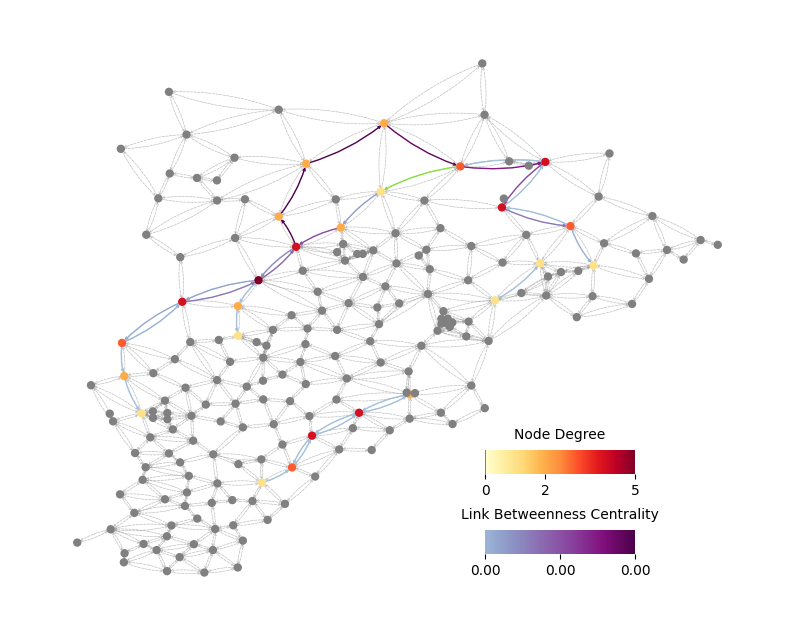

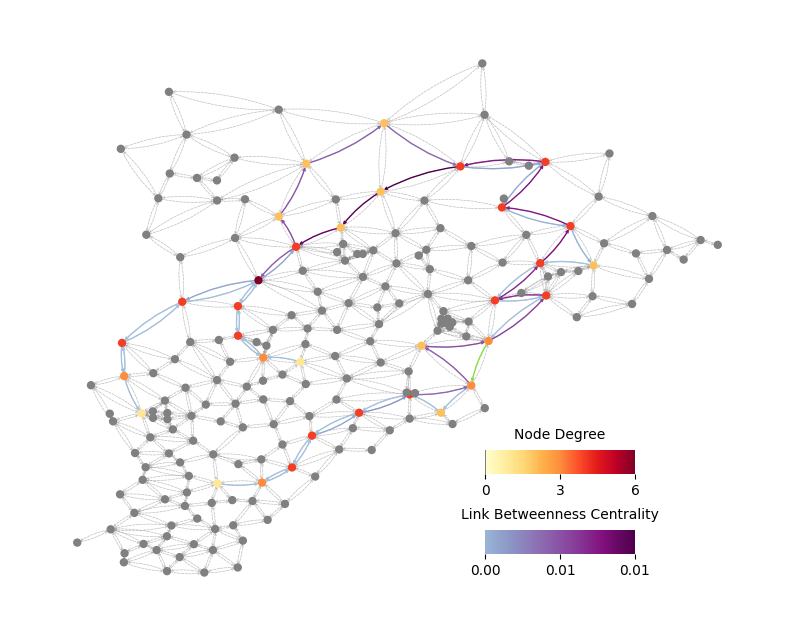

In [152]:
between_link_w_490= results_between_w.iloc[490]['removal']
plot_two_layered_graphs_between_w(Di_graph,graph_between_w_point_f_490,between_link_w_490)
between_link_w_r_52 = results_between_w.iloc[52+len(edges_removed_w)]['removal']
plot_two_layered_graphs_between_w(Di_graph,graph_between_w_point_r_52,between_link_w_r_52)

In [172]:
da_links_w = [between_link_w_484,between_link_w_490,between_link_w_r_52]

CF

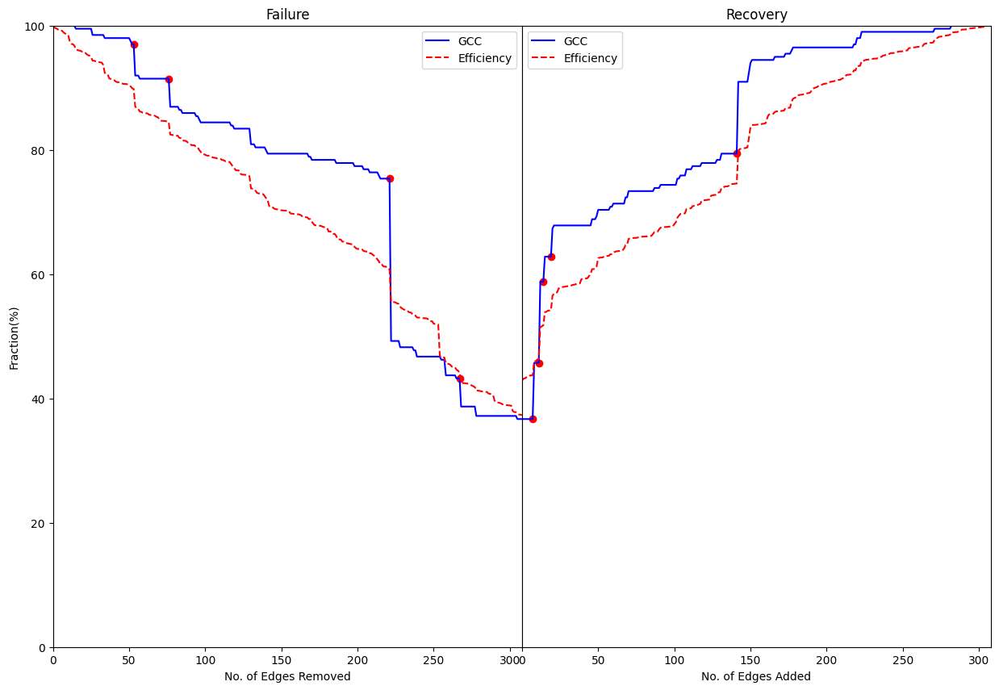

In [60]:
cf_points_w = plot_comparison_with_highlights_w(edges_removed_cascadin_dir,results_cascading_w)

In [61]:
cf_points_w_incremented = tuple(arr + 1 for arr in cf_points_w)
cf_points_w_incremented

(array([ 54,  77, 222, 268]), array([  8,  12,  15,  20, 142]))

In [153]:
graph_cascading_w_points = Di_graph.copy()
graph_cascading_w_points_f = copy_graph_failure(graph_cascading_w_points, edges_removed_cascadin_dir ,cf_points_w_incremented)
graph_cascading_w_points_r = copy_graph_recovery(graph_cascading_w_points, edges_removed_w ,cf_points_w_incremented)

In [154]:
graph_cascading_w_points_f

{54: <networkx.classes.digraph.DiGraph at 0x7fac6588e860>,
 77: <networkx.classes.digraph.DiGraph at 0x7fac4dabb100>,
 222: <networkx.classes.digraph.DiGraph at 0x7fac4dab8220>,
 268: <networkx.classes.digraph.DiGraph at 0x7fac4dab8bb0>}

In [156]:
graph_cascading_w_points_r

{8: <networkx.classes.digraph.DiGraph at 0x7fac6588e830>,
 12: <networkx.classes.digraph.DiGraph at 0x7fac4c85ea10>,
 15: <networkx.classes.digraph.DiGraph at 0x7fac4c85e9e0>,
 20: <networkx.classes.digraph.DiGraph at 0x7fac67f42140>,
 142: <networkx.classes.digraph.DiGraph at 0x7fac67f414e0>}

In [72]:
results_cascading_w.iloc[222]

removal       (故城县_131126, 清河县_130534)
gcc                                 98
efficiency                    0.108678
Name: 223, dtype: object

In [73]:
results_cascading_w.iloc[12+len(edges_removed_cascadin_dir)]

removal       [涞源县_130630, 涞水县_130623]
gcc                                117
efficiency                    0.100805
Name: 322, dtype: object

In [157]:
results_cascading_w.iloc[142+len(edges_removed_cascadin_dir)]

removal       [辛集市_130181, 宁晋县_130528]
gcc                                181
efficiency                    0.156189
Name: 452, dtype: object

In [281]:
results_cascading_w[140++len(edges_removed_cascadin_dir):150+len(edges_removed_cascadin_dir)]

,removal,gcc,efficiency
450,"[深州市_131182, 安平县_131125]",158,0.145885
451,"[蠡县_130635, 高阳县_130628]",158,0.145909
452,"[辛集市_130181, 宁晋县_130528]",181,0.156189
453,"[赵县_130133, 藁城区_130109]",181,0.156771
454,"[藁城区_130109, 正定县_130123]",181,0.156855
455,"[正定县_130123, 新乐市_130184]",181,0.156953
456,"[栾城区_130111, 赵县_130133]",181,0.157027
457,"[安新县_130632, 容城县_130629]",181,0.157157
458,"[容城县_130629, 徐水区_130609]",181,0.157289
459,"[武强县_131123, 武邑县_131122]",184,0.160273


In [158]:
graph_cascading_w_point_f_222 = graph_cascading_w_points_f[222]
graph_cascading_w_point_r_12 = graph_cascading_w_points_r[12]
graph_cascading_w_point_r_142 = graph_cascading_w_points_r[142]

/Users/liaoyuhan/opt/anaconda3/envs/urbsim/lib/python3.10/site-packages/networkx/drawing/nx_pylab.py:433: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(


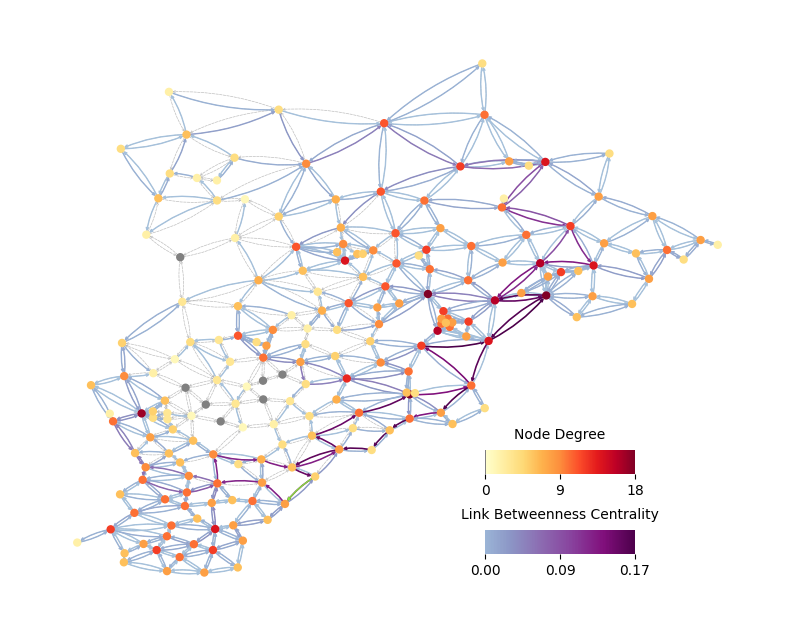

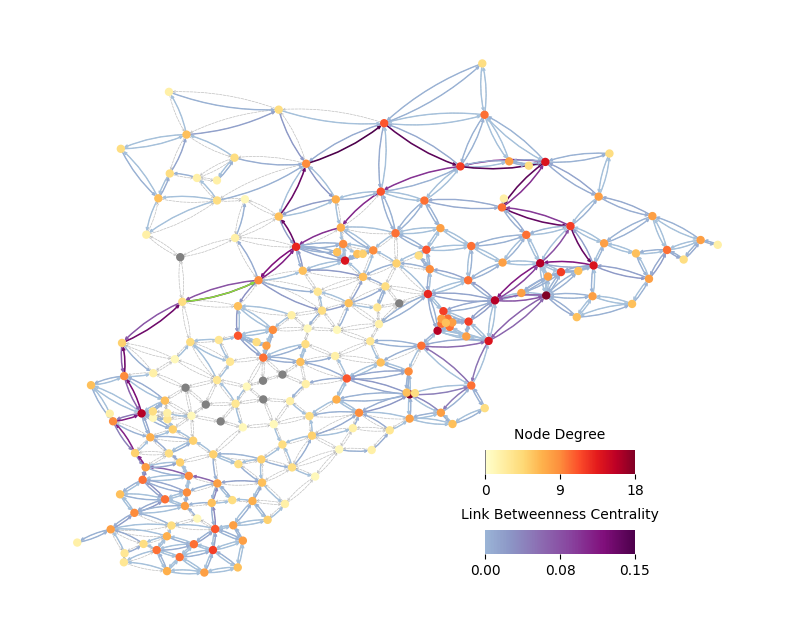

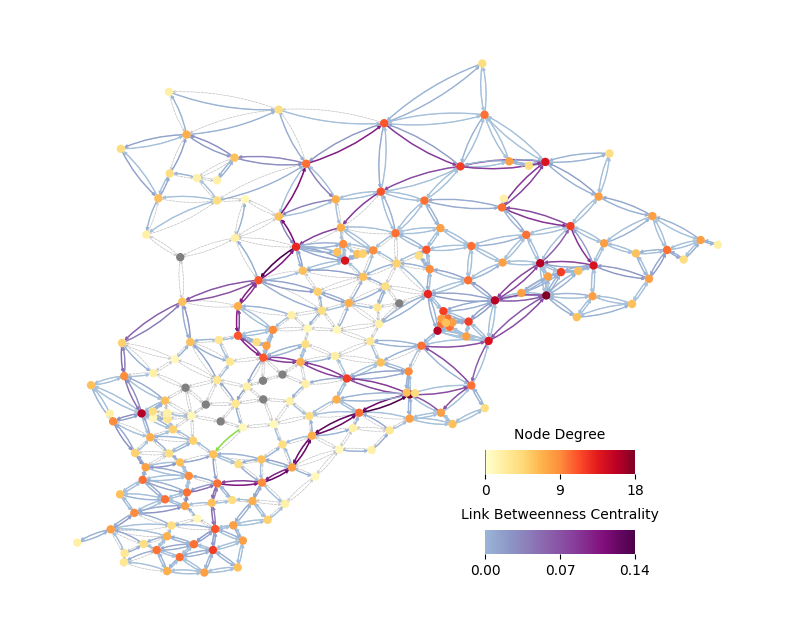

In [159]:
cascading_link_w_222= results_cascading_w.iloc[222]['removal']
plot_two_layered_graphs_between_w(Di_graph,graph_cascading_w_point_f_222,cascading_link_w_222)
cascading_link_w_r_12 = results_cascading_w.iloc[12+len(edges_removed_cascadin_dir)]['removal']
plot_two_layered_graphs_between_w(Di_graph,graph_cascading_w_point_r_12,cascading_link_w_r_12)
cascading_link_w_r_142 = results_cascading_w.iloc[142+len(edges_removed_cascadin_dir)]['removal']
plot_two_layered_graphs_between_w(Di_graph,graph_cascading_w_point_r_142,cascading_link_w_r_142)

In [170]:
cf_links_w = [cascading_link_w_222,cascading_link_w_r_142,cascading_link_w_r_12]

## Resilience index

In [232]:
ri_gcc_random_w = calculate_mean_resilience_index(all_results_w, 99,gcc_init, metric='gcc')
ri_eff_random_w = calculate_mean_resilience_index(all_results_w, 99,ge_init, metric='efficiency')
ri_gcc_between_w = calculate_resilience_index_gcc(results_between_w,99,gcc_init)
ri_eff_between_w = calculate_resilience_index_eff(results_between_w,99,ge_init)
ri_gcc_cascading_w = calculate_resilience_index_gcc(results_cascading_w,99,gcc_init)
ri_eff_cascading_w = calculate_resilience_index_eff(results_cascading_w,99,ge_init)

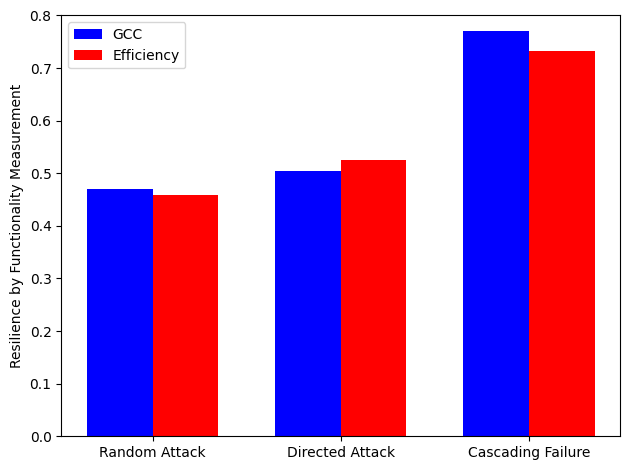

In [233]:
labels = ['Random Attack', 'Directed Attack', 'Cascading Failure']
gcc_values_w = [ri_gcc_random_w, ri_gcc_between_w, ri_gcc_cascading_w]
eff_values_w = [ri_eff_random_w, ri_eff_between_w, ri_eff_cascading_w]

x = np.arange(len(labels))  # label locations
width = 0.35  # width of the bars

fig, ax = plt.subplots()

rects1 = ax.bar(x - width/2, gcc_values_w, width, label='GCC', color='blue')
rects2 = ax.bar(x + width/2, eff_values_w, width, label='Efficiency', color='red')

# Add some text for labels, title, and custom x-axis tick labels, etc.
#ax.set_xlabel('Method')
ax.set_ylabel('Resilience by Functionality Measurement')
#ax.set_title('Resilience Index by Method and Measure')
ax.set_ylim(top=0.8,bottom=0)
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend()

fig.tight_layout()
plt.show()


In [282]:
def plot_graph_w(original_graph,da_links_w,cf_links_w, filename=None):
    fig, ax = plt.subplots(figsize=(10, 8))
    ax.set_facecolor('white')
    ax.axis('off')
    fig.patch.set_alpha(0.0)
    ax.patch.set_alpha(0.0)

    # Using predefined positions based on 'coords'
    pos = nx.get_node_attributes(original_graph, 'coords')
    
    # Node plotting based on degree
    degrees = [d for n, d in original_graph.degree()]
    colors = [(0.5, 0.5, 0.5)] + [plt.cm.YlOrRd(i) for i in np.linspace(0, 1, 255)]
    custom_colormap = mcolors.LinearSegmentedColormap.from_list("custom", colors, N=256)
    norm = plt.Normalize(vmin=0, vmax=max(degrees))
    node_colors_rgb = [custom_colormap(norm(d)) for d in degrees]
    nx.draw_networkx_nodes(original_graph, pos, node_size=25, node_color=node_colors_rgb, cmap=plt.cm.YlOrRd)
    
    # Draw the original graph's edges with the same style as other edges beneath
    nx.draw_networkx_edges(original_graph, pos, edge_color='grey', style='dashed', width=0.5, connectionstyle="arc3,rad=0.1", alpha=0.5, arrows=True, arrowstyle="->", node_size=25, arrowsize=4 )
    
    # Edges plotting
    edge_betweenness = nx.edge_betweenness_centrality(original_graph)
    
    start = 0.4  # Start from the midpoint of BuPu
    stop = 1.0  # End at the darkest color
    colors = plt.cm.BuPu(np.linspace(start, stop, 256))
    custom_BuPu = mcolors.LinearSegmentedColormap.from_list('custom_BuPu', colors)

    start_color_of_custom_BuPu = plt.cm.BuPu(0.35)
    # Determine the threshold for high betweenness centrality
    high_betweenness_threshold = np.percentile(list(edge_betweenness.values()), 50)
    high_betweenness_edges = [edge for edge, value in edge_betweenness.items() if value >= high_betweenness_threshold]
    other_edges = [edge for edge in original_graph.edges() if edge not in high_betweenness_edges]

    nx.draw_networkx_edges(original_graph, pos, edgelist=other_edges, edge_color=start_color_of_custom_BuPu, width=1, connectionstyle="arc3,rad=0.1", arrows=True, arrowstyle="->", node_size=25,  arrowsize=4)
    
    # Plot high betweenness edges with varying colors and widths
    edge_colors = [edge_betweenness[edge] for edge in high_betweenness_edges]
    edge_widths = [1 + edge_betweenness[edge] for edge in high_betweenness_edges]  # adjust factor as needed

    
    nx.draw_networkx_edges(original_graph, pos, edgelist=high_betweenness_edges, edge_color=edge_colors, width=edge_widths, edge_cmap=custom_BuPu, connectionstyle="arc3,rad=0.1", arrows=True, arrowstyle="->", node_size=25, arrowsize=4 )

    # Highlight the specific edge
        # Highlight the DA edges
    for da_link in da_links_w:
        nx.draw_networkx_edges(original_graph, pos, arrows=True, edgelist=[tuple(da_link)], edge_color='#00EEEE', width=edge_widths, arrowstyle="->", connectionstyle="arc3,rad=0.1", node_size=25, arrowsize=4 )

    # Highlight the CF edges
    for cf_link in cf_links_w:
        nx.draw_networkx_edges(original_graph, pos, arrows=True, edgelist=[tuple(cf_link)], edge_color='#d425e9', width=edge_widths, arrowstyle="->", connectionstyle="arc3,rad=0.1", node_size=25, arrowsize=4 )

    
     # Add colorbar for edges
    # Create new axes for colorbar
    cax = fig.add_axes([0.6, 0.2, 0.15, 0.03])
    edge_colorbar = plt.colorbar(plt.cm.ScalarMappable(cmap=custom_BuPu, 
                            norm=plt.Normalize(vmin=min(edge_colors), vmax=max(edge_colors))), cax=cax, orientation='horizontal')

    # Set tick labels to start, middle, end with two-digit decimals
    min_val, max_val = min(edge_colors), max(edge_colors)
    middle_val = (min_val + max_val) / 2
    edge_colorbar.set_ticks([min_val, middle_val, max_val])
    edge_colorbar.set_ticklabels([f"{min_val:.2f}", f"{middle_val:.2f}", f"{max_val:.2f}"])
    edge_colorbar.outline.set_edgecolor('none')
    edge_colorbar.set_label('Link Betweenness Centrality',labelpad = -50)
   
    # Create new axes for node colorbar
    cax_nodes = fig.add_axes([0.6, 0.3, 0.15, 0.03])
    node_colorbar = plt.colorbar(plt.cm.ScalarMappable(cmap=custom_colormap, 
                            norm=norm), cax=cax_nodes, orientation='horizontal')

    # Set tick labels to start, middle, end
    min_degree, max_degree = 0, max(degrees)
    middle_degree = max_degree // 2
    node_colorbar.set_ticks([min_degree, middle_degree, max_degree])
    node_colorbar.set_ticklabels([min_degree, middle_degree, max_degree])
    node_colorbar.outline.set_edgecolor('none')
    node_colorbar.set_label('Node Degree', labelpad=-50)
    
    # Save the plot
    if filename:
        plt.savefig(f'{filename}.png', dpi=400, bbox_inches='tight', pad_inches=0.1, transparent=True)
    #if variable_name:
    #    plt.savefig(f'plots/{variable_name}.png',dpi=400 ,bbox_inches='tight', pad_inches=0.1, transparent=False)

    plt.show()


/Users/liaoyuhan/opt/anaconda3/envs/urbsim/lib/python3.10/site-packages/networkx/drawing/nx_pylab.py:433: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(


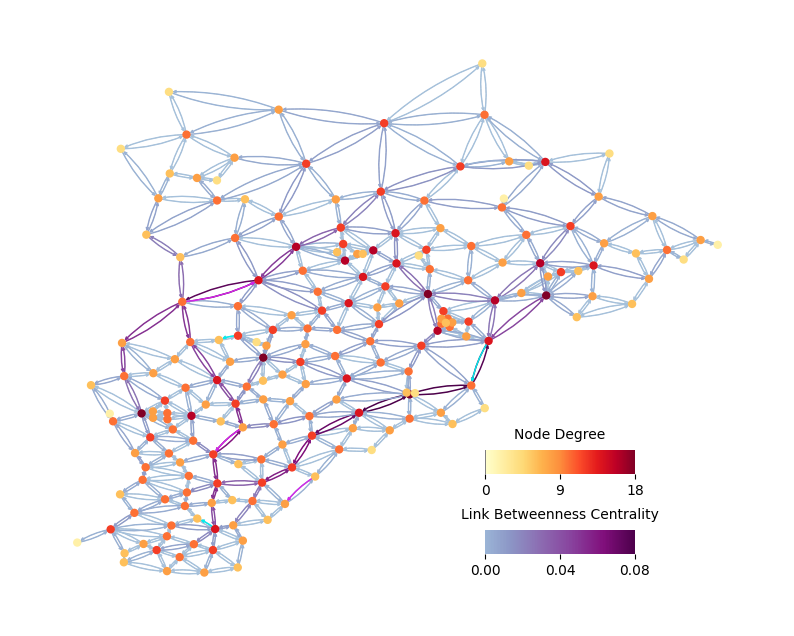

In [283]:
plot_graph_w(Di_graph,da_links_w,cf_links_w,'unweighted')

In [270]:
def create_centrality_table_w(graph, da_links, cf_links):
    """
    Create a table with node degrees and edge betweenness centrality for given links.

    Parameters:
    - graph: A networkx graph.
    - da_links: List of DA links.
    - cf_links: List of CF links.

    Returns:
    - DataFrame: A pandas DataFrame containing the link vertex1, degree1, link vertex2, degree2, and betweenness centrality.
    """
    
    # Calculate betweenness centrality for edges
    edge_betweenness = nx.edge_betweenness_centrality(graph,normalized=False,weight='flow')

    # Calculate degrees for nodes
    #all_degrees = nx.degree_centrality(graph)
    all_degrees = dict(graph.degree())

    # Combine da_links and cf_links
    combined_links = da_links + cf_links

    # Extract relevant data
    data = []
    for edge in combined_links:
        vertex1, vertex2 = tuple(edge)  # Convert the edge (which might be a numpy array) to a tuple
        degree1 = all_degrees.get(vertex1, 0) # get degree or return 0 if not found
        degree2 = all_degrees.get(vertex2, 0) # get degree or return 0 if not found
        betweenness = edge_betweenness.get((vertex1, vertex2), 0) # get betweenness or return 0 if not found
        data.append([vertex1, degree1, vertex2, degree2, betweenness])

    # Create the DataFrame
    df = pd.DataFrame(data, columns=['Link Vertex1', 'Degree1', 'Link Vertex2', 'Degree2', 'Betweenness Centrality'])

    return df



In [279]:
flows = []

for u, v, data in Di_graph.edges(data=True):
    flow_value = data.get('distance', None)  # Retrieves the flow value, defaults to None if not found.
    flows.append((u, v, flow_value))


In [271]:
create_centrality_table_w(Di_graph, da_links_w, cf_links_w)

,Link Vertex1,Degree1,Link Vertex2,Degree2,Betweenness Centrality
0,曲周县_130435,14,鸡泽县_130431,6,69.0
1,满城区_130607,12,顺平县_130636,6,61.0
2,滨海新区_120116,14,黄骅市_130983,10,2780.0
3,故城县_131126,6,清河县_130534,8,4.0
4,辛集市_130181,8,宁晋县_130528,12,203.0
5,涞源县_130630,10,涞水县_130623,14,4881.0
